In [1]:
%pip install pandas
%pip install scikit-learn
%pip install matplotlib

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import torch

metadata_df = pd.read_csv("./data/sort.csv")
image_tensor = torch.load("./data/loaded_images_tensor.pt")

assert len(metadata_df) == image_tensor.size(0), "数据大小不匹配"
# image_tensor.shape

/tmp/ipykernel_98/338700035.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  image_tensor = torch.load("./data/loaded_images_tensor.pt")


In [3]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split

scaler = StandardScaler()
metadata_df[['age_approx', 'clin_size_long_diam_mm']] = scaler.fit_transform(metadata_df[['age_approx', 'clin_size_long_diam_mm']])
# print(metadata_df)

eva_data = metadata_df.drop(columns = ['id', 'isic_id'])

# X_metadata =  metadata_df.drop(columns = ['is_melanoma','isic_id'])
X_metadata =  metadata_df
y = metadata_df['is_melanoma']

X_train_meta_V, X_test_meta_V, y_train, y_test = train_test_split(X_metadata, y, test_size=0.2, random_state=42)

X_train_meta = X_train_meta_V.drop(columns = ['is_melanoma','isic_id'])
X_test_meta = X_test_meta_V.drop(columns = ['is_melanoma','isic_id'])

image_ids = X_train_meta['id'].values
X_train_meta_tensor = image_tensor[image_ids]
X_train_meta =  X_train_meta.drop(columns = ['id'])

image_ids_test = X_test_meta['id'].values
X_test_meta_tensor = image_tensor[image_ids_test]
X_test_meta =  X_test_meta.drop(columns = ['id'])
# X_train_meta_tensor.shape

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
# X_train_meta_tensor

In [5]:
print(X_train_meta_tensor.shape) 
print(y_train.shape)
y_train = torch.tensor(y_train.values)
y_test = torch.tensor(y_test.values)
# X_train_meta_tensor
# y_train

torch.Size([3779, 3, 224, 224])
(3779,)


In [6]:

train_dataset = TensorDataset(X_train_meta_tensor, y_train)
test_dataset = TensorDataset(X_test_meta_tensor, y_test)

In [7]:
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CommonBlock(nn.Module):
    def __init__(self, in_channel, out_channel, stride):        # 普通Block简单完成两次卷积操作
        super(CommonBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channel)
        self.conv2 = nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channel)

    def forward(self, x):
        identity = x                                            # 普通Block的shortcut为直连，不需要升维下采样

        x = F.relu(self.bn1(self.conv1(x)), inplace=True)       # 完成一次卷积
        x = self.bn2(self.conv2(x))                             # 第二次卷积不加relu激活函数

        x += identity                                           # 两路相加
        return F.relu(x, inplace=True)                          # 添加激活函数输出


class SpecialBlock(nn.Module):                                  # 特殊Block完成两次卷积操作，以及一次升维下采样
    def __init__(self, in_channel, out_channel, stride):        # 注意这里的stride传入一个数组，shortcut和残差部分stride不同
        super(SpecialBlock, self).__init__()
        self.change_channel = nn.Sequential(                    # 负责升维下采样的卷积网络change_channel
            nn.Conv2d(in_channel, out_channel, kernel_size=1, stride=stride[0], padding=0, bias=False),
            nn.BatchNorm2d(out_channel)
        )
        self.conv1 = nn.Conv2d(in_channel, out_channel, kernel_size=3, stride=stride[0], padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channel)
        self.conv2 = nn.Conv2d(out_channel, out_channel, kernel_size=3, stride=stride[1], padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channel)

    def forward(self, x):
        identity = self.change_channel(x)                       # 调用change_channel对输入修改，为后面相加做变换准备

        x = F.relu(self.bn1(self.conv1(x)), inplace=True)
        x = self.bn2(self.conv2(x))                             # 完成残差部分的卷积

        x += identity
        return F.relu(x, inplace=True)                          # 输出卷积单元


class ResNet18(nn.Module):
    def __init__(self, classes_num):
        super(ResNet18, self).__init__()
        self.prepare = nn.Sequential(           # 所有的ResNet共有的预处理==》[batch, 64, 56, 56]
            nn.Conv2d(3, 64, 7, 2, 3),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(3, 2, 1)
        )
        self.layer1 = nn.Sequential(            # layer1有点特别，由于输入输出的channel均是64，故两个CommonBlock
            CommonBlock(64, 64, 1),
            CommonBlock(64, 64, 1)
        )
        self.layer2 = nn.Sequential(            # layer234类似，由于输入输出的channel不同，故一个SpecialBlock，一个CommonBlock
            SpecialBlock(64, 128, [2, 1]),
            CommonBlock(128, 128, 1)
        )
        self.layer3 = nn.Sequential(
            SpecialBlock(128, 256, [2, 1]),
            CommonBlock(256, 256, 1)
        )
        self.layer4 = nn.Sequential(
            SpecialBlock(256, 512, [2, 1]),
            CommonBlock(512, 512, 1)
        )
        self.pool = nn.AdaptiveAvgPool2d(output_size=(1, 1))    # 卷积结束，通过一个自适应均值池化==》 [batch, 512, 1, 1]
        self.fc = nn.Sequential(                # 最后用于分类的全连接层，根据需要灵活变化
            nn.Dropout(p=0.5),
            nn.Linear(512, 256),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.5),
            nn.Linear(256, classes_num)         # 这个使用CIFAR10数据集，定为10分类
        )

    def forward(self, x):
        x = self.prepare(x)         # 预处理

        x = self.layer1(x)          # 四个卷积单元
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.pool(x)            # 池化
        x = x.reshape(x.shape[0], -1)   # 将x展平，输入全连接层
        x = self.fc(x)

        return x



In [9]:
# model = ResNet18()
# criterion = nn.BCELoss()  # 二分类交叉熵损失
# optimizer = optim.Adam(model.parameters(), lr=0.001)

In [10]:
import torch.nn.functional as F
import os
import torch.nn as nn
import torch.optim as optim
from visdom import Visdom
viz = Visdom()

BATCH_SIZE = 512                        # 超参数batch大小
EPOCH = 30                            # 总共训练轮数
save_path = "./ResNet18_U.pth"    # 模型权重参数保存位置
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 

# 初始化数组来存储每一轮的train_loss
train_losses = []

def evalute(model, loader):
    correct = 0
    total = len(loader.dataset)
    for x, y in loader:
        x, y = x.to(device), y.to(device)
        model.eval()
        with torch.no_grad():
            out = model(x)
            prediction = out.argmax(dim=1)
        correct += torch.eq(prediction, y).float().sum().item()
    return correct / total

# 假设 ResNet18 已经定义
net = ResNet18(classes_num=1)
net.to(device)  
if not os.path.exists(save_path):
    torch.save(net.state_dict(), save_path)  
    print(f"Saved initial weights to {save_path}")
net.load_state_dict(torch.load(save_path))  

optimizer = optim.Adam(net.parameters(), lr=0.001)  
loss_function = nn.BCEWithLogitsLoss()  # 使用二分类损失函数

best_acc, best_epoch = 0.0, 0
global_step = 0  

for epoch in range(EPOCH):      
    running_loss = 0.0
    net.train()  
    
    for step, (images, labels) in enumerate(train_loader, start=0):
        images, labels = images.to(device), labels.to(device)
        labels = labels.view(-1, 1)
        labels = labels.float() 
        optimizer.zero_grad()
        outputs = net(images)
        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()  
        rate = (step + 1) / len(train_loader)
        a = "*" * int(rate * 50)
        b = "." * int((1 - rate) * 50)
        print("\repoch: {} train loss: {:^3.0f}%[{}->{}]{:.3f}".format(epoch+1, int(rate * 100), a, b, loss), end="")
        
        # 每次记录loss
        viz.line([loss.item()], [global_step], win='loss', update='append')
        global_step += 1

    # 将每一轮的loss记录到train_losses数组中
    avg_train_loss = running_loss / len(train_loader)
    train_losses.append(avg_train_loss)

    # 在每一个epoch结束，做一次test
    if epoch % 1 == 0:
        test_acc = evalute(net, test_loader)
        print("  epoch{} test acc:{}".format(epoch+1, test_acc))
        
        if test_acc > best_acc:
            best_acc = test_acc
            best_epoch = epoch
            torch.save(net.state_dict(), save_path)
            viz.line([test_acc], [global_step], win='test_acc', update='append')

print("Finish !")


Setting up a new session...
Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connec

Exception in user code:
------------------------------------------------------------


/tmp/ipykernel_98/3447208795.py:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net.load_state_dict(torch.load(save_path))


epoch: 1 train loss:  0 %[->.................................................]0.819Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  0 %[->.................................................]0.367Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  1 %[->.................................................]0.836Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  1 %[->.................................................]0.658Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  2 %[*->................................................]0.647Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  2 %[*->................................................]0.357Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  2 %[*->................................................]0.319Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  3 %[*->................................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  3 %[*->................................................]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  4 %[**->...............................................]0.563Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  4 %[**->...............................................]0.412Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  5 %[**->...............................................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  5 %[**->...............................................]0.494Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  5 %[**->...............................................]0.378Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  6 %[***->..............................................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  6 %[***->..............................................]0.551Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  7 %[***->..............................................]0.478Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  7 %[***->..............................................]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  8 %[****->.............................................]0.254Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  8 %[****->.............................................]0.276Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  8 %[****->.............................................]0.877Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss:  9 %[****->.............................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 1 train loss:  9 %[****->.............................................]0.560Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 10 %[*****->............................................]0.651Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 10 %[*****->............................................]0.683Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 10 %[*****->............................................]0.687Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 11 %[*****->............................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 11 %[*****->............................................]0.677Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 12 %[******->...........................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 12 %[******->...........................................]0.657

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 13 %[******->...........................................]0.328Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 13 %[******->...........................................]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 13 %[******->...........................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 14 %[*******->..........................................]0.521Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 14 %[*******->..........................................]0.516Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 15 %[*******->..........................................]0.445

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 15 %[*******->..........................................]0.448Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 16 %[********->.........................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 16 %[********->.........................................]0.741Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 16 %[********->.........................................]0.514Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 17 %[********->.........................................]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 17 %[********->.........................................]0.469Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 18 %[*********->........................................]0.814Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 18 %[*********->........................................]0.213Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 18 %[*********->........................................]0.604Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 19 %[*********->........................................]0.473Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 19 %[*********->........................................]0.355Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 20 %[**********->.......................................]0.359Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 20 %[**********->.......................................]0.306Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 21 %[**********->.......................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 21 %[**********->.......................................]0.569Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 21 %[**********->.......................................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 22 %[***********->......................................]0.739Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 22 %[***********->......................................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 23 %[***********->......................................]0.263Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 23 %[***********->......................................]0.298Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 24 %[************->.....................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 24 %[************->.....................................]0.309Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 24 %[************->.....................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 25 %[************->.....................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 25 %[************->.....................................]0.402Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 26 %[*************->....................................]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 26 %[*************->....................................]0.776Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 27 %[*************->....................................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 27 %[*************->....................................]0.616Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 27 %[*************->....................................]0.703Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 28 %[**************->...................................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 28 %[**************->...................................]0.460Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 29 %[**************->...................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 29 %[**************->...................................]0.658Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 29 %[**************->...................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 30 %[***************->..................................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 30 %[***************->..................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 31 %[***************->..................................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 31 %[***************->..................................]0.583Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 32 %[****************->.................................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 32 %[****************->.................................]0.648Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 32 %[****************->.................................]0.581Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 33 %[****************->.................................]0.828Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 33 %[****************->.................................]0.563Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 34 %[*****************->................................]0.521Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 34 %[*****************->................................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 35 %[*****************->................................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 35 %[*****************->................................]0.628Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 35 %[*****************->................................]0.571

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 36 %[******************->...............................]0.490Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 36 %[******************->...............................]0.492Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 37 %[******************->...............................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 37 %[******************->...............................]0.273Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 37 %[******************->...............................]0.309Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 38 %[*******************->..............................]0.296Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 38 %[*******************->..............................]0.379Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 39 %[*******************->..............................]0.191Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 39 %[*******************->..............................]0.501Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 40 %[********************->.............................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 40 %[********************->.............................]0.502Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 40 %[********************->.............................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 41 %[********************->.............................]0.393Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 41 %[********************->.............................]0.489Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 42 %[*********************->............................]0.231Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 42 %[*********************->............................]0.482Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 43 %[*********************->............................]0.486Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 43 %[*********************->............................]0.654Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 43 %[*********************->............................]0.696Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 44 %[**********************->...........................]0.323Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 44 %[**********************->...........................]0.699Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 45 %[**********************->...........................]0.206Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 45 %[**********************->...........................]0.489Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 45 %[**********************->...........................]0.266

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 46 %[***********************->..........................]0.652Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 46 %[***********************->..........................]0.364Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 47 %[***********************->..........................]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 47 %[***********************->..........................]0.564Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 48 %[************************->.........................]0.551Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 48 %[************************->.........................]0.617Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 48 %[************************->.........................]0.526Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 49 %[************************->.........................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 49 %[************************->.........................]0.711Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 50 %[*************************->........................]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 50 %[*************************->........................]0.393Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 51 %[*************************->........................]0.258Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 51 %[*************************->........................]0.264Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 51 %[*************************->........................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 52 %[**************************->.......................]0.752Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 52 %[**************************->.......................]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 53 %[**************************->.......................]0.599Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 53 %[**************************->.......................]0.575Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 54 %[***************************->......................]0.183Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 54 %[***************************->......................]0.693Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 54 %[***************************->......................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 55 %[***************************->......................]0.315Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 55 %[***************************->......................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 56 %[****************************->.....................]0.438Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 56 %[****************************->.....................]0.559Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 56 %[****************************->.....................]0.593Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 57 %[****************************->.....................]0.545Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 57 %[****************************->.....................]0.502Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 58 %[*****************************->....................]0.382Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 58 %[*****************************->....................]0.381Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 59 %[*****************************->....................]0.616Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 59 %[*****************************->....................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 59 %[*****************************->....................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 60 %[******************************->...................]0.825Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 60 %[******************************->...................]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 61 %[******************************->...................]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 61 %[******************************->...................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 62 %[*******************************->..................]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 62 %[*******************************->..................]0.474Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 62 %[*******************************->..................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 63 %[*******************************->..................]0.481Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 63 %[*******************************->..................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 64 %[********************************->.................]0.374Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 64 %[********************************->.................]0.436Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 64 %[********************************->.................]0.507Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 65 %[********************************->.................]0.396Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 65 %[********************************->.................]0.218Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 66 %[*********************************->................]0.506Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 66 %[*********************************->................]0.243Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 67 %[*********************************->................]0.616Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 67 %[*********************************->................]1.108Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 67 %[*********************************->................]0.356Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 68 %[**********************************->...............]0.383Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 68 %[**********************************->...............]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 69 %[**********************************->...............]0.479Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 69 %[**********************************->...............]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 70 %[***********************************->..............]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 70 %[***********************************->..............]0.479Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 70 %[***********************************->..............]0.893Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 71 %[***********************************->..............]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 71 %[***********************************->..............]0.278Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 72 %[************************************->.............]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 72 %[************************************->.............]0.461Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 72 %[************************************->.............]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 73 %[************************************->.............]0.601Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 73 %[************************************->.............]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 74 %[*************************************->............]0.384Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 74 %[*************************************->............]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 75 %[*************************************->............]0.571Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 75 %[*************************************->............]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 75 %[*************************************->............]0.624Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 76 %[**************************************->...........]0.624Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 76 %[**************************************->...........]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 77 %[**************************************->...........]0.376Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 77 %[**************************************->...........]0.580Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 78 %[***************************************->..........]0.664Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 78 %[***************************************->..........]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 78 %[***************************************->..........]0.319Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 79 %[***************************************->..........]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 79 %[***************************************->..........]0.346Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 80 %[****************************************->.........]0.768Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 80 %[****************************************->.........]0.303Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 81 %[****************************************->.........]0.429Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 81 %[****************************************->.........]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 81 %[****************************************->.........]0.448Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 82 %[*****************************************->........]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 82 %[*****************************************->........]0.475Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 83 %[*****************************************->........]0.637Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 83 %[*****************************************->........]0.585Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 83 %[*****************************************->........]0.860Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 84 %[******************************************->.......]0.408Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 84 %[******************************************->.......]0.389Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 85 %[******************************************->.......]0.457Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 85 %[******************************************->.......]0.411

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 86 %[*******************************************->......]0.503Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 86 %[*******************************************->......]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 86 %[*******************************************->......]0.388Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 87 %[*******************************************->......]0.511Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 87 %[*******************************************->......]0.466Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 88 %[********************************************->.....]0.674Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 88 %[********************************************->.....]0.486Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 89 %[********************************************->.....]0.302Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 89 %[********************************************->.....]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 89 %[********************************************->.....]0.537Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 90 %[*********************************************->....]0.338Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 90 %[*********************************************->....]0.365Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 91 %[*********************************************->....]0.325Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 91 %[*********************************************->....]0.713Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 91 %[*********************************************->....]0.212Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 92 %[**********************************************->...]0.298Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 92 %[**********************************************->...]0.622Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 93 %[**********************************************->...]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 93 %[**********************************************->...]0.414Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 94 %[***********************************************->..]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 94 %[***********************************************->..]0.358Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 94 %[***********************************************->..]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 95 %[***********************************************->..]0.330Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 95 %[***********************************************->..]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 96 %[************************************************->.]0.547Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 96 %[************************************************->.]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 97 %[************************************************->.]0.478Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 97 %[************************************************->.]0.688Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 97 %[************************************************->.]0.563

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 98 %[*************************************************->]0.587Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 98 %[*************************************************->]0.496Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 99 %[*************************************************->]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 1 train loss: 99 %[*************************************************->]0.335Exception in user code:
------------------------------------------------------------
epoch: 1 train loss: 100%[**************************************************->]0.893Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch1 test acc:0.8497354497354498
Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  0 %[->.................................................]0.561Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  0 %[->.................................................]0.541Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  1 %[->.................................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  1 %[->.................................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  2 %[*->................................................]0.313Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  2 %[*->................................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  2 %[*->................................................]0.454Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  3 %[*->................................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  3 %[*->................................................]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  4 %[**->...............................................]0.565Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  4 %[**->...............................................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  5 %[**->...............................................]0.219Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  5 %[**->...............................................]0.265Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  5 %[**->...............................................]0.703Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  6 %[***->..............................................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  6 %[***->..............................................]0.171Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  7 %[***->..............................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  7 %[***->..............................................]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  8 %[****->.............................................]0.626Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  8 %[****->.............................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  8 %[****->.............................................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss:  9 %[****->.............................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 2 train loss:  9 %[****->.............................................]0.437Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 10 %[*****->............................................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 10 %[*****->............................................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 10 %[*****->............................................]0.502Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 11 %[*****->............................................]0.240Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 11 %[*****->............................................]0.603Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 12 %[******->...........................................]0.662Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 12 %[******->...........................................]0.481Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 13 %[******->...........................................]0.454Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 13 %[******->...........................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 13 %[******->...........................................]0.385Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 14 %[*******->..........................................]0.421Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 14 %[*******->..........................................]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 15 %[*******->..........................................]0.318Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 15 %[*******->..........................................]0.924Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 16 %[********->.........................................]0.285Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 16 %[********->.........................................]0.726Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 16 %[********->.........................................]0.298Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 17 %[********->.........................................]0.642Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 17 %[********->.........................................]0.287Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 18 %[*********->........................................]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 18 %[*********->........................................]0.418Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 18 %[*********->........................................]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 19 %[*********->........................................]0.643Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 19 %[*********->........................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 20 %[**********->.......................................]0.452Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 20 %[**********->.......................................]0.432Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 21 %[**********->.......................................]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 21 %[**********->.......................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 21 %[**********->.......................................]0.254Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 22 %[***********->......................................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 22 %[***********->......................................]0.797Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 23 %[***********->......................................]0.252Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 23 %[***********->......................................]0.675Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 24 %[************->.....................................]0.384Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 24 %[************->.....................................]0.399Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 24 %[************->.....................................]0.612Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 25 %[************->.....................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 25 %[************->.....................................]0.656Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 26 %[*************->....................................]0.568

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 26 %[*************->....................................]0.658Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 27 %[*************->....................................]0.514Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 27 %[*************->....................................]0.517Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 27 %[*************->....................................]0.766Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 28 %[**************->...................................]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 28 %[**************->...................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 29 %[**************->...................................]0.486Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 29 %[**************->...................................]0.437Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 29 %[**************->...................................]0.469Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 30 %[***************->..................................]0.836Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 30 %[***************->..................................]0.599Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 31 %[***************->..................................]0.275

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 31 %[***************->..................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 32 %[****************->.................................]0.731Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 32 %[****************->.................................]0.636Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 32 %[****************->.................................]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 33 %[****************->.................................]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 33 %[****************->.................................]0.781Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 34 %[*****************->................................]0.291Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 34 %[*****************->................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 35 %[*****************->................................]0.383Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 35 %[*****************->................................]0.241Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 35 %[*****************->................................]0.450Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 36 %[******************->...............................]0.605Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 36 %[******************->...............................]0.381Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 37 %[******************->...............................]0.339Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 37 %[******************->...............................]0.316Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 37 %[******************->...............................]0.275Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 38 %[*******************->..............................]0.785Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 38 %[*******************->..............................]0.742Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 39 %[*******************->..............................]0.280Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 39 %[*******************->..............................]0.489Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 40 %[********************->.............................]0.297Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 40 %[********************->.............................]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 40 %[********************->.............................]0.426Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 41 %[********************->.............................]0.511Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 41 %[********************->.............................]0.567Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 42 %[*********************->............................]0.339Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 42 %[*********************->............................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 43 %[*********************->............................]0.427Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 43 %[*********************->............................]0.399Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 43 %[*********************->............................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 44 %[**********************->...........................]0.793Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 44 %[**********************->...........................]0.725Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 45 %[**********************->...........................]0.637Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 45 %[**********************->...........................]0.624Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 45 %[**********************->...........................]0.780Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 46 %[***********************->..........................]0.738Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 46 %[***********************->..........................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 47 %[***********************->..........................]0.710Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 47 %[***********************->..........................]0.545Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 48 %[************************->.........................]0.571Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 48 %[************************->.........................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 48 %[************************->.........................]0.517Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 49 %[************************->.........................]0.536Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 49 %[************************->.........................]0.450Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 50 %[*************************->........................]0.388Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 50 %[*************************->........................]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 51 %[*************************->........................]0.505Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 51 %[*************************->........................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 51 %[*************************->........................]0.528Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 52 %[**************************->.......................]0.682Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 52 %[**************************->.......................]0.451Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 53 %[**************************->.......................]0.508Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 53 %[**************************->.......................]0.556Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 54 %[***************************->......................]0.356Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 54 %[***************************->......................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 54 %[***************************->......................]0.585Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 55 %[***************************->......................]0.608Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 55 %[***************************->......................]0.511Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 56 %[****************************->.....................]0.327Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 56 %[****************************->.....................]0.592Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 56 %[****************************->.....................]0.587

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 57 %[****************************->.....................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 57 %[****************************->.....................]0.271Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 58 %[*****************************->....................]0.471Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 58 %[*****************************->....................]0.644Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 59 %[*****************************->....................]0.315Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 59 %[*****************************->....................]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 59 %[*****************************->....................]0.379Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 60 %[******************************->...................]0.623Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 60 %[******************************->...................]0.231Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 61 %[******************************->...................]0.549

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 61 %[******************************->...................]0.463Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 62 %[*******************************->..................]0.287Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 62 %[*******************************->..................]0.771Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 62 %[*******************************->..................]0.643Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 63 %[*******************************->..................]0.374Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 63 %[*******************************->..................]0.564Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 64 %[********************************->.................]0.171Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 64 %[********************************->.................]0.660Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 64 %[********************************->.................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 65 %[********************************->.................]0.532Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 65 %[********************************->.................]0.173Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 66 %[*********************************->................]0.581Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 66 %[*********************************->................]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 67 %[*********************************->................]0.370Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 67 %[*********************************->................]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 67 %[*********************************->................]0.516Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 68 %[**********************************->...............]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 68 %[**********************************->...............]0.625Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 69 %[**********************************->...............]0.620Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 69 %[**********************************->...............]0.316Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 70 %[***********************************->..............]0.384Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 70 %[***********************************->..............]0.399

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 70 %[***********************************->..............]0.790Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 71 %[***********************************->..............]0.636Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 71 %[***********************************->..............]0.499Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 72 %[************************************->.............]0.522Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 72 %[************************************->.............]0.642Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 72 %[************************************->.............]0.371Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 73 %[************************************->.............]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 73 %[************************************->.............]0.589Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 74 %[*************************************->............]0.609Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 74 %[*************************************->............]0.460Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 75 %[*************************************->............]0.579Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 75 %[*************************************->............]0.431Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 75 %[*************************************->............]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 76 %[**************************************->...........]0.567Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 76 %[**************************************->...........]0.408Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 77 %[**************************************->...........]0.481Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 77 %[**************************************->...........]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 78 %[***************************************->..........]0.542Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 78 %[***************************************->..........]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 78 %[***************************************->..........]0.415Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 79 %[***************************************->..........]0.779Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 79 %[***************************************->..........]0.612Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 80 %[****************************************->.........]0.484Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 80 %[****************************************->.........]0.589Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 81 %[****************************************->.........]0.406Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 81 %[****************************************->.........]0.360Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 81 %[****************************************->.........]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 82 %[*****************************************->........]0.344Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 82 %[*****************************************->........]0.557Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 83 %[*****************************************->........]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 83 %[*****************************************->........]0.231Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 83 %[*****************************************->........]0.529Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 84 %[******************************************->.......]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 84 %[******************************************->.......]0.261Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 85 %[******************************************->.......]0.269Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 85 %[******************************************->.......]0.261Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 86 %[*******************************************->......]0.578Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 86 %[*******************************************->......]0.335Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 86 %[*******************************************->......]0.467Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 87 %[*******************************************->......]0.807Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 87 %[*******************************************->......]0.254Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 88 %[********************************************->.....]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 88 %[********************************************->.....]0.368Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 89 %[********************************************->.....]0.534Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 89 %[********************************************->.....]0.309Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 89 %[********************************************->.....]0.670Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 90 %[*********************************************->....]0.638Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 90 %[*********************************************->....]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 91 %[*********************************************->....]0.530Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 91 %[*********************************************->....]0.476Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 91 %[*********************************************->....]0.492

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 92 %[**********************************************->...]0.164Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 92 %[**********************************************->...]0.331Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 93 %[**********************************************->...]0.679Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 93 %[**********************************************->...]0.161Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 94 %[***********************************************->..]0.395Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 94 %[***********************************************->..]0.392Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 94 %[***********************************************->..]0.683Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 95 %[***********************************************->..]0.583Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 95 %[***********************************************->..]0.303Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 96 %[************************************************->.]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 96 %[************************************************->.]0.393Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 97 %[************************************************->.]0.368Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 97 %[************************************************->.]0.299Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 97 %[************************************************->.]0.317Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 98 %[*************************************************->]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 98 %[*************************************************->]0.385Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 99 %[*************************************************->]0.510Exception in user code:
------------------------------------------------------------
epoch: 2 train loss: 99 %[*************************************************->]0.239Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 2 train loss: 100%[**************************************************->]0.127Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch2 test acc:0.8497354497354498
epoch: 3 train loss:  0 %[->.................................................]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  0 %[->.................................................]0.648Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  1 %[->.................................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  1 %[->.................................................]0.563Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  2 %[*->................................................]0.497Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  2 %[*->................................................]0.524Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  2 %[*->................................................]0.863Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  3 %[*->................................................]0.410

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  3 %[*->................................................]0.435Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  4 %[**->...............................................]0.517Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  4 %[**->...............................................]0.668Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  5 %[**->...............................................]0.373Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  5 %[**->...............................................]0.395Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  5 %[**->...............................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  6 %[***->..............................................]0.217Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  6 %[***->..............................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  7 %[***->..............................................]0.329Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  7 %[***->..............................................]0.591Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss:  8 %[****->.............................................]0.644Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  8 %[****->.............................................]0.695Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  8 %[****->.............................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  9 %[****->.............................................]0.353

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss:  9 %[****->.............................................]0.717Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 10 %[*****->............................................]0.462Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 10 %[*****->............................................]0.324Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 10 %[*****->............................................]0.496Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 11 %[*****->............................................]0.477Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 11 %[*****->............................................]0.292Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 12 %[******->...........................................]0.282Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 12 %[******->...........................................]0.415Exception in user code:
-----------------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 13 %[******->...........................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 13 %[******->...........................................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 14 %[*******->..........................................]0.595Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 14 %[*******->..........................................]0.788Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 15 %[*******->..........................................]0.330Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 15 %[*******->..........................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 16 %[********->.........................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 16 %[********->.........................................]0.462Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 16 %[********->.........................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 17 %[********->.........................................]0.467Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 17 %[********->.........................................]0.516Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 18 %[*********->........................................]0.597Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 18 %[*********->........................................]0.666Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 18 %[*********->........................................]0.307Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 19 %[*********->........................................]0.411Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 19 %[*********->........................................]0.396Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 20 %[**********->.......................................]0.682Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 20 %[**********->.......................................]0.348Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 21 %[**********->.......................................]0.199Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 21 %[**********->.......................................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 21 %[**********->.......................................]0.209Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 22 %[***********->......................................]0.631Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 22 %[***********->......................................]0.489

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 23 %[***********->......................................]0.380Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 23 %[***********->......................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 24 %[************->.....................................]0.526Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 24 %[************->.....................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 24 %[************->.....................................]0.553Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 25 %[************->.....................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 25 %[************->.....................................]0.264Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 26 %[*************->....................................]0.497Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 26 %[*************->....................................]0.419Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 27 %[*************->....................................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 27 %[*************->....................................]0.438Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 27 %[*************->....................................]0.280Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 28 %[**************->...................................]1.093Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 28 %[**************->...................................]0.992Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 29 %[**************->...................................]0.516Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 29 %[**************->...................................]0.593Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 29 %[**************->...................................]0.309Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 30 %[***************->..................................]0.700Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 30 %[***************->..................................]0.451Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 31 %[***************->..................................]0.613

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 31 %[***************->..................................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 32 %[****************->.................................]0.427Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 32 %[****************->.................................]0.425Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 32 %[****************->.................................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 33 %[****************->.................................]0.424Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 33 %[****************->.................................]0.566Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 34 %[*****************->................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 34 %[*****************->................................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 35 %[*****************->................................]0.503Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 35 %[*****************->................................]0.534Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 35 %[*****************->................................]0.596Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 36 %[******************->...............................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 36 %[******************->...............................]0.597Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 37 %[******************->...............................]0.506Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 37 %[******************->...............................]0.415Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 37 %[******************->...............................]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 38 %[*******************->..............................]0.481Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 38 %[*******************->..............................]0.591Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 39 %[*******************->..............................]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 39 %[*******************->..............................]0.533Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 40 %[********************->.............................]0.520Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 40 %[********************->.............................]0.239Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 40 %[********************->.............................]0.418Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 41 %[********************->.............................]0.335Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 41 %[********************->.............................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 42 %[*********************->............................]0.660Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 42 %[*********************->............................]0.603Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 43 %[*********************->............................]0.585Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 43 %[*********************->............................]0.270

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 43 %[*********************->............................]0.967Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 44 %[**********************->...........................]0.613Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 44 %[**********************->...........................]0.532Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 45 %[**********************->...........................]0.433Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 45 %[**********************->...........................]0.856Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 45 %[**********************->...........................]0.483Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 46 %[***********************->..........................]0.481Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 46 %[***********************->..........................]0.615Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 47 %[***********************->..........................]0.387Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 47 %[***********************->..........................]0.339Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 48 %[************************->.........................]0.531Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 48 %[************************->.........................]0.557Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 48 %[************************->.........................]0.351Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 49 %[************************->.........................]0.536Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 49 %[************************->.........................]0.661Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 50 %[*************************->........................]0.492Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 50 %[*************************->........................]0.554Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 51 %[*************************->........................]0.363Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 51 %[*************************->........................]0.463Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 51 %[*************************->........................]0.626Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 52 %[**************************->.......................]0.254Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 52 %[**************************->.......................]0.405Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 53 %[**************************->.......................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 53 %[**************************->.......................]0.467Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 54 %[***************************->......................]0.297Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 54 %[***************************->......................]0.542Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 54 %[***************************->......................]0.485Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 55 %[***************************->......................]0.470Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 55 %[***************************->......................]0.294Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 56 %[****************************->.....................]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 56 %[****************************->.....................]0.204Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 56 %[****************************->.....................]0.409Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 57 %[****************************->.....................]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 57 %[****************************->.....................]0.493Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 58 %[*****************************->....................]0.594Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 58 %[*****************************->....................]0.303Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 59 %[*****************************->....................]0.261Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 59 %[*****************************->....................]0.464Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 59 %[*****************************->....................]0.269Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 60 %[******************************->...................]0.506Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 60 %[******************************->...................]0.322Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 61 %[******************************->...................]0.623Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 61 %[******************************->...................]0.890Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 62 %[*******************************->..................]0.243Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 62 %[*******************************->..................]0.221Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 62 %[*******************************->..................]0.467Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 63 %[*******************************->..................]0.322Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 63 %[*******************************->..................]0.332Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 64 %[********************************->.................]0.400

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 64 %[********************************->.................]0.289Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 64 %[********************************->.................]0.630Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 65 %[********************************->.................]0.542Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 65 %[********************************->.................]0.410Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 66 %[*********************************->................]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 66 %[*********************************->................]0.223Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 67 %[*********************************->................]0.415Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 67 %[*********************************->................]0.471Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 67 %[*********************************->................]0.566Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 68 %[**********************************->...............]0.433Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 68 %[**********************************->...............]0.224Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 69 %[**********************************->...............]0.430Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 69 %[**********************************->...............]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 70 %[***********************************->..............]0.610Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 70 %[***********************************->..............]0.728Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 70 %[***********************************->..............]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 71 %[***********************************->..............]0.705Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 71 %[***********************************->..............]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 72 %[************************************->.............]0.561Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 72 %[************************************->.............]0.852Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 72 %[************************************->.............]0.610Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 73 %[************************************->.............]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 73 %[************************************->.............]0.714Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 74 %[*************************************->............]0.391Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 74 %[*************************************->............]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 75 %[*************************************->............]0.337Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 75 %[*************************************->............]0.389Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 75 %[*************************************->............]0.665Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 76 %[**************************************->...........]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 76 %[**************************************->...........]0.554Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 77 %[**************************************->...........]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 77 %[**************************************->...........]0.563Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 78 %[***************************************->..........]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 78 %[***************************************->..........]0.569Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 78 %[***************************************->..........]0.356Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 79 %[***************************************->..........]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 79 %[***************************************->..........]0.501Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 80 %[****************************************->.........]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 80 %[****************************************->.........]0.497Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 81 %[****************************************->.........]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 81 %[****************************************->.........]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 81 %[****************************************->.........]0.503Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 82 %[*****************************************->........]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 82 %[*****************************************->........]0.283Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 83 %[*****************************************->........]0.459Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 83 %[*****************************************->........]0.324Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 83 %[*****************************************->........]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 84 %[******************************************->.......]0.311Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 84 %[******************************************->.......]0.583Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 85 %[******************************************->.......]0.813Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 85 %[******************************************->.......]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 86 %[*******************************************->......]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 86 %[*******************************************->......]0.504Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 86 %[*******************************************->......]0.407Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 87 %[*******************************************->......]0.191

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 87 %[*******************************************->......]0.581Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 88 %[********************************************->.....]0.965Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 88 %[********************************************->.....]0.427Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 89 %[********************************************->.....]0.510

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 89 %[********************************************->.....]0.234Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 89 %[********************************************->.....]0.350Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 90 %[*********************************************->....]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 90 %[*********************************************->....]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 91 %[*********************************************->....]0.413Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 91 %[*********************************************->....]0.577Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 91 %[*********************************************->....]0.227Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 92 %[**********************************************->...]0.276Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 92 %[**********************************************->...]0.280Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 93 %[**********************************************->...]0.579Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 93 %[**********************************************->...]0.174Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 94 %[***********************************************->..]0.198Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 94 %[***********************************************->..]0.735Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 94 %[***********************************************->..]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 95 %[***********************************************->..]0.519Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 95 %[***********************************************->..]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 96 %[************************************************->.]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 96 %[************************************************->.]0.809Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 97 %[************************************************->.]0.561Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 97 %[************************************************->.]0.526Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 97 %[************************************************->.]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 98 %[*************************************************->]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 98 %[*************************************************->]0.608Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 99 %[*************************************************->]0.588Exception in user code:
------------------------------------------------------------
epoch: 3 train loss: 99 %[*************************************************->]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 3 train loss: 100%[**************************************************->]0.181Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch3 test acc:0.8497354497354498
epoch: 4 train loss:  0 %[->.................................................]0.509Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  0 %[->.................................................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  1 %[->.................................................]0.619Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  1 %[->.................................................]0.399Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  2 %[*->................................................]0.632Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  2 %[*->................................................]0.396

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  2 %[*->................................................]0.425Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  3 %[*->................................................]0.430Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  3 %[*->................................................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  4 %[**->...............................................]0.547Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  4 %[**->...............................................]0.627Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  5 %[**->...............................................]0.606Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  5 %[**->...............................................]0.435Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  5 %[**->...............................................]0.732Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  6 %[***->..............................................]0.417Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  6 %[***->..............................................]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  7 %[***->..............................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  7 %[***->..............................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  8 %[****->.............................................]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  8 %[****->.............................................]0.461Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  8 %[****->.............................................]0.211Exception in user code:
------------------------------------------------------------
epoch: 4 train loss:  9 %[****->.............................................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss:  9 %[****->.............................................]0.587Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 10 %[*****->............................................]0.833Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 10 %[*****->............................................]0.209Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 10 %[*****->............................................]0.250Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 11 %[*****->............................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 11 %[*****->............................................]0.933Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 12 %[******->...........................................]0.655Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 12 %[******->...........................................]0.578Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 13 %[******->...........................................]0.481Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 13 %[******->...........................................]0.696Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 13 %[******->...........................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 14 %[*******->..........................................]0.640Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 14 %[*******->..........................................]0.454Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 15 %[*******->..........................................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 15 %[*******->..........................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 16 %[********->.........................................]0.560Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 16 %[********->.........................................]0.635Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 16 %[********->.........................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 17 %[********->.........................................]0.277Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 17 %[********->.........................................]0.588Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 18 %[*********->........................................]0.410Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 18 %[*********->........................................]0.348Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 18 %[*********->........................................]0.516Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 19 %[*********->........................................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 19 %[*********->........................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 20 %[**********->.......................................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 20 %[**********->.......................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 21 %[**********->.......................................]0.416Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 21 %[**********->.......................................]0.914Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 21 %[**********->.......................................]0.212Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 22 %[***********->......................................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 22 %[***********->......................................]0.394Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 23 %[***********->......................................]0.197Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 23 %[***********->......................................]0.611Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 24 %[************->.....................................]0.275Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 24 %[************->.....................................]0.646Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 24 %[************->.....................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 25 %[************->.....................................]0.810Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 25 %[************->.....................................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 26 %[*************->....................................]0.777Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 26 %[*************->....................................]0.211Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 27 %[*************->....................................]0.307Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 27 %[*************->....................................]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 27 %[*************->....................................]0.699Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 28 %[**************->...................................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 28 %[**************->...................................]0.519Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 29 %[**************->...................................]0.624Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 29 %[**************->...................................]0.566Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 29 %[**************->...................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 30 %[***************->..................................]0.359Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 30 %[***************->..................................]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 31 %[***************->..................................]0.663Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 31 %[***************->..................................]0.632Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 32 %[****************->.................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 32 %[****************->.................................]0.526Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 32 %[****************->.................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 33 %[****************->.................................]0.682Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 33 %[****************->.................................]0.515Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 34 %[*****************->................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 34 %[*****************->................................]0.465Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 35 %[*****************->................................]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 35 %[*****************->................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 35 %[*****************->................................]0.342Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 36 %[******************->...............................]0.457Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 36 %[******************->...............................]0.408Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 37 %[******************->...............................]0.433Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 37 %[******************->...............................]0.581Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 37 %[******************->...............................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 38 %[*******************->..............................]0.634Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 38 %[*******************->..............................]0.498Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 39 %[*******************->..............................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 39 %[*******************->..............................]0.305Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 40 %[********************->.............................]0.461Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 40 %[********************->.............................]0.594Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 40 %[********************->.............................]0.216Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 41 %[********************->.............................]0.650Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 41 %[********************->.............................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 42 %[*********************->............................]0.383Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 42 %[*********************->............................]0.267Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 43 %[*********************->............................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 43 %[*********************->............................]0.368Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 43 %[*********************->............................]0.591Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 44 %[**********************->...........................]0.549Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 44 %[**********************->...........................]0.361Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 45 %[**********************->...........................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 45 %[**********************->...........................]0.955Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 45 %[**********************->...........................]0.529Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 46 %[***********************->..........................]0.387Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 46 %[***********************->..........................]0.441Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 47 %[***********************->..........................]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 47 %[***********************->..........................]0.208Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 48 %[************************->.........................]0.492Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 48 %[************************->.........................]0.389Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 48 %[************************->.........................]0.524Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 49 %[************************->.........................]0.424Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 49 %[************************->.........................]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 50 %[*************************->........................]0.481Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 50 %[*************************->........................]0.609Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 51 %[*************************->........................]0.653Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 51 %[*************************->........................]0.420Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 51 %[*************************->........................]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 52 %[**************************->.......................]0.704Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 52 %[**************************->.......................]0.679Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 53 %[**************************->.......................]0.664Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 53 %[**************************->.......................]0.523Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 54 %[***************************->......................]0.350Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 54 %[***************************->......................]0.600

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 54 %[***************************->......................]0.620Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 55 %[***************************->......................]0.348Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 55 %[***************************->......................]0.400Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 56 %[****************************->.....................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 56 %[****************************->.....................]0.448Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 56 %[****************************->.....................]0.449Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 57 %[****************************->.....................]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 57 %[****************************->.....................]0.441Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 58 %[*****************************->....................]0.302Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 58 %[*****************************->....................]0.334Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 59 %[*****************************->....................]0.350Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 59 %[*****************************->....................]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 59 %[*****************************->....................]0.694Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 60 %[******************************->...................]0.683Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 60 %[******************************->...................]0.528Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 61 %[******************************->...................]0.494Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 61 %[******************************->...................]0.413Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 62 %[*******************************->..................]0.367Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 62 %[*******************************->..................]0.600Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 62 %[*******************************->..................]0.454Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 63 %[*******************************->..................]0.709Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 63 %[*******************************->..................]0.461Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 64 %[********************************->.................]0.478Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 64 %[********************************->.................]0.582Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 64 %[********************************->.................]0.452Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 65 %[********************************->.................]0.561Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 65 %[********************************->.................]0.820Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 66 %[*********************************->................]0.914Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 66 %[*********************************->................]0.529Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 67 %[*********************************->................]0.403Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 67 %[*********************************->................]0.397

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 67 %[*********************************->................]0.492Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 68 %[**********************************->...............]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 68 %[**********************************->...............]0.256Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 69 %[**********************************->...............]0.522Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 69 %[**********************************->...............]0.418Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 70 %[***********************************->..............]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 70 %[***********************************->..............]0.455Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 70 %[***********************************->..............]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 71 %[***********************************->..............]0.491Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 71 %[***********************************->..............]0.478Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 72 %[************************************->.............]0.298Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 72 %[************************************->.............]0.343Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 72 %[************************************->.............]0.242Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 73 %[************************************->.............]0.344Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 73 %[************************************->.............]0.229Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 74 %[*************************************->............]0.450Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 74 %[*************************************->............]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 75 %[*************************************->............]0.444Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 75 %[*************************************->............]0.582Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 75 %[*************************************->............]0.404Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 76 %[**************************************->...........]0.526

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 76 %[**************************************->...........]0.524Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 77 %[**************************************->...........]0.353Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 77 %[**************************************->...........]0.970Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 78 %[***************************************->..........]0.275Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 78 %[***************************************->..........]0.535Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 78 %[***************************************->..........]0.756Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 79 %[***************************************->..........]0.614Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 79 %[***************************************->..........]0.396Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 80 %[****************************************->.........]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 80 %[****************************************->.........]0.460Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 81 %[****************************************->.........]0.353Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 81 %[****************************************->.........]0.272Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 81 %[****************************************->.........]0.378Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 82 %[*****************************************->........]0.455Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 82 %[*****************************************->........]0.593Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 83 %[*****************************************->........]0.380Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 83 %[*****************************************->........]0.859Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 83 %[*****************************************->........]0.247Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 84 %[******************************************->.......]0.316Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 84 %[******************************************->.......]0.626Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 85 %[******************************************->.......]0.328Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 85 %[******************************************->.......]0.425Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 86 %[*******************************************->......]0.563Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 86 %[*******************************************->......]0.383Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 86 %[*******************************************->......]0.613Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 87 %[*******************************************->......]0.452Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 87 %[*******************************************->......]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 88 %[********************************************->.....]0.616Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 88 %[********************************************->.....]0.370Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 89 %[********************************************->.....]0.375

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 89 %[********************************************->.....]0.536Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 89 %[********************************************->.....]0.263Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 90 %[*********************************************->....]0.310Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 90 %[*********************************************->....]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 91 %[*********************************************->....]0.593Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 91 %[*********************************************->....]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 91 %[*********************************************->....]0.274Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 92 %[**********************************************->...]0.468Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 92 %[**********************************************->...]0.658Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 93 %[**********************************************->...]0.505Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 93 %[**********************************************->...]0.780Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 94 %[***********************************************->..]0.456Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 94 %[***********************************************->..]0.588Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 94 %[***********************************************->..]0.659Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 95 %[***********************************************->..]0.539Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 95 %[***********************************************->..]0.205Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 96 %[************************************************->.]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 96 %[************************************************->.]0.324Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 97 %[************************************************->.]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 97 %[************************************************->.]0.403Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 97 %[************************************************->.]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 98 %[*************************************************->]0.340Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 98 %[*************************************************->]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 4 train loss: 99 %[*************************************************->]0.614Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 99 %[*************************************************->]0.423Exception in user code:
------------------------------------------------------------
epoch: 4 train loss: 100%[**************************************************->]0.741Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch4 test acc:0.8497354497354498
epoch: 5 train loss:  0 %[->.................................................]0.486Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  0 %[->.................................................]0.547Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  1 %[->.................................................]0.333Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  1 %[->.................................................]0.298Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  2 %[*->................................................]0.349Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  2 %[*->................................................]0.272Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  2 %[*->................................................]0.428Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  3 %[*->................................................]0.944Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  3 %[*->................................................]0.605Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  4 %[**->...............................................]0.774Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  4 %[**->...............................................]0.598

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  5 %[**->...............................................]0.365Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  5 %[**->...............................................]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  5 %[**->...............................................]0.474Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  6 %[***->..............................................]0.538Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  6 %[***->..............................................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  7 %[***->..............................................]0.243Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  7 %[***->..............................................]0.510Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  8 %[****->.............................................]0.408

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  8 %[****->.............................................]0.606Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss:  8 %[****->.............................................]0.433Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  9 %[****->.............................................]0.407Exception in user code:
------------------------------------------------------------
epoch: 5 train loss:  9 %[****->.............................................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 10 %[*****->............................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 10 %[*****->............................................]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 10 %[*****->............................................]0.306Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 11 %[*****->............................................]0.468Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 11 %[*****->............................................]0.640Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 12 %[******->...........................................]0.161Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 12 %[******->...........................................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 13 %[******->...........................................]0.478Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 13 %[******->...........................................]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 13 %[******->...........................................]0.600Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 14 %[*******->..........................................]1.078Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 14 %[*******->..........................................]0.326Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 15 %[*******->..........................................]0.187Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 15 %[*******->..........................................]0.427Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 16 %[********->.........................................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 16 %[********->.........................................]0.182Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 16 %[********->.........................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 17 %[********->.........................................]0.560Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 17 %[********->.........................................]0.611Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 18 %[*********->........................................]0.286Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 18 %[*********->........................................]0.636Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 18 %[*********->........................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 19 %[*********->........................................]0.615Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 19 %[*********->........................................]0.627Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 20 %[**********->.......................................]0.322Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 20 %[**********->.......................................]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 21 %[**********->.......................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 21 %[**********->.......................................]0.736Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 21 %[**********->.......................................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 22 %[***********->......................................]0.286Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 22 %[***********->......................................]0.597Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 23 %[***********->......................................]0.609Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 23 %[***********->......................................]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 24 %[************->.....................................]0.392Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 24 %[************->.....................................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 24 %[************->.....................................]0.322Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 25 %[************->.....................................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 25 %[************->.....................................]0.691Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 26 %[*************->....................................]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 26 %[*************->....................................]0.657Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 27 %[*************->....................................]0.302Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 27 %[*************->....................................]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 27 %[*************->....................................]0.381Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 28 %[**************->...................................]0.333Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 28 %[**************->...................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 29 %[**************->...................................]0.460Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 29 %[**************->...................................]0.650Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 29 %[**************->...................................]0.466Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 30 %[***************->..................................]0.524

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 30 %[***************->..................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 31 %[***************->..................................]0.589Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 31 %[***************->..................................]0.348Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 32 %[****************->.................................]0.909Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 32 %[****************->.................................]0.646Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 32 %[****************->.................................]0.424Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 33 %[****************->.................................]0.225Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 33 %[****************->.................................]0.349Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 34 %[*****************->................................]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 34 %[*****************->................................]0.590Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 35 %[*****************->................................]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 35 %[*****************->................................]0.556Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 35 %[*****************->................................]0.231Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 36 %[******************->...............................]0.586Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 36 %[******************->...............................]0.951Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 37 %[******************->...............................]0.311Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 37 %[******************->...............................]0.449Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 37 %[******************->...............................]0.493

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 38 %[*******************->..............................]0.300Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 38 %[*******************->..............................]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 39 %[*******************->..............................]0.244Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 39 %[*******************->..............................]0.697Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 40 %[********************->.............................]0.297Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 40 %[********************->.............................]0.421Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 40 %[********************->.............................]0.448Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 41 %[********************->.............................]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 41 %[********************->.............................]1.063Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 42 %[*********************->............................]0.190Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 42 %[*********************->............................]0.395Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 43 %[*********************->............................]0.575Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 43 %[*********************->............................]0.459Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 43 %[*********************->............................]0.821

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 44 %[**********************->...........................]0.559Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 44 %[**********************->...........................]0.353Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 45 %[**********************->...........................]0.565Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 45 %[**********************->...........................]0.529Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 45 %[**********************->...........................]0.291Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 46 %[***********************->..........................]0.598Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 46 %[***********************->..........................]0.291Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 47 %[***********************->..........................]0.362Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 47 %[***********************->..........................]0.541

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 48 %[************************->.........................]0.469Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 48 %[************************->.........................]0.425Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 48 %[************************->.........................]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 49 %[************************->.........................]0.532Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 49 %[************************->.........................]0.505Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 50 %[*************************->........................]0.407Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 50 %[*************************->........................]0.469Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 51 %[*************************->........................]0.356Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 51 %[*************************->........................]0.567Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 51 %[*************************->........................]0.444Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 52 %[**************************->.......................]0.256Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 52 %[**************************->.......................]0.385Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 53 %[**************************->.......................]0.533Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 53 %[**************************->.......................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 54 %[***************************->......................]0.410Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 54 %[***************************->......................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 54 %[***************************->......................]0.512Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 55 %[***************************->......................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 55 %[***************************->......................]0.365Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 56 %[****************************->.....................]0.699Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 56 %[****************************->.....................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 56 %[****************************->.....................]0.371Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 57 %[****************************->.....................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 57 %[****************************->.....................]0.257Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 58 %[*****************************->....................]0.750Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 58 %[*****************************->....................]0.188Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 59 %[*****************************->....................]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 59 %[*****************************->....................]0.503Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 59 %[*****************************->....................]0.242Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 60 %[******************************->...................]0.387Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 60 %[******************************->...................]0.490Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 61 %[******************************->...................]0.697Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 61 %[******************************->...................]0.282Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 62 %[*******************************->..................]0.257Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 62 %[*******************************->..................]0.557Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 62 %[*******************************->..................]0.348

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 63 %[*******************************->..................]0.324Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 63 %[*******************************->..................]0.368Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 64 %[********************************->.................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 64 %[********************************->.................]0.478Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 64 %[********************************->.................]0.569Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 65 %[********************************->.................]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 65 %[********************************->.................]0.357Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 66 %[*********************************->................]0.662Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 66 %[*********************************->................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 67 %[*********************************->................]0.533Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 67 %[*********************************->................]0.706Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 67 %[*********************************->................]0.197Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 68 %[**********************************->...............]0.185Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 68 %[**********************************->...............]0.260Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 69 %[**********************************->...............]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 69 %[**********************************->...............]0.522Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 70 %[***********************************->..............]0.552Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 70 %[***********************************->..............]0.671

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 70 %[***********************************->..............]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 71 %[***********************************->..............]0.180Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 71 %[***********************************->..............]0.776Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 72 %[************************************->.............]0.326Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 72 %[************************************->.............]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 72 %[************************************->.............]0.553Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 73 %[************************************->.............]0.364Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 73 %[************************************->.............]0.446

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 74 %[*************************************->............]0.457Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 74 %[*************************************->............]0.721Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 75 %[*************************************->............]0.386Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 75 %[*************************************->............]0.557Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 75 %[*************************************->............]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 76 %[**************************************->...........]0.637Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 76 %[**************************************->...........]0.624Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 77 %[**************************************->...........]0.639Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 77 %[**************************************->...........]0.250Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 78 %[***************************************->..........]0.445Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 78 %[***************************************->..........]0.466Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 78 %[***************************************->..........]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 79 %[***************************************->..........]0.578Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 79 %[***************************************->..........]0.627Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 80 %[****************************************->.........]0.651Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 80 %[****************************************->.........]0.644Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 81 %[****************************************->.........]0.484Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 81 %[****************************************->.........]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 81 %[****************************************->.........]0.450Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 82 %[*****************************************->........]0.470Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 82 %[*****************************************->........]0.528Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 83 %[*****************************************->........]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 83 %[*****************************************->........]0.706Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 83 %[*****************************************->........]0.687Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 84 %[******************************************->.......]0.648Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 84 %[******************************************->.......]0.374Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 85 %[******************************************->.......]0.511Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 85 %[******************************************->.......]0.393Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 86 %[*******************************************->......]0.340Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 86 %[*******************************************->......]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 86 %[*******************************************->......]0.418Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 87 %[*******************************************->......]0.638Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 87 %[*******************************************->......]0.391Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 88 %[********************************************->.....]0.323Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 88 %[********************************************->.....]0.663Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 89 %[********************************************->.....]0.682

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 89 %[********************************************->.....]0.636Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 89 %[********************************************->.....]0.793Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 90 %[*********************************************->....]0.407Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 90 %[*********************************************->....]0.462Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 91 %[*********************************************->....]0.633Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 91 %[*********************************************->....]0.484Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 91 %[*********************************************->....]0.498Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 92 %[**********************************************->...]0.240Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 92 %[**********************************************->...]0.490Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 93 %[**********************************************->...]0.451

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 93 %[**********************************************->...]0.369Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 94 %[***********************************************->..]0.651Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 94 %[***********************************************->..]0.333Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 94 %[***********************************************->..]0.750Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 95 %[***********************************************->..]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 95 %[***********************************************->..]0.285Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 96 %[************************************************->.]0.786Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 96 %[************************************************->.]0.568Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 97 %[************************************************->.]0.500Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 97 %[************************************************->.]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 97 %[************************************************->.]0.308Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 98 %[*************************************************->]0.451Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 98 %[*************************************************->]0.430Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 99 %[*************************************************->]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 5 train loss: 99 %[*************************************************->]0.629Exception in user code:
------------------------------------------------------------
epoch: 5 train loss: 100%[**************************************************->]0.839Exception in user code:
------------------------------------------------------------
  epoch5 test acc:0.8497354497354498
epoch: 6 train loss:  0 %[->.................................................]0.506Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  0 %[->.................................................]0.305

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  1 %[->.................................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  1 %[->.................................................]0.228Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  2 %[*->................................................]0.459Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  2 %[*->................................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  2 %[*->................................................]0.343Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  3 %[*->................................................]0.358Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  3 %[*->................................................]0.606Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  4 %[**->...............................................]0.238Exception in user code:
-----------------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  5 %[**->...............................................]0.408Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  5 %[**->...............................................]0.668Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  5 %[**->...............................................]0.340Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  6 %[***->..............................................]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  6 %[***->..............................................]0.284Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  7 %[***->..............................................]0.695Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  7 %[***->..............................................]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  8 %[****->.............................................]0.513Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  8 %[****->.............................................]0.482Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  8 %[****->.............................................]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss:  9 %[****->.............................................]0.604Exception in user code:
------------------------------------------------------------
epoch: 6 train loss:  9 %[****->.............................................]0.514Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 10 %[*****->............................................]0.639Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 10 %[*****->............................................]0.579Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 10 %[*****->............................................]0.434Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 11 %[*****->............................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 11 %[*****->............................................]0.366Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 12 %[******->...........................................]0.541Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 12 %[******->...........................................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 13 %[******->...........................................]0.332Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 13 %[******->...........................................]0.766Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 13 %[******->...........................................]0.459Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 14 %[*******->..........................................]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 14 %[*******->..........................................]0.485Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 15 %[*******->..........................................]0.249Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 15 %[*******->..........................................]0.492Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 16 %[********->.........................................]0.615Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 16 %[********->.........................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 16 %[********->.........................................]0.196Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 17 %[********->.........................................]0.645Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 17 %[********->.........................................]0.824Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 18 %[*********->........................................]0.180Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 18 %[*********->........................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 18 %[*********->........................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 19 %[*********->........................................]0.651Exception in user code:
------------------------------------------------------------


  File "/opt/conda/lib/python3.11/site-packages/visdom/__init__.py", line 756, in _send
    return self._handle_post(
           ^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/visdom/__init__.py", line 720, in _handle_post
    r = self.session.post(url, data=data)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/requests/sessions.py", line 637, in post
    return self.request("POST", url, data=data, json=json, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/requests/sessions.py", line 589, in request
    resp = self.send(prep, **send_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/requests/sessions.py", line 703, in send
    r = adapter.send(request, **kwargs)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/requests/adapters.py", line 700, in send
    raise Co

epoch: 6 train loss: 19 %[*********->........................................]0.455Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 20 %[**********->.......................................]0.772Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 20 %[**********->.......................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 21 %[**********->.......................................]0.837Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 21 %[**********->.......................................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 21 %[**********->.......................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 22 %[***********->......................................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 22 %[***********->......................................]0.569Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 23 %[***********->......................................]0.553Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 23 %[***********->......................................]0.587Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 24 %[************->.....................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 24 %[************->.....................................]0.722Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 24 %[************->.....................................]0.600Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 25 %[************->.....................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 25 %[************->.....................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 26 %[*************->....................................]0.359Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 26 %[*************->....................................]0.462Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 27 %[*************->....................................]0.407Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 27 %[*************->....................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 27 %[*************->....................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 28 %[**************->...................................]0.672

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 28 %[**************->...................................]0.324Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 29 %[**************->...................................]0.302Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 29 %[**************->...................................]0.545Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 29 %[**************->...................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 30 %[***************->..................................]0.582Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 30 %[***************->..................................]0.542Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 31 %[***************->..................................]0.341

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 31 %[***************->..................................]0.270Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 32 %[****************->.................................]0.312Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 32 %[****************->.................................]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 32 %[****************->.................................]0.685Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 33 %[****************->.................................]0.715Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 33 %[****************->.................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 34 %[*****************->................................]0.623Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 34 %[*****************->................................]0.287Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 35 %[*****************->................................]0.649Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 35 %[*****************->................................]0.489Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 35 %[*****************->................................]0.312Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 36 %[******************->...............................]0.361Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 36 %[******************->...............................]0.314Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 37 %[******************->...............................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 37 %[******************->...............................]0.811Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 37 %[******************->...............................]0.289Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 38 %[*******************->..............................]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 38 %[*******************->..............................]0.290Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 39 %[*******************->..............................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 39 %[*******************->..............................]0.871Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 40 %[********************->.............................]0.296Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 40 %[********************->.............................]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 40 %[********************->.............................]0.489Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 41 %[********************->.............................]0.439Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 41 %[********************->.............................]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 42 %[*********************->............................]0.474Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 42 %[*********************->............................]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 43 %[*********************->............................]0.352Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 43 %[*********************->............................]1.023Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 43 %[*********************->............................]0.494Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 44 %[**********************->...........................]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 44 %[**********************->...........................]0.286Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 45 %[**********************->...........................]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 45 %[**********************->...........................]0.582Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 45 %[**********************->...........................]0.348Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 46 %[***********************->..........................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 46 %[***********************->..........................]0.185Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 47 %[***********************->..........................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 47 %[***********************->..........................]0.558Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 48 %[************************->.........................]0.579Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 48 %[************************->.........................]0.453Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 48 %[************************->.........................]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 49 %[************************->.........................]0.613Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 49 %[************************->.........................]0.613Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 50 %[*************************->........................]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 50 %[*************************->........................]0.482Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 51 %[*************************->........................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 51 %[*************************->........................]0.496Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 51 %[*************************->........................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 52 %[**************************->.......................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 52 %[**************************->.......................]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 53 %[**************************->.......................]0.260Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 53 %[**************************->.......................]0.635Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 54 %[***************************->......................]0.799Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 54 %[***************************->......................]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 54 %[***************************->......................]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 55 %[***************************->......................]0.383Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 55 %[***************************->......................]0.247Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 56 %[****************************->.....................]0.397Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 56 %[****************************->.....................]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 56 %[****************************->.....................]0.312Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 57 %[****************************->.....................]0.663Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 57 %[****************************->.....................]0.619Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 58 %[*****************************->....................]0.378Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 58 %[*****************************->....................]0.413

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 59 %[*****************************->....................]0.253Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 59 %[*****************************->....................]0.173Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 59 %[*****************************->....................]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 60 %[******************************->...................]0.623Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 60 %[******************************->...................]0.451Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 61 %[******************************->...................]0.785Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 61 %[******************************->...................]0.379Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 62 %[*******************************->..................]0.175Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 62 %[*******************************->..................]0.571Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 62 %[*******************************->..................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 63 %[*******************************->..................]0.437Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 63 %[*******************************->..................]0.491Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 64 %[********************************->.................]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 64 %[********************************->.................]0.327Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 64 %[********************************->.................]0.608Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 65 %[********************************->.................]1.087Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 65 %[********************************->.................]0.492Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 66 %[*********************************->................]0.385Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 66 %[*********************************->................]0.364

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 67 %[*********************************->................]0.503Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 67 %[*********************************->................]0.423Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 67 %[*********************************->................]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 68 %[**********************************->...............]0.571Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 68 %[**********************************->...............]0.291Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 69 %[**********************************->...............]0.487Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 69 %[**********************************->...............]0.383Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 70 %[***********************************->..............]0.586Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 70 %[***********************************->..............]0.624Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 70 %[***********************************->..............]0.536Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 71 %[***********************************->..............]0.701Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 71 %[***********************************->..............]0.330Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 72 %[************************************->.............]0.423Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 72 %[************************************->.............]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 72 %[************************************->.............]0.352Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 73 %[************************************->.............]0.322Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 73 %[************************************->.............]0.712Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 74 %[*************************************->............]0.280Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 74 %[*************************************->............]0.613Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 75 %[*************************************->............]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 75 %[*************************************->............]0.805Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 75 %[*************************************->............]0.593Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 76 %[**************************************->...........]0.516Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 76 %[**************************************->...........]0.516Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 77 %[**************************************->...........]0.480Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 77 %[**************************************->...........]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 78 %[***************************************->..........]0.404Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 78 %[***************************************->..........]0.371Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 78 %[***************************************->..........]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 79 %[***************************************->..........]0.403Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 79 %[***************************************->..........]0.372Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 80 %[****************************************->.........]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 80 %[****************************************->.........]0.287Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 81 %[****************************************->.........]0.379Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 81 %[****************************************->.........]0.565Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 81 %[****************************************->.........]0.509Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 82 %[*****************************************->........]0.647Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 82 %[*****************************************->........]0.270Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 83 %[*****************************************->........]0.590Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 83 %[*****************************************->........]0.287Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 83 %[*****************************************->........]0.559Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 84 %[******************************************->.......]0.477Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 84 %[******************************************->.......]0.638Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 85 %[******************************************->.......]0.390Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 85 %[******************************************->.......]0.474Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 86 %[*******************************************->......]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 86 %[*******************************************->......]0.528Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 86 %[*******************************************->......]0.354Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 87 %[*******************************************->......]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 87 %[*******************************************->......]0.494Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 88 %[********************************************->.....]0.462Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 88 %[********************************************->.....]0.551

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 89 %[********************************************->.....]0.511Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 89 %[********************************************->.....]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 89 %[********************************************->.....]0.631Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 90 %[*********************************************->....]0.527Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 90 %[*********************************************->....]0.373Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 91 %[*********************************************->....]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 91 %[*********************************************->....]0.600Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 91 %[*********************************************->....]0.348Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 92 %[**********************************************->...]0.306Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 92 %[**********************************************->...]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 93 %[**********************************************->...]0.568Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 93 %[**********************************************->...]0.488Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 94 %[***********************************************->..]0.475Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 94 %[***********************************************->..]0.325Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 94 %[***********************************************->..]0.257Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 95 %[***********************************************->..]0.666Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 95 %[***********************************************->..]0.437Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 96 %[************************************************->.]0.933Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 96 %[************************************************->.]0.790Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 97 %[************************************************->.]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 97 %[************************************************->.]0.355Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 97 %[************************************************->.]0.488Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 98 %[*************************************************->]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 98 %[*************************************************->]0.332Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 99 %[*************************************************->]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 6 train loss: 99 %[*************************************************->]0.428Exception in user code:
------------------------------------------------------------
epoch: 6 train loss: 100%[**************************************************->]0.260Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch6 test acc:0.8497354497354498
epoch: 7 train loss:  0 %[->.................................................]0.460Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  0 %[->.................................................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  1 %[->.................................................]0.557Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  1 %[->.................................................]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  2 %[*->................................................]0.386Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  2 %[*->................................................]0.597Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  2 %[*->................................................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  3 %[*->................................................]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  3 %[*->................................................]0.266Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  4 %[**->...............................................]0.628Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  4 %[**->...............................................]0.639Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  5 %[**->...............................................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  5 %[**->...............................................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  5 %[**->...............................................]0.687Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  6 %[***->..............................................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  6 %[***->..............................................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  7 %[***->..............................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  7 %[***->..............................................]0.450

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 7 train loss:  8 %[****->.............................................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  8 %[****->.............................................]0.402Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  8 %[****->.............................................]0.652Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  9 %[****->.............................................]0.556Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss:  9 %[****->.............................................]0.656Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 10 %[*****->............................................]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 10 %[*****->............................................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 10 %[*****->............................................]0.650Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 11 %[*****->............................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 11 %[*****->............................................]0.334Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 12 %[******->...........................................]0.791Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 12 %[******->...........................................]0.481Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 13 %[******->...........................................]0.840Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 13 %[******->...........................................]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 13 %[******->...........................................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 14 %[*******->..........................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 14 %[*******->..........................................]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 15 %[*******->..........................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 15 %[*******->..........................................]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 16 %[********->.........................................]0.566Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 16 %[********->.........................................]0.389Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 16 %[********->.........................................]0.352Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 17 %[********->.........................................]0.508Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 17 %[********->.........................................]0.451Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 18 %[*********->........................................]0.665Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 18 %[*********->........................................]0.524Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 18 %[*********->........................................]0.255Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 19 %[*********->........................................]0.637Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 19 %[*********->........................................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 20 %[**********->.......................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 20 %[**********->.......................................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 21 %[**********->.......................................]0.637Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 21 %[**********->.......................................]0.564Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 21 %[**********->.......................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 22 %[***********->......................................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 22 %[***********->......................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 23 %[***********->......................................]0.753

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 23 %[***********->......................................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 24 %[************->.....................................]0.782Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 24 %[************->.....................................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 24 %[************->.....................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 25 %[************->.....................................]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 25 %[************->.....................................]0.561Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 26 %[*************->....................................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 26 %[*************->....................................]0.393Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 27 %[*************->....................................]0.344Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 27 %[*************->....................................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 27 %[*************->....................................]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 28 %[**************->...................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 28 %[**************->...................................]0.281

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 29 %[**************->...................................]0.569Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 29 %[**************->...................................]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 29 %[**************->...................................]0.774Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 30 %[***************->..................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 30 %[***************->..................................]0.481Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 31 %[***************->..................................]0.477Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 31 %[***************->..................................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 32 %[****************->.................................]0.493Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 32 %[****************->.................................]0.381Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 32 %[****************->.................................]0.543

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 33 %[****************->.................................]0.580Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 33 %[****************->.................................]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 34 %[*****************->................................]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 34 %[*****************->................................]0.578Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 35 %[*****************->................................]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 35 %[*****************->................................]0.305Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 35 %[*****************->................................]0.331

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 36 %[******************->...............................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 36 %[******************->...............................]0.416Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 37 %[******************->...............................]0.630Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 37 %[******************->...............................]0.741Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 37 %[******************->...............................]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 38 %[*******************->..............................]0.237Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 38 %[*******************->..............................]0.402Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 39 %[*******************->..............................]0.442Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 39 %[*******************->..............................]0.282Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 40 %[********************->.............................]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 40 %[********************->.............................]0.291Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 40 %[********************->.............................]0.486Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 41 %[********************->.............................]0.471Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 41 %[********************->.............................]0.690Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 42 %[*********************->............................]0.689Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 42 %[*********************->............................]0.197Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 43 %[*********************->............................]0.623Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 43 %[*********************->............................]0.842Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 43 %[*********************->............................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 44 %[**********************->...........................]0.443Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 44 %[**********************->...........................]0.437Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 45 %[**********************->...........................]0.672Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 45 %[**********************->...........................]0.461Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 45 %[**********************->...........................]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 46 %[***********************->..........................]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 46 %[***********************->..........................]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 47 %[***********************->..........................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 47 %[***********************->..........................]0.511Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 48 %[************************->.........................]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 48 %[************************->.........................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 48 %[************************->.........................]0.341Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 49 %[************************->.........................]0.567Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 49 %[************************->.........................]0.444Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 50 %[*************************->........................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 50 %[*************************->........................]0.491Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 51 %[*************************->........................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 51 %[*************************->........................]0.665Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 51 %[*************************->........................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 52 %[**************************->.......................]0.503Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 52 %[**************************->.......................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 53 %[**************************->.......................]0.637Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 53 %[**************************->.......................]0.412Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 54 %[***************************->......................]0.517Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 54 %[***************************->......................]0.729Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 54 %[***************************->......................]0.325Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 55 %[***************************->......................]0.572Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 55 %[***************************->......................]0.703Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 56 %[****************************->.....................]0.391Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 56 %[****************************->.....................]0.496Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 56 %[****************************->.....................]0.543Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 57 %[****************************->.....................]0.367Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 57 %[****************************->.....................]0.686Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 58 %[*****************************->....................]0.582Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 58 %[*****************************->....................]0.594Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 59 %[*****************************->....................]0.396Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 59 %[*****************************->....................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 59 %[*****************************->....................]0.554Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 60 %[******************************->...................]0.416Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 60 %[******************************->...................]0.222Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 61 %[******************************->...................]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 61 %[******************************->...................]0.306Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 62 %[*******************************->..................]0.199Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 62 %[*******************************->..................]0.355Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 62 %[*******************************->..................]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 63 %[*******************************->..................]0.493Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 63 %[*******************************->..................]0.328Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 64 %[********************************->.................]0.462Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 64 %[********************************->.................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 64 %[********************************->.................]0.237Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 65 %[********************************->.................]0.544Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 65 %[********************************->.................]0.775Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 66 %[*********************************->................]0.363Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 66 %[*********************************->................]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 67 %[*********************************->................]0.545Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 67 %[*********************************->................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 67 %[*********************************->................]0.439Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 68 %[**********************************->...............]0.692Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 68 %[**********************************->...............]0.351Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 69 %[**********************************->...............]0.597Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 69 %[**********************************->...............]0.607Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 70 %[***********************************->..............]0.387Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 70 %[***********************************->..............]0.445Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 70 %[***********************************->..............]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 71 %[***********************************->..............]0.517Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 71 %[***********************************->..............]0.675Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 72 %[************************************->.............]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 72 %[************************************->.............]0.529Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 72 %[************************************->.............]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 73 %[************************************->.............]0.473Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 73 %[************************************->.............]0.633Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 74 %[*************************************->............]0.288Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 74 %[*************************************->............]0.353Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 75 %[*************************************->............]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 75 %[*************************************->............]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 75 %[*************************************->............]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 76 %[**************************************->...........]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 76 %[**************************************->...........]0.549Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 77 %[**************************************->...........]0.490Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 77 %[**************************************->...........]0.608Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 78 %[***************************************->..........]0.331Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 78 %[***************************************->..........]0.365

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 78 %[***************************************->..........]0.339Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 79 %[***************************************->..........]0.542Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 79 %[***************************************->..........]0.519Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 80 %[****************************************->.........]0.319Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 80 %[****************************************->.........]0.411Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 81 %[****************************************->.........]0.538Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 81 %[****************************************->.........]0.250Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 81 %[****************************************->.........]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 82 %[*****************************************->........]0.262Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 82 %[*****************************************->........]0.638Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 83 %[*****************************************->........]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 83 %[*****************************************->........]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 83 %[*****************************************->........]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 84 %[******************************************->.......]0.258Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 84 %[******************************************->.......]0.288Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 85 %[******************************************->.......]0.277Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 85 %[******************************************->.......]0.253Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 86 %[*******************************************->......]0.749Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 86 %[*******************************************->......]0.660Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 86 %[*******************************************->......]0.132Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 87 %[*******************************************->......]0.134Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 87 %[*******************************************->......]0.483Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 88 %[********************************************->.....]0.849Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 88 %[********************************************->.....]0.244Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 89 %[********************************************->.....]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 89 %[********************************************->.....]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 89 %[********************************************->.....]0.236Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 90 %[*********************************************->....]0.830Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 90 %[*********************************************->....]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 91 %[*********************************************->....]0.269Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 91 %[*********************************************->....]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 91 %[*********************************************->....]0.465Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 92 %[**********************************************->...]0.181Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 92 %[**********************************************->...]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 93 %[**********************************************->...]0.569Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 93 %[**********************************************->...]0.291Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 94 %[***********************************************->..]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 94 %[***********************************************->..]0.507Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 94 %[***********************************************->..]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 95 %[***********************************************->..]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 95 %[***********************************************->..]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 96 %[************************************************->.]0.745Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 96 %[************************************************->.]0.424Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 97 %[************************************************->.]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 97 %[************************************************->.]0.642Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 97 %[************************************************->.]0.650Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 98 %[*************************************************->]0.356Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 98 %[*************************************************->]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 99 %[*************************************************->]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 7 train loss: 99 %[*************************************************->]0.425Exception in user code:
------------------------------------------------------------
epoch: 7 train loss: 100%[**************************************************->]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch7 test acc:0.8497354497354498
epoch: 8 train loss:  0 %[->.................................................]0.351Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  0 %[->.................................................]0.448

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  1 %[->.................................................]0.749Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  1 %[->.................................................]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  2 %[*->................................................]0.348Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  2 %[*->................................................]0.428

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  2 %[*->................................................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  3 %[*->................................................]0.307Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  3 %[*->................................................]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  4 %[**->...............................................]0.166Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  4 %[**->...............................................]0.237Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  5 %[**->...............................................]0.648Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  5 %[**->...............................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  5 %[**->...............................................]0.300Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  6 %[***->..............................................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  6 %[***->..............................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  7 %[***->..............................................]0.279Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  7 %[***->..............................................]0.687Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  8 %[****->.............................................]0.585Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  8 %[****->.............................................]0.503Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  8 %[****->.............................................]0.517Exception in user code:
------------------------------------------------------------
epoch: 8 train loss:  9 %[****->.............................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss:  9 %[****->.............................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 10 %[*****->............................................]0.636Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 10 %[*****->............................................]0.346Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 10 %[*****->............................................]0.194Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 11 %[*****->............................................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 11 %[*****->............................................]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 12 %[******->...........................................]0.521Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 12 %[******->...........................................]0.489Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 13 %[******->...........................................]0.811

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 13 %[******->...........................................]0.773Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 13 %[******->...........................................]0.792Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 14 %[*******->..........................................]0.705Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 14 %[*******->..........................................]0.937Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 15 %[*******->..........................................]0.545Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 15 %[*******->..........................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 16 %[********->.........................................]0.646Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 16 %[********->.........................................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 16 %[********->.........................................]0.362Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 17 %[********->.........................................]0.481Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 17 %[********->.........................................]0.477Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 18 %[*********->........................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 18 %[*********->........................................]0.310Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 18 %[*********->........................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 19 %[*********->........................................]0.343Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 19 %[*********->........................................]0.612Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 20 %[**********->.......................................]0.536Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 20 %[**********->.......................................]0.322Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 21 %[**********->.......................................]0.532

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 21 %[**********->.......................................]0.366Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 21 %[**********->.......................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 22 %[***********->......................................]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 22 %[***********->......................................]0.575Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 23 %[***********->......................................]0.617Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 23 %[***********->......................................]0.589Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 24 %[************->.....................................]0.641Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 24 %[************->.....................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 24 %[************->.....................................]0.340Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 25 %[************->.....................................]0.703Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 25 %[************->.....................................]0.371Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 26 %[*************->....................................]0.422

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 26 %[*************->....................................]0.271Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 27 %[*************->....................................]0.515Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 27 %[*************->....................................]0.502Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 27 %[*************->....................................]0.248Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 28 %[**************->...................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 28 %[**************->...................................]0.260

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 29 %[**************->...................................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 29 %[**************->...................................]0.495Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 29 %[**************->...................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 30 %[***************->..................................]0.277Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 30 %[***************->..................................]0.501Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 31 %[***************->..................................]0.361Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 31 %[***************->..................................]0.160Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 32 %[****************->.................................]0.622Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 32 %[****************->.................................]0.206Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 32 %[****************->.................................]0.335Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 33 %[****************->.................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 33 %[****************->.................................]0.562Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 34 %[*****************->................................]0.608Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 34 %[*****************->................................]0.634Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 35 %[*****************->................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 35 %[*****************->................................]0.718Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 35 %[*****************->................................]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 36 %[******************->...............................]0.448Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 36 %[******************->...............................]0.522Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 37 %[******************->...............................]0.894Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 37 %[******************->...............................]0.290Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 37 %[******************->...............................]0.357Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 38 %[*******************->..............................]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 38 %[*******************->..............................]0.485Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 39 %[*******************->..............................]0.568Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 39 %[*******************->..............................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 40 %[********************->.............................]0.287Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 40 %[********************->.............................]0.505Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 40 %[********************->.............................]0.533Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 41 %[********************->.............................]0.659Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 41 %[********************->.............................]0.329Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 42 %[*********************->............................]0.474Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 42 %[*********************->............................]0.611Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 43 %[*********************->............................]0.377Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 43 %[*********************->............................]0.319Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 43 %[*********************->............................]0.376

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 44 %[**********************->...........................]0.675Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 44 %[**********************->...........................]0.528Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 45 %[**********************->...........................]0.478Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 45 %[**********************->...........................]0.788Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 45 %[**********************->...........................]0.390Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 46 %[***********************->..........................]0.422Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 46 %[***********************->..........................]0.793Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 47 %[***********************->..........................]0.228Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 47 %[***********************->..........................]0.458Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 48 %[************************->.........................]0.314Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 48 %[************************->.........................]0.500Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 48 %[************************->.........................]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 49 %[************************->.........................]0.447Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 49 %[************************->.........................]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 50 %[*************************->........................]0.419Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 50 %[*************************->........................]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 51 %[*************************->........................]0.739Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 51 %[*************************->........................]0.195Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 51 %[*************************->........................]0.298Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 52 %[**************************->.......................]0.544Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 52 %[**************************->.......................]0.458Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 53 %[**************************->.......................]0.490Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 53 %[**************************->.......................]0.470Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 54 %[***************************->......................]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 54 %[***************************->......................]0.287Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 54 %[***************************->......................]0.384Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 55 %[***************************->......................]0.353Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 55 %[***************************->......................]0.326Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 56 %[****************************->.....................]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 56 %[****************************->.....................]0.450Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 56 %[****************************->.....................]0.824Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 57 %[****************************->.....................]0.860Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 57 %[****************************->.....................]0.355Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 58 %[*****************************->....................]0.485Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 58 %[*****************************->....................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 59 %[*****************************->....................]0.422Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 59 %[*****************************->....................]0.642Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 59 %[*****************************->....................]0.303Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 60 %[******************************->...................]0.644Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 60 %[******************************->...................]0.769Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 61 %[******************************->...................]0.624Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 61 %[******************************->...................]0.622Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 62 %[*******************************->..................]0.304Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 62 %[*******************************->..................]0.662Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 62 %[*******************************->..................]0.643Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 63 %[*******************************->..................]0.651Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 63 %[*******************************->..................]0.389Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 64 %[********************************->.................]0.366Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 64 %[********************************->.................]0.410Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 64 %[********************************->.................]0.634Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 65 %[********************************->.................]0.416Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 65 %[********************************->.................]0.643Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 66 %[*********************************->................]0.337Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 66 %[*********************************->................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 67 %[*********************************->................]0.733Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 67 %[*********************************->................]0.398Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 67 %[*********************************->................]0.570Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 68 %[**********************************->...............]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 68 %[**********************************->...............]0.350Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 69 %[**********************************->...............]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 69 %[**********************************->...............]0.462Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 70 %[***********************************->..............]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 70 %[***********************************->..............]0.412Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 70 %[***********************************->..............]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 71 %[***********************************->..............]0.471Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 71 %[***********************************->..............]0.635Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 72 %[************************************->.............]0.453Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 72 %[************************************->.............]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 72 %[************************************->.............]0.469Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 73 %[************************************->.............]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 73 %[************************************->.............]0.310Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 74 %[*************************************->............]0.640Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 74 %[*************************************->............]0.254Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 75 %[*************************************->............]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 75 %[*************************************->............]0.271Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 75 %[*************************************->............]0.701Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 76 %[**************************************->...........]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 76 %[**************************************->...........]0.465Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 77 %[**************************************->...........]0.698Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 77 %[**************************************->...........]0.479Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 78 %[***************************************->..........]0.587Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 78 %[***************************************->..........]0.442Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 78 %[***************************************->..........]0.257Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 79 %[***************************************->..........]0.393Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 79 %[***************************************->..........]0.551Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 80 %[****************************************->.........]0.386Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 80 %[****************************************->.........]0.304Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 81 %[****************************************->.........]0.453Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 81 %[****************************************->.........]0.411Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 81 %[****************************************->.........]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 82 %[*****************************************->........]0.746Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 82 %[*****************************************->........]0.311Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 83 %[*****************************************->........]0.172Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 83 %[*****************************************->........]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 83 %[*****************************************->........]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 84 %[******************************************->.......]0.769Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 84 %[******************************************->.......]0.631Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 85 %[******************************************->.......]0.674

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 85 %[******************************************->.......]0.331Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 86 %[*******************************************->......]0.225Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 86 %[*******************************************->......]0.502Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 86 %[*******************************************->......]0.364Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 87 %[*******************************************->......]0.372Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 87 %[*******************************************->......]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 88 %[********************************************->.....]0.634Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 88 %[********************************************->.....]0.671Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 89 %[********************************************->.....]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 89 %[********************************************->.....]0.466Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 89 %[********************************************->.....]0.388Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 90 %[*********************************************->....]0.631Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 90 %[*********************************************->....]0.443Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 91 %[*********************************************->....]0.328Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 91 %[*********************************************->....]0.361

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 91 %[*********************************************->....]0.492Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 92 %[**********************************************->...]0.285Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 92 %[**********************************************->...]0.512Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 93 %[**********************************************->...]0.440Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 93 %[**********************************************->...]0.221Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 94 %[***********************************************->..]0.579Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 94 %[***********************************************->..]0.896Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 94 %[***********************************************->..]0.603Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 95 %[***********************************************->..]0.499Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 95 %[***********************************************->..]0.491Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 96 %[************************************************->.]0.444Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 96 %[************************************************->.]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 97 %[************************************************->.]0.499Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 97 %[************************************************->.]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 97 %[************************************************->.]0.286Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 98 %[*************************************************->]0.676Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 98 %[*************************************************->]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 8 train loss: 99 %[*************************************************->]0.331Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 99 %[*************************************************->]0.478Exception in user code:
------------------------------------------------------------
epoch: 8 train loss: 100%[**************************************************->]0.183Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch8 test acc:0.8497354497354498
epoch: 9 train loss:  0 %[->.................................................]0.300Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  0 %[->.................................................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  1 %[->.................................................]0.415Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  1 %[->.................................................]0.639Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  2 %[*->................................................]0.563Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  2 %[*->................................................]0.197Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  2 %[*->................................................]0.262Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  3 %[*->................................................]0.192Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  3 %[*->................................................]0.525Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  4 %[**->...............................................]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  4 %[**->...............................................]0.549Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  5 %[**->...............................................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  5 %[**->...............................................]0.636Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  5 %[**->...............................................]0.160Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  6 %[***->..............................................]0.929Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  6 %[***->..............................................]0.251Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  7 %[***->..............................................]0.771Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  7 %[***->..............................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  8 %[****->.............................................]0.641Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  8 %[****->.............................................]0.538Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  8 %[****->.............................................]0.296Exception in user code:
------------------------------------------------------------
epoch: 9 train loss:  9 %[****->.............................................]0.407Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss:  9 %[****->.............................................]0.491Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 10 %[*****->............................................]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 10 %[*****->............................................]0.622Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 10 %[*****->............................................]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 11 %[*****->............................................]0.529Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 11 %[*****->............................................]0.550Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 12 %[******->...........................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 12 %[******->...........................................]0.554Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 13 %[******->...........................................]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 13 %[******->...........................................]0.568Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 13 %[******->...........................................]0.303Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 14 %[*******->..........................................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 14 %[*******->..........................................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 15 %[*******->..........................................]0.577Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 15 %[*******->..........................................]0.303Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 16 %[********->.........................................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 16 %[********->.........................................]0.461Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 16 %[********->.........................................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 17 %[********->.........................................]0.482Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 17 %[********->.........................................]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 18 %[*********->........................................]0.430Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 18 %[*********->........................................]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 18 %[*********->........................................]0.202Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 19 %[*********->........................................]0.442Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 19 %[*********->........................................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 20 %[**********->.......................................]0.523Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 20 %[**********->.......................................]0.450Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 21 %[**********->.......................................]0.615Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 21 %[**********->.......................................]0.490Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 21 %[**********->.......................................]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 22 %[***********->......................................]0.264Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 22 %[***********->......................................]0.474Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 23 %[***********->......................................]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 23 %[***********->......................................]0.254Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 24 %[************->.....................................]0.269Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 24 %[************->.....................................]0.781Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 24 %[************->.....................................]0.407Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 25 %[************->.....................................]0.303Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 25 %[************->.....................................]0.925Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 26 %[*************->....................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 26 %[*************->....................................]0.654Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 27 %[*************->....................................]0.526Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 27 %[*************->....................................]0.402Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 27 %[*************->....................................]0.264Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 28 %[**************->...................................]0.492Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 28 %[**************->...................................]0.886Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 29 %[**************->...................................]0.901Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 29 %[**************->...................................]0.580Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 29 %[**************->...................................]0.509Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 30 %[***************->..................................]0.262Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 30 %[***************->..................................]0.615Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 31 %[***************->..................................]0.624Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 31 %[***************->..................................]0.486Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 32 %[****************->.................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 32 %[****************->.................................]0.516Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 32 %[****************->.................................]0.381Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 33 %[****************->.................................]0.536Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 33 %[****************->.................................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 34 %[*****************->................................]0.552Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 34 %[*****************->................................]0.408Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 35 %[*****************->................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 35 %[*****************->................................]0.450Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 35 %[*****************->................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 36 %[******************->...............................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 36 %[******************->...............................]0.486Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 37 %[******************->...............................]0.533Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 37 %[******************->...............................]0.345Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 37 %[******************->...............................]0.461Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 38 %[*******************->..............................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 38 %[*******************->..............................]0.378Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 39 %[*******************->..............................]0.204Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 39 %[*******************->..............................]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 40 %[********************->.............................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 40 %[********************->.............................]0.768Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 40 %[********************->.............................]0.672Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 41 %[********************->.............................]0.389Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 41 %[********************->.............................]0.335Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 42 %[*********************->............................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 42 %[*********************->............................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 43 %[*********************->............................]0.767Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 43 %[*********************->............................]0.391Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 43 %[*********************->............................]0.647Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 44 %[**********************->...........................]0.246Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 44 %[**********************->...........................]0.888Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 45 %[**********************->...........................]0.805Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 45 %[**********************->...........................]0.559Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 45 %[**********************->...........................]0.553Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 46 %[***********************->..........................]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 46 %[***********************->..........................]0.508Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 47 %[***********************->..........................]0.446Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 47 %[***********************->..........................]0.282

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 48 %[************************->.........................]0.614Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 48 %[************************->.........................]0.656Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 48 %[************************->.........................]0.264Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 49 %[************************->.........................]0.629Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 49 %[************************->.........................]0.549Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 50 %[*************************->........................]0.644Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 50 %[*************************->........................]0.381Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 51 %[*************************->........................]0.564Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 51 %[*************************->........................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 51 %[*************************->........................]0.382Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 52 %[**************************->.......................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 52 %[**************************->.......................]0.619Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 53 %[**************************->.......................]0.317Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 53 %[**************************->.......................]0.471Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 54 %[***************************->......................]0.312Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 54 %[***************************->......................]0.609Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 54 %[***************************->......................]0.642Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 55 %[***************************->......................]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 55 %[***************************->......................]0.290Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 56 %[****************************->.....................]0.612Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 56 %[****************************->.....................]0.262Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 56 %[****************************->.....................]0.492Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 57 %[****************************->.....................]0.400Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 57 %[****************************->.....................]0.430

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 58 %[*****************************->....................]0.512Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 58 %[*****************************->....................]0.321Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 59 %[*****************************->....................]0.303Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 59 %[*****************************->....................]0.277Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 59 %[*****************************->....................]0.327Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 60 %[******************************->...................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 60 %[******************************->...................]0.794Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 61 %[******************************->...................]0.246Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 61 %[******************************->...................]0.647Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 62 %[*******************************->..................]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 62 %[*******************************->..................]0.244Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 62 %[*******************************->..................]0.390Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 63 %[*******************************->..................]0.697Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 63 %[*******************************->..................]0.532Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 64 %[********************************->.................]0.455Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 64 %[********************************->.................]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 64 %[********************************->.................]0.493Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 65 %[********************************->.................]0.358Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 65 %[********************************->.................]0.290Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 66 %[*********************************->................]0.616

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 66 %[*********************************->................]0.418Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 67 %[*********************************->................]0.316Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 67 %[*********************************->................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 67 %[*********************************->................]0.464Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 68 %[**********************************->...............]0.241Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 68 %[**********************************->...............]1.008Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 69 %[**********************************->...............]0.523

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 69 %[**********************************->...............]0.253Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 70 %[***********************************->..............]0.187Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 70 %[***********************************->..............]0.228Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 70 %[***********************************->..............]0.451Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 71 %[***********************************->..............]0.393Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 71 %[***********************************->..............]0.406Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 72 %[************************************->.............]0.279Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 72 %[************************************->.............]0.581Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 72 %[************************************->.............]0.472Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 73 %[************************************->.............]0.667Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 73 %[************************************->.............]0.206

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 74 %[*************************************->............]0.341Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 74 %[*************************************->............]0.332Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 75 %[*************************************->............]0.345Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 75 %[*************************************->............]0.454Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 75 %[*************************************->............]0.333Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 76 %[**************************************->...........]0.423Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 76 %[**************************************->...........]0.886Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 77 %[**************************************->...........]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 77 %[**************************************->...........]0.833Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 78 %[***************************************->..........]0.167Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 78 %[***************************************->..........]0.443Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 78 %[***************************************->..........]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 79 %[***************************************->..........]0.373Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 79 %[***************************************->..........]0.471Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 80 %[****************************************->.........]0.367Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 80 %[****************************************->.........]0.622Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 81 %[****************************************->.........]0.653Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 81 %[****************************************->.........]0.422Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 81 %[****************************************->.........]0.198Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 82 %[*****************************************->........]0.504Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 82 %[*****************************************->........]0.411Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 83 %[*****************************************->........]0.652Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 83 %[*****************************************->........]0.378Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 83 %[*****************************************->........]0.509Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 84 %[******************************************->.......]0.464Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 84 %[******************************************->.......]0.536Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 85 %[******************************************->.......]0.506Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 85 %[******************************************->.......]0.799Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 86 %[*******************************************->......]0.288Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 86 %[*******************************************->......]0.689Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 86 %[*******************************************->......]0.444Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 87 %[*******************************************->......]0.443Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 87 %[*******************************************->......]0.511Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 88 %[********************************************->.....]0.297Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 88 %[********************************************->.....]0.736Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 89 %[********************************************->.....]0.403Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 89 %[********************************************->.....]0.504Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 89 %[********************************************->.....]0.480Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 90 %[*********************************************->....]0.262Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 90 %[*********************************************->....]0.242Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 91 %[*********************************************->....]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 91 %[*********************************************->....]0.409Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 91 %[*********************************************->....]0.665Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 92 %[**********************************************->...]0.445Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 92 %[**********************************************->...]0.339Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 93 %[**********************************************->...]0.756

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 93 %[**********************************************->...]0.615Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 94 %[***********************************************->..]0.486Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 94 %[***********************************************->..]0.550Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 94 %[***********************************************->..]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 95 %[***********************************************->..]0.408Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 95 %[***********************************************->..]0.722Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 96 %[************************************************->.]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 96 %[************************************************->.]0.356Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 97 %[************************************************->.]0.708Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 97 %[************************************************->.]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 97 %[************************************************->.]0.778Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 98 %[*************************************************->]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 98 %[*************************************************->]0.223Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 99 %[*************************************************->]0.554Exception in user code:
------------------------------------------------------------
epoch: 9 train loss: 99 %[*************************************************->]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 9 train loss: 100%[**************************************************->]0.582Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch9 test acc:0.8497354497354498
epoch: 10 train loss:  0 %[->.................................................]0.709Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  0 %[->.................................................]0.546Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  1 %[->.................................................]0.628Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  1 %[->.................................................]0.618Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  2 %[*->................................................]0.234Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  2 %[*->................................................]0.509Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  2 %[*->................................................]0.717Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  3 %[*->................................................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  3 %[*->................................................]0.458Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  4 %[**->...............................................]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  4 %[**->...............................................]0.594Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  5 %[**->...............................................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  5 %[**->...............................................]0.512Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  5 %[**->...............................................]0.419Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  6 %[***->..............................................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  6 %[***->..............................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  7 %[***->..............................................]0.569Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  7 %[***->..............................................]0.611Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss:  8 %[****->.............................................]0.541Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  8 %[****->.............................................]0.586Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  8 %[****->.............................................]0.344

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  9 %[****->.............................................]0.306Exception in user code:
------------------------------------------------------------
epoch: 10 train loss:  9 %[****->.............................................]0.395

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 10 %[*****->............................................]0.418Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 10 %[*****->............................................]0.317

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 10 %[*****->............................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 11 %[*****->............................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 11 %[*****->............................................]0.674Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 12 %[******->...........................................]0.728Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 12 %[******->...........................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 13 %[******->...........................................]0.266Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 13 %[******->...........................................]0.453

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 13 %[******->...........................................]0.586Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 14 %[*******->..........................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 14 %[*******->..........................................]0.492

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 15 %[*******->..........................................]0.497Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 15 %[*******->..........................................]0.877Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 16 %[********->.........................................]0.323Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 16 %[********->.........................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 16 %[********->.........................................]0.228Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 17 %[********->.........................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 17 %[********->.........................................]0.480Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 18 %[*********->........................................]0.815Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 18 %[*********->........................................]0.332Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 18 %[*********->........................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 19 %[*********->........................................]0.465

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 19 %[*********->........................................]0.755Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 20 %[**********->.......................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 20 %[**********->.......................................]0.605Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 21 %[**********->.......................................]0.753Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 21 %[**********->.......................................]0.360Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 21 %[**********->.......................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 22 %[***********->......................................]0.381

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 22 %[***********->......................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 23 %[***********->......................................]0.414Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 23 %[***********->......................................]0.649Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 24 %[************->.....................................]0.412Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 24 %[************->.....................................]0.328Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 24 %[************->.....................................]0.800Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 25 %[************->.....................................]0.639Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 25 %[************->.....................................]0.438Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 26 %[*************->....................................]0.206Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 26 %[*************->....................................]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 27 %[*************->....................................]0.537Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 27 %[*************->....................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 27 %[*************->....................................]0.343Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 28 %[**************->...................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 28 %[**************->...................................]0.286Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 29 %[**************->...................................]0.223Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 29 %[**************->...................................]0.292Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 30 %[***************->..................................]0.617Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 30 %[***************->..................................]0.459Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 31 %[***************->..................................]0.300Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 31 %[***************->..................................]0.647Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 32 %[****************->.................................]0.190Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 32 %[****************->.................................]0.537Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 32 %[****************->.................................]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 33 %[****************->.................................]0.283Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 33 %[****************->.................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 34 %[*****************->................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 34 %[*****************->................................]0.608

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 35 %[*****************->................................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 35 %[*****************->................................]0.692Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 35 %[*****************->................................]0.532Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 36 %[******************->...............................]0.839Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 36 %[******************->...............................]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 37 %[******************->...............................]0.733Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 37 %[******************->...............................]0.373Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 37 %[******************->...............................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 38 %[*******************->..............................]0.490Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 38 %[*******************->..............................]0.405Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 39 %[*******************->..............................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 39 %[*******************->..............................]0.531Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 40 %[********************->.............................]0.551Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 40 %[********************->.............................]0.586Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 40 %[********************->.............................]0.345Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 41 %[********************->.............................]0.643Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 41 %[********************->.............................]0.322Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 42 %[*********************->............................]0.291Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 42 %[*********************->............................]0.386Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 43 %[*********************->............................]0.282

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 43 %[*********************->............................]0.372Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 43 %[*********************->............................]0.575Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 44 %[**********************->...........................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 44 %[**********************->...........................]0.380Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 45 %[**********************->...........................]0.518Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 45 %[**********************->...........................]0.493

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 45 %[**********************->...........................]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 46 %[***********************->..........................]0.309Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 46 %[***********************->..........................]0.191Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 47 %[***********************->..........................]0.514

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 47 %[***********************->..........................]0.346Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 48 %[************************->.........................]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 48 %[************************->.........................]0.450Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 48 %[************************->.........................]0.426Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 49 %[************************->.........................]0.569Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 49 %[************************->.........................]0.606Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 50 %[*************************->........................]0.253Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 50 %[*************************->........................]0.395Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 51 %[*************************->........................]0.445Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 51 %[*************************->........................]0.288Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 51 %[*************************->........................]0.558Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 52 %[**************************->.......................]0.777Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 52 %[**************************->.......................]0.388Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 53 %[**************************->.......................]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 53 %[**************************->.......................]0.489Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 54 %[***************************->......................]0.622Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 54 %[***************************->......................]0.537Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 54 %[***************************->......................]0.527Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 55 %[***************************->......................]0.386

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 55 %[***************************->......................]0.430Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 56 %[****************************->.....................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 56 %[****************************->.....................]0.441Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 56 %[****************************->.....................]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 57 %[****************************->.....................]0.429Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 57 %[****************************->.....................]0.517Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 58 %[*****************************->....................]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 58 %[*****************************->....................]0.491Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 59 %[*****************************->....................]0.410Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 59 %[*****************************->....................]0.782

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 59 %[*****************************->....................]0.657Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 60 %[******************************->...................]0.553Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 60 %[******************************->...................]0.328Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 61 %[******************************->...................]0.661Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 61 %[******************************->...................]0.256Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 62 %[*******************************->..................]0.634Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 62 %[*******************************->..................]0.390Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 62 %[*******************************->..................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 63 %[*******************************->..................]0.475Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 63 %[*******************************->..................]0.346Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 64 %[********************************->.................]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 64 %[********************************->.................]0.611Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 64 %[********************************->.................]0.497Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 65 %[********************************->.................]0.244Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 65 %[********************************->.................]0.328Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 66 %[*********************************->................]0.709Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 66 %[*********************************->................]0.324Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 67 %[*********************************->................]0.305Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 67 %[*********************************->................]0.306Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 67 %[*********************************->................]0.176Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 68 %[**********************************->...............]0.414Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 68 %[**********************************->...............]0.472Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 69 %[**********************************->...............]0.409

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 69 %[**********************************->...............]0.271Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 70 %[***********************************->..............]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 70 %[***********************************->..............]0.697Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 70 %[***********************************->..............]0.324Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 71 %[***********************************->..............]0.690Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 71 %[***********************************->..............]0.994Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 72 %[************************************->.............]0.474Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 72 %[************************************->.............]0.602Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 72 %[************************************->.............]0.264Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 73 %[************************************->.............]0.513Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 73 %[************************************->.............]0.524Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 74 %[*************************************->............]0.478

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 74 %[*************************************->............]0.533Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 75 %[*************************************->............]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 75 %[*************************************->............]0.364Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 75 %[*************************************->............]0.336Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 76 %[**************************************->...........]0.225

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 76 %[**************************************->...........]0.200Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 77 %[**************************************->...........]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 77 %[**************************************->...........]0.564Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 78 %[***************************************->..........]0.579Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 78 %[***************************************->..........]0.292

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 78 %[***************************************->..........]0.566Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 79 %[***************************************->..........]0.577Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 79 %[***************************************->..........]0.755Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 80 %[****************************************->.........]0.271Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 80 %[****************************************->.........]0.390

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 81 %[****************************************->.........]0.471Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 81 %[****************************************->.........]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 81 %[****************************************->.........]0.432Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 82 %[*****************************************->........]0.269Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 82 %[*****************************************->........]0.775Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 83 %[*****************************************->........]0.347Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 83 %[*****************************************->........]0.313Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 83 %[*****************************************->........]0.620

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 84 %[******************************************->.......]0.390Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 84 %[******************************************->.......]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 85 %[******************************************->.......]0.435Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 85 %[******************************************->.......]0.628Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 86 %[*******************************************->......]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 86 %[*******************************************->......]0.667Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 86 %[*******************************************->......]0.455Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 87 %[*******************************************->......]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 87 %[*******************************************->......]0.426Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 88 %[********************************************->.....]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 88 %[********************************************->.....]0.696Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 89 %[********************************************->.....]0.261Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 89 %[********************************************->.....]0.544Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 89 %[********************************************->.....]0.607Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 90 %[*********************************************->....]0.418Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 90 %[*********************************************->....]0.677Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 91 %[*********************************************->....]0.249Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 91 %[*********************************************->....]0.564Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 91 %[*********************************************->....]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 92 %[**********************************************->...]0.409Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 92 %[**********************************************->...]0.474Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 93 %[**********************************************->...]0.574Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 93 %[**********************************************->...]0.324Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 94 %[***********************************************->..]0.235Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 94 %[***********************************************->..]0.461Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 94 %[***********************************************->..]0.321Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 95 %[***********************************************->..]0.943Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 95 %[***********************************************->..]0.374Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 96 %[************************************************->.]0.435Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 96 %[************************************************->.]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 97 %[************************************************->.]0.202Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 97 %[************************************************->.]0.326Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 97 %[************************************************->.]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 10 train loss: 98 %[*************************************************->]0.434Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 98 %[*************************************************->]0.610Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 99 %[*************************************************->]0.267Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 99 %[*************************************************->]0.242Exception in user code:
------------------------------------------------------------
epoch: 10 train loss: 100%[**************************************************->]0.150Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch10 test acc:0.8497354497354498
epoch: 11 train loss:  0 %[->.................................................]0.562Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  0 %[->.................................................]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss:  1 %[->.................................................]0.151Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  1 %[->.................................................]0.578Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  2 %[*->................................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss:  2 %[*->................................................]0.236Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  2 %[*->................................................]0.412Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  3 %[*->................................................]0.682Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss:  3 %[*->................................................]0.684Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  4 %[**->...............................................]0.147Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  4 %[**->...............................................]0.503

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  5 %[**->...............................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  5 %[**->...............................................]0.527Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  5 %[**->...............................................]0.661Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss:  6 %[***->..............................................]0.553Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  6 %[***->..............................................]0.586Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  7 %[***->..............................................]0.275Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  7 %[***->..............................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  8 %[****->.............................................]0.349Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  8 %[****->.............................................]0.432Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss:  9 %[****->.............................................]0.506Exception in user code:
------------------------------------------------------------
epoch: 11 train loss:  9 %[****->.............................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 10 %[*****->............................................]0.864Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 10 %[*****->............................................]0.552Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 10 %[*****->............................................]0.594Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 11 %[*****->............................................]0.249Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 11 %[*****->............................................]0.443Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 12 %[******->...........................................]0.944Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 12 %[******->...........................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 13 %[******->...........................................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 13 %[******->...........................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 13 %[******->...........................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 14 %[*******->..........................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 14 %[*******->..........................................]0.531Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 15 %[*******->..........................................]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 15 %[*******->..........................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 16 %[********->.........................................]0.395Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 16 %[********->.........................................]0.663Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 16 %[********->.........................................]0.668Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 17 %[********->.........................................]0.518Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 17 %[********->.........................................]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 18 %[*********->........................................]0.491Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 18 %[*********->........................................]0.527Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 18 %[*********->........................................]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 19 %[*********->........................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 19 %[*********->........................................]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 20 %[**********->.......................................]0.337Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 20 %[**********->.......................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 21 %[**********->.......................................]0.662Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 21 %[**********->.......................................]0.340Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 21 %[**********->.......................................]0.381Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 22 %[***********->......................................]0.395Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 22 %[***********->......................................]0.662Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 23 %[***********->......................................]0.443Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 23 %[***********->......................................]0.685Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 24 %[************->.....................................]0.652Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 24 %[************->.....................................]0.504Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 24 %[************->.....................................]0.436Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 25 %[************->.....................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 25 %[************->.....................................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 26 %[*************->....................................]0.228Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 26 %[*************->....................................]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 27 %[*************->....................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 27 %[*************->....................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 27 %[*************->....................................]0.572Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 28 %[**************->...................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 28 %[**************->...................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 29 %[**************->...................................]0.730Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 29 %[**************->...................................]0.825Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 29 %[**************->...................................]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 30 %[***************->..................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 30 %[***************->..................................]0.713Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 31 %[***************->..................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 31 %[***************->..................................]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 32 %[****************->.................................]0.347Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 32 %[****************->.................................]0.643Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 32 %[****************->.................................]0.668Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 33 %[****************->.................................]0.365Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 33 %[****************->.................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 34 %[*****************->................................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 34 %[*****************->................................]0.574Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 35 %[*****************->................................]0.318Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 35 %[*****************->................................]0.554Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 35 %[*****************->................................]0.467Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 36 %[******************->...............................]0.337Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 36 %[******************->...............................]0.237Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 37 %[******************->...............................]0.434Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 37 %[******************->...............................]0.440Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 37 %[******************->...............................]0.780Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 38 %[*******************->..............................]0.446Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 38 %[*******************->..............................]0.656Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 39 %[*******************->..............................]0.290Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 39 %[*******************->..............................]0.436Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 40 %[********************->.............................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 40 %[********************->.............................]0.293Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 40 %[********************->.............................]0.373Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 41 %[********************->.............................]0.280Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 41 %[********************->.............................]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 42 %[*********************->............................]0.226Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 42 %[*********************->............................]0.550Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 43 %[*********************->............................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 43 %[*********************->............................]0.338Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 43 %[*********************->............................]0.242Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 44 %[**********************->...........................]0.533Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 44 %[**********************->...........................]0.491Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 45 %[**********************->...........................]0.261Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 45 %[**********************->...........................]0.663Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 45 %[**********************->...........................]0.557Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 46 %[***********************->..........................]0.445Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 46 %[***********************->..........................]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 47 %[***********************->..........................]0.419Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 47 %[***********************->..........................]0.322Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 48 %[************************->.........................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 48 %[************************->.........................]0.476Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 48 %[************************->.........................]0.310Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 49 %[************************->.........................]0.568

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 49 %[************************->.........................]0.621Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 50 %[*************************->........................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 50 %[*************************->........................]0.497Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 51 %[*************************->........................]0.254Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 51 %[*************************->........................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 51 %[*************************->........................]0.595Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 52 %[**************************->.......................]0.702Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 52 %[**************************->.......................]0.436Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 53 %[**************************->.......................]0.551Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 53 %[**************************->.......................]0.568Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 54 %[***************************->......................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 54 %[***************************->......................]0.387Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 54 %[***************************->......................]0.428Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 55 %[***************************->......................]0.577Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 55 %[***************************->......................]0.427Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 56 %[****************************->.....................]0.309Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 56 %[****************************->.....................]0.384Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 56 %[****************************->.....................]0.610Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 57 %[****************************->.....................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 57 %[****************************->.....................]0.621Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 58 %[*****************************->....................]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 58 %[*****************************->....................]0.671Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 59 %[*****************************->....................]0.692Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 59 %[*****************************->....................]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 59 %[*****************************->....................]0.562Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 60 %[******************************->...................]0.515Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 60 %[******************************->...................]0.374Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 61 %[******************************->...................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 61 %[******************************->...................]0.499Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 62 %[*******************************->..................]0.365Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 62 %[*******************************->..................]0.735Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 62 %[*******************************->..................]0.219Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 63 %[*******************************->..................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 63 %[*******************************->..................]0.304Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 64 %[********************************->.................]0.435Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 64 %[********************************->.................]0.918Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 64 %[********************************->.................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 65 %[********************************->.................]0.590Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 65 %[********************************->.................]0.254Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 66 %[*********************************->................]0.389Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 66 %[*********************************->................]0.364Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 67 %[*********************************->................]0.401Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 67 %[*********************************->................]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 67 %[*********************************->................]0.460Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 68 %[**********************************->...............]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 68 %[**********************************->...............]0.321Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 69 %[**********************************->...............]0.537Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 69 %[**********************************->...............]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 70 %[***********************************->..............]0.648Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 70 %[***********************************->..............]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 70 %[***********************************->..............]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 71 %[***********************************->..............]0.243Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 71 %[***********************************->..............]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 72 %[************************************->.............]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 72 %[************************************->.............]0.267Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 72 %[************************************->.............]0.542

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 73 %[************************************->.............]0.490Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 73 %[************************************->.............]0.493Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 74 %[*************************************->............]0.347Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 74 %[*************************************->............]0.656Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 75 %[*************************************->............]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 75 %[*************************************->............]0.551Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 75 %[*************************************->............]0.571Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 76 %[**************************************->...........]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 76 %[**************************************->...........]0.450Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 77 %[**************************************->...........]0.609Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 77 %[**************************************->...........]0.272Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 78 %[***************************************->..........]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 78 %[***************************************->..........]0.437Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 78 %[***************************************->..........]0.357Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 79 %[***************************************->..........]0.656Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 79 %[***************************************->..........]0.545Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 80 %[****************************************->.........]0.477Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 80 %[****************************************->.........]0.635Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 81 %[****************************************->.........]0.860Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 81 %[****************************************->.........]0.559Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 81 %[****************************************->.........]0.637Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 82 %[*****************************************->........]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 82 %[*****************************************->........]0.623Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 83 %[*****************************************->........]0.639Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 83 %[*****************************************->........]0.629Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 83 %[*****************************************->........]0.596Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 84 %[******************************************->.......]0.445Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 84 %[******************************************->.......]0.384Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 85 %[******************************************->.......]0.558Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 85 %[******************************************->.......]0.465

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 86 %[*******************************************->......]0.441Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 86 %[*******************************************->......]0.415Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 86 %[*******************************************->......]0.451Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 87 %[*******************************************->......]0.543Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 87 %[*******************************************->......]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 88 %[********************************************->.....]0.432Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 88 %[********************************************->.....]0.595Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 89 %[********************************************->.....]0.431Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 89 %[********************************************->.....]0.299Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 89 %[********************************************->.....]0.356Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 90 %[*********************************************->....]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 90 %[*********************************************->....]0.248Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 91 %[*********************************************->....]0.207Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 91 %[*********************************************->....]0.238Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 91 %[*********************************************->....]0.684Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 92 %[**********************************************->...]0.475Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 92 %[**********************************************->...]0.195Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 93 %[**********************************************->...]0.295Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 93 %[**********************************************->...]0.164Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 94 %[***********************************************->..]0.338Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 94 %[***********************************************->..]0.527Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 94 %[***********************************************->..]0.962Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 95 %[***********************************************->..]0.594Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 95 %[***********************************************->..]0.405Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 96 %[************************************************->.]0.311Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 96 %[************************************************->.]0.721Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 97 %[************************************************->.]0.533Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 97 %[************************************************->.]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 97 %[************************************************->.]0.246Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 98 %[*************************************************->]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 98 %[*************************************************->]0.519Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 99 %[*************************************************->]0.792Exception in user code:
------------------------------------------------------------
epoch: 11 train loss: 99 %[*************************************************->]0.542Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 11 train loss: 100%[**************************************************->]0.121Exception in user code:
------------------------------------------------------------
  epoch11 test acc:0.8497354497354498
epoch: 12 train loss:  0 %[->.................................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  0 %[->.................................................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  1 %[->.................................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  1 %[->.................................................]0.638Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  2 %[*->................................................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  2 %[*->................................................]0.384Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  2 %[*->................................................]0.478Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  3 %[*->................................................]0.621Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  3 %[*->................................................]0.636Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  4 %[**->...............................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  4 %[**->...............................................]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  5 %[**->...............................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  5 %[**->...............................................]0.417Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  5 %[**->...............................................]0.231Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  6 %[***->..............................................]0.311Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  6 %[***->..............................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  7 %[***->..............................................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  7 %[***->..............................................]0.585Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  8 %[****->.............................................]0.295Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  8 %[****->.............................................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss:  8 %[****->.............................................]0.224Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  9 %[****->.............................................]0.407Exception in user code:
------------------------------------------------------------
epoch: 12 train loss:  9 %[****->.............................................]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 10 %[*****->............................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 10 %[*****->............................................]0.646Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 10 %[*****->............................................]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 11 %[*****->............................................]0.509Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 11 %[*****->............................................]0.420Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 12 %[******->...........................................]0.261Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 12 %[******->...........................................]0.346

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 13 %[******->...........................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 13 %[******->...........................................]0.833Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 13 %[******->...........................................]0.489

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 14 %[*******->..........................................]0.167Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 14 %[*******->..........................................]0.515Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 15 %[*******->..........................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 15 %[*******->..........................................]0.501Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 16 %[********->.........................................]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 16 %[********->.........................................]0.696Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 16 %[********->.........................................]0.454Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 17 %[********->.........................................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 17 %[********->.........................................]0.366Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 18 %[*********->........................................]0.310Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 18 %[*********->........................................]0.315Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 18 %[*********->........................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 19 %[*********->........................................]0.408Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 19 %[*********->........................................]0.472Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 20 %[**********->.......................................]0.331Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 20 %[**********->.......................................]0.648Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 21 %[**********->.......................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 21 %[**********->.......................................]0.648

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 21 %[**********->.......................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 22 %[***********->......................................]0.335Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 22 %[***********->......................................]0.240Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 23 %[***********->......................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 23 %[***********->......................................]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 24 %[************->.....................................]0.595Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 24 %[************->.....................................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 24 %[************->.....................................]0.576Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 25 %[************->.....................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 25 %[************->.....................................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 26 %[*************->....................................]0.592Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 26 %[*************->....................................]0.473Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 27 %[*************->....................................]0.684Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 27 %[*************->....................................]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 27 %[*************->....................................]0.496Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 28 %[**************->...................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 28 %[**************->...................................]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 29 %[**************->...................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 29 %[**************->...................................]0.473Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 29 %[**************->...................................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 30 %[***************->..................................]0.594Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 30 %[***************->..................................]0.329Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 31 %[***************->..................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 31 %[***************->..................................]0.361Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 32 %[****************->.................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 32 %[****************->.................................]0.644Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 32 %[****************->.................................]0.496Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 33 %[****************->.................................]0.382Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 33 %[****************->.................................]0.451Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 34 %[*****************->................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 34 %[*****************->................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 35 %[*****************->................................]0.735Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 35 %[*****************->................................]0.369Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 35 %[*****************->................................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 36 %[******************->...............................]0.269Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 36 %[******************->...............................]0.772Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 37 %[******************->...............................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 37 %[******************->...............................]0.531Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 37 %[******************->...............................]0.564Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 38 %[*******************->..............................]0.444Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 38 %[*******************->..............................]0.266Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 39 %[*******************->..............................]0.194Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 39 %[*******************->..............................]0.507Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 40 %[********************->.............................]0.297Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 40 %[********************->.............................]0.574

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 40 %[********************->.............................]0.516Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 41 %[********************->.............................]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 41 %[********************->.............................]0.387Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 42 %[*********************->............................]0.647Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 42 %[*********************->............................]0.344Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 43 %[*********************->............................]0.449

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 43 %[*********************->............................]0.259Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 43 %[*********************->............................]0.373Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 44 %[**********************->...........................]0.427Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 44 %[**********************->...........................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 45 %[**********************->...........................]0.506Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 45 %[**********************->...........................]0.464Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 45 %[**********************->...........................]0.782Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 46 %[***********************->..........................]0.576Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 46 %[***********************->..........................]0.474Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 47 %[***********************->..........................]0.360Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 47 %[***********************->..........................]0.440

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 48 %[************************->.........................]0.556Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 48 %[************************->.........................]0.285Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 48 %[************************->.........................]0.621Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 49 %[************************->.........................]0.420Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 49 %[************************->.........................]0.373Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 50 %[*************************->........................]0.870Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 50 %[*************************->........................]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 51 %[*************************->........................]0.533Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 51 %[*************************->........................]0.494Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 51 %[*************************->........................]0.674Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 52 %[**************************->.......................]0.579Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 52 %[**************************->.......................]0.521Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 53 %[**************************->.......................]0.417Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 53 %[**************************->.......................]0.522Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 54 %[***************************->......................]0.411Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 54 %[***************************->......................]0.538Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 54 %[***************************->......................]0.573Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 55 %[***************************->......................]0.534Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 55 %[***************************->......................]0.424Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 56 %[****************************->.....................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 56 %[****************************->.....................]0.485Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 56 %[****************************->.....................]0.508Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 57 %[****************************->.....................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 57 %[****************************->.....................]0.420Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 58 %[*****************************->....................]0.558Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 58 %[*****************************->....................]0.367Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 59 %[*****************************->....................]0.809Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 59 %[*****************************->....................]0.533Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 59 %[*****************************->....................]0.422Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 60 %[******************************->...................]0.520Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 60 %[******************************->...................]0.611Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 61 %[******************************->...................]0.643Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 61 %[******************************->...................]0.654

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 62 %[*******************************->..................]0.474Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 62 %[*******************************->..................]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 62 %[*******************************->..................]0.666Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 63 %[*******************************->..................]0.328Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 63 %[*******************************->..................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 64 %[********************************->.................]0.452Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 64 %[********************************->.................]0.378Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 64 %[********************************->.................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 65 %[********************************->.................]0.694Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 65 %[********************************->.................]0.361Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 66 %[*********************************->................]0.254Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 66 %[*********************************->................]0.284Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 67 %[*********************************->................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 67 %[*********************************->................]0.512Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 67 %[*********************************->................]0.345Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 68 %[**********************************->...............]0.660Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 68 %[**********************************->...............]0.549Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 69 %[**********************************->...............]0.626Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 69 %[**********************************->...............]0.674Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 70 %[***********************************->..............]0.535Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 70 %[***********************************->..............]0.361Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 70 %[***********************************->..............]0.414Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 71 %[***********************************->..............]0.405Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 71 %[***********************************->..............]0.547Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 72 %[************************************->.............]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 72 %[************************************->.............]0.294Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 72 %[************************************->.............]0.218Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 73 %[************************************->.............]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 73 %[************************************->.............]0.361Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 74 %[*************************************->............]0.673Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 74 %[*************************************->............]0.644Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 75 %[*************************************->............]0.330Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 75 %[*************************************->............]0.530Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 75 %[*************************************->............]0.264Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 76 %[**************************************->...........]0.677Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 76 %[**************************************->...........]0.401Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 77 %[**************************************->...........]0.778Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 77 %[**************************************->...........]0.442Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 78 %[***************************************->..........]0.346Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 78 %[***************************************->..........]0.266Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 78 %[***************************************->..........]0.685Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 79 %[***************************************->..........]0.376Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 79 %[***************************************->..........]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 80 %[****************************************->.........]0.480Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 80 %[****************************************->.........]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 81 %[****************************************->.........]0.427Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 81 %[****************************************->.........]0.311Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 81 %[****************************************->.........]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 82 %[*****************************************->........]0.602Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 82 %[*****************************************->........]0.680Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 83 %[*****************************************->........]0.531Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 83 %[*****************************************->........]0.295Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 83 %[*****************************************->........]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 84 %[******************************************->.......]0.407Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 84 %[******************************************->.......]0.558Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 85 %[******************************************->.......]0.765Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 85 %[******************************************->.......]0.584Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 86 %[*******************************************->......]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 86 %[*******************************************->......]0.486Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 86 %[*******************************************->......]0.452Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 87 %[*******************************************->......]0.692Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 87 %[*******************************************->......]0.471Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 88 %[********************************************->.....]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 88 %[********************************************->.....]0.549Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 89 %[********************************************->.....]0.294Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 89 %[********************************************->.....]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 89 %[********************************************->.....]0.388Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 90 %[*********************************************->....]0.515Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 90 %[*********************************************->....]0.644Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 91 %[*********************************************->....]0.342Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 91 %[*********************************************->....]0.516Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 91 %[*********************************************->....]0.413Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 92 %[**********************************************->...]0.587Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 92 %[**********************************************->...]0.442Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 93 %[**********************************************->...]0.320Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 93 %[**********************************************->...]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 94 %[***********************************************->..]0.413Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 94 %[***********************************************->..]0.433Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 94 %[***********************************************->..]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 95 %[***********************************************->..]0.374Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 95 %[***********************************************->..]0.194Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 96 %[************************************************->.]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 96 %[************************************************->.]0.216Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 97 %[************************************************->.]0.279Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 97 %[************************************************->.]0.707Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 97 %[************************************************->.]0.293Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 98 %[*************************************************->]0.376Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 98 %[*************************************************->]0.844Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 12 train loss: 99 %[*************************************************->]0.460Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 99 %[*************************************************->]0.393Exception in user code:
------------------------------------------------------------
epoch: 12 train loss: 100%[**************************************************->]0.144Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch12 test acc:0.8497354497354498
epoch: 13 train loss:  0 %[->.................................................]0.546Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  0 %[->.................................................]0.816Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  1 %[->.................................................]0.589Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  1 %[->.................................................]0.332Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  2 %[*->................................................]0.594Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  2 %[*->................................................]0.790Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  2 %[*->................................................]0.268Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  3 %[*->................................................]0.259Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  3 %[*->................................................]0.853Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  4 %[**->...............................................]0.183Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  4 %[**->...............................................]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  5 %[**->...............................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  5 %[**->...............................................]0.302Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  5 %[**->...............................................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  6 %[***->..............................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  6 %[***->..............................................]0.483Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  7 %[***->..............................................]0.572Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  7 %[***->..............................................]0.341Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  8 %[****->.............................................]0.490Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  8 %[****->.............................................]0.648

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  8 %[****->.............................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 13 train loss:  9 %[****->.............................................]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss:  9 %[****->.............................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 10 %[*****->............................................]0.191Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 10 %[*****->............................................]0.243Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 10 %[*****->............................................]0.355Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 11 %[*****->............................................]0.609Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 11 %[*****->............................................]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 12 %[******->...........................................]0.448Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 12 %[******->...........................................]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 13 %[******->...........................................]0.815Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 13 %[******->...........................................]0.351Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 13 %[******->...........................................]0.198Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 14 %[*******->..........................................]0.322

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 14 %[*******->..........................................]0.497Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 15 %[*******->..........................................]0.473Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 15 %[*******->..........................................]0.452

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 16 %[********->.........................................]0.309Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 16 %[********->.........................................]0.460Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 16 %[********->.........................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 17 %[********->.........................................]0.337Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 17 %[********->.........................................]0.629Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 18 %[*********->........................................]0.242Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 18 %[*********->........................................]0.780Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 18 %[*********->........................................]0.716Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 19 %[*********->........................................]0.908Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 19 %[*********->........................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 20 %[**********->.......................................]0.828Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 20 %[**********->.......................................]0.582Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 21 %[**********->.......................................]0.512Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 21 %[**********->.......................................]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 21 %[**********->.......................................]0.718Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 22 %[***********->......................................]0.381Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 22 %[***********->......................................]0.383Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 23 %[***********->......................................]0.463Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 23 %[***********->......................................]0.488Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 24 %[************->.....................................]0.521Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 24 %[************->.....................................]0.346Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 24 %[************->.....................................]0.348Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 25 %[************->.....................................]0.572Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 25 %[************->.....................................]0.586Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 26 %[*************->....................................]0.574Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 26 %[*************->....................................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 27 %[*************->....................................]0.457Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 27 %[*************->....................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 27 %[*************->....................................]0.687Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 28 %[**************->...................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 28 %[**************->...................................]0.471Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 29 %[**************->...................................]0.404Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 29 %[**************->...................................]0.700Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 29 %[**************->...................................]0.309Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 30 %[***************->..................................]0.578Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 30 %[***************->..................................]0.579Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 31 %[***************->..................................]0.357Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 31 %[***************->..................................]0.614Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 32 %[****************->.................................]0.417

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 32 %[****************->.................................]0.519Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 32 %[****************->.................................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 33 %[****************->.................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 33 %[****************->.................................]0.493Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 34 %[*****************->................................]0.431Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 34 %[*****************->................................]0.553Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 35 %[*****************->................................]0.529Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 35 %[*****************->................................]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 35 %[*****************->................................]0.333Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 36 %[******************->...............................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 36 %[******************->...............................]0.746Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 37 %[******************->...............................]0.224Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 37 %[******************->...............................]0.687Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 37 %[******************->...............................]0.548Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 38 %[*******************->..............................]0.337Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 38 %[*******************->..............................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 39 %[*******************->..............................]0.551Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 39 %[*******************->..............................]0.301Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 40 %[********************->.............................]0.610Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 40 %[********************->.............................]0.459Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 40 %[********************->.............................]0.539Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 41 %[********************->.............................]0.543Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 41 %[********************->.............................]0.634Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 42 %[*********************->............................]0.664Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 42 %[*********************->............................]0.307Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 43 %[*********************->............................]0.216Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 43 %[*********************->............................]0.509

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 43 %[*********************->............................]0.334Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 44 %[**********************->...........................]0.528Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 44 %[**********************->...........................]0.592Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 45 %[**********************->...........................]0.460Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 45 %[**********************->...........................]0.407Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 45 %[**********************->...........................]0.611Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 46 %[***********************->..........................]0.611Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 46 %[***********************->..........................]0.567Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 47 %[***********************->..........................]0.759Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 47 %[***********************->..........................]0.301Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 48 %[************************->.........................]0.453Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 48 %[************************->.........................]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 48 %[************************->.........................]0.846Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 49 %[************************->.........................]0.639Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 49 %[************************->.........................]0.550Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 50 %[*************************->........................]0.464Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 50 %[*************************->........................]0.411Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 51 %[*************************->........................]0.481Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 51 %[*************************->........................]0.426Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 51 %[*************************->........................]0.381Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 52 %[**************************->.......................]0.256

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 52 %[**************************->.......................]0.475Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 53 %[**************************->.......................]0.584Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 53 %[**************************->.......................]0.566Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 54 %[***************************->......................]0.339Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 54 %[***************************->......................]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 54 %[***************************->......................]0.362Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 55 %[***************************->......................]0.333Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 55 %[***************************->......................]0.337Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 56 %[****************************->.....................]0.637Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 56 %[****************************->.....................]0.514Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 56 %[****************************->.....................]0.490Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 57 %[****************************->.....................]0.244Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 57 %[****************************->.....................]0.654Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 58 %[*****************************->....................]0.437Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 58 %[*****************************->....................]0.352Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 59 %[*****************************->....................]0.344Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 59 %[*****************************->....................]0.476

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 59 %[*****************************->....................]0.453Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 60 %[******************************->...................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 60 %[******************************->...................]0.412Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 61 %[******************************->...................]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 61 %[******************************->...................]0.523Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 62 %[*******************************->..................]0.699Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 62 %[*******************************->..................]0.232Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 62 %[*******************************->..................]0.396Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 63 %[*******************************->..................]0.295Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 63 %[*******************************->..................]0.386Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 64 %[********************************->.................]0.388Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 64 %[********************************->.................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 64 %[********************************->.................]0.566Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 65 %[********************************->.................]0.253Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 65 %[********************************->.................]0.249Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 66 %[*********************************->................]0.535Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 66 %[*********************************->................]0.727Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 67 %[*********************************->................]0.164

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 67 %[*********************************->................]0.385Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 67 %[*********************************->................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 68 %[**********************************->...............]0.557Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 68 %[**********************************->...............]0.326Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 69 %[**********************************->...............]0.454Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 69 %[**********************************->...............]0.244Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 70 %[***********************************->..............]0.354Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 70 %[***********************************->..............]0.260Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 70 %[***********************************->..............]0.307Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 71 %[***********************************->..............]0.304Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 71 %[***********************************->..............]0.656

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 72 %[************************************->.............]0.787Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 72 %[************************************->.............]0.162Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 72 %[************************************->.............]0.671Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 73 %[************************************->.............]0.342Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 73 %[************************************->.............]0.618Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 74 %[*************************************->............]0.339Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 74 %[*************************************->............]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 75 %[*************************************->............]0.501Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 75 %[*************************************->............]0.429Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 75 %[*************************************->............]0.746Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 76 %[**************************************->...........]0.208Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 76 %[**************************************->...........]0.449Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 77 %[**************************************->...........]0.531Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 77 %[**************************************->...........]0.582Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 78 %[***************************************->..........]0.594

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 78 %[***************************************->..........]0.525Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 78 %[***************************************->..........]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 79 %[***************************************->..........]0.398Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 79 %[***************************************->..........]0.527Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 80 %[****************************************->.........]0.886Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 80 %[****************************************->.........]0.229Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 81 %[****************************************->.........]0.529Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 81 %[****************************************->.........]0.590Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 81 %[****************************************->.........]0.547Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 82 %[*****************************************->........]0.566Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 82 %[*****************************************->........]0.330Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 83 %[*****************************************->........]0.677Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 83 %[*****************************************->........]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 83 %[*****************************************->........]0.316Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 84 %[******************************************->.......]0.527Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 84 %[******************************************->.......]0.691Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 85 %[******************************************->.......]0.476Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 85 %[******************************************->.......]0.406Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 86 %[*******************************************->......]0.346Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 86 %[*******************************************->......]0.552Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 86 %[*******************************************->......]0.523Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 87 %[*******************************************->......]0.599Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 87 %[*******************************************->......]0.336Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 88 %[********************************************->.....]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 88 %[********************************************->.....]0.519Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 89 %[********************************************->.....]0.531Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 89 %[********************************************->.....]0.530

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 89 %[********************************************->.....]0.241Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 90 %[*********************************************->....]0.568Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 90 %[*********************************************->....]0.476Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 91 %[*********************************************->....]0.348Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 91 %[*********************************************->....]0.287Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 91 %[*********************************************->....]0.391Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 92 %[**********************************************->...]0.436Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 92 %[**********************************************->...]0.307Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 93 %[**********************************************->...]0.406

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 93 %[**********************************************->...]0.276Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 94 %[***********************************************->..]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 94 %[***********************************************->..]0.680Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 94 %[***********************************************->..]0.423Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 95 %[***********************************************->..]0.196

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 95 %[***********************************************->..]0.678Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 96 %[************************************************->.]0.625Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 96 %[************************************************->.]0.361Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 97 %[************************************************->.]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 97 %[************************************************->.]0.341Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 97 %[************************************************->.]0.584Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 13 train loss: 98 %[*************************************************->]0.430Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 98 %[*************************************************->]0.380Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 99 %[*************************************************->]0.186

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 99 %[*************************************************->]0.252Exception in user code:
------------------------------------------------------------
epoch: 13 train loss: 100%[**************************************************->]0.159Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch13 test acc:0.8497354497354498
epoch: 14 train loss:  0 %[->.................................................]0.699Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  0 %[->.................................................]0.337Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  1 %[->.................................................]1.002Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  1 %[->.................................................]0.631Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  2 %[*->................................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  2 %[*->................................................]0.316Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  2 %[*->................................................]0.638Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  3 %[*->................................................]0.590Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  3 %[*->................................................]0.498Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  4 %[**->...............................................]0.633Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  4 %[**->...............................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  5 %[**->...............................................]0.494Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  5 %[**->...............................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  5 %[**->...............................................]0.273Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  6 %[***->..............................................]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  6 %[***->..............................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  7 %[***->..............................................]0.205Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  7 %[***->..............................................]0.321Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  8 %[****->.............................................]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  8 %[****->.............................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  8 %[****->.............................................]0.408Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss:  9 %[****->.............................................]0.449Exception in user code:
------------------------------------------------------------
epoch: 14 train loss:  9 %[****->.............................................]0.438Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 10 %[*****->............................................]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 10 %[*****->............................................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 10 %[*****->............................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 11 %[*****->............................................]0.260Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 11 %[*****->............................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 12 %[******->...........................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 12 %[******->...........................................]0.265Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 13 %[******->...........................................]0.485Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 13 %[******->...........................................]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 13 %[******->...........................................]0.559Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 14 %[*******->..........................................]0.442Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 14 %[*******->..........................................]0.329Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 15 %[*******->..........................................]0.743Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 15 %[*******->..........................................]0.778Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 16 %[********->.........................................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 16 %[********->.........................................]0.315Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 16 %[********->.........................................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 17 %[********->.........................................]0.285Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 17 %[********->.........................................]0.327Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 18 %[*********->........................................]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 18 %[*********->........................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 18 %[*********->........................................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 19 %[*********->........................................]0.395Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 19 %[*********->........................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 20 %[**********->.......................................]0.340Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 20 %[**********->.......................................]0.414Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 21 %[**********->.......................................]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 21 %[**********->.......................................]0.543Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 21 %[**********->.......................................]0.348Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 22 %[***********->......................................]0.396Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 22 %[***********->......................................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 23 %[***********->......................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 23 %[***********->......................................]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 24 %[************->.....................................]0.186Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 24 %[************->.....................................]0.519Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 24 %[************->.....................................]0.687Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 25 %[************->.....................................]0.639Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 25 %[************->.....................................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 26 %[*************->....................................]0.393Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 26 %[*************->....................................]0.494Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 27 %[*************->....................................]0.605

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 27 %[*************->....................................]0.506Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 27 %[*************->....................................]0.181Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 28 %[**************->...................................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 28 %[**************->...................................]0.311Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 29 %[**************->...................................]0.285Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 29 %[**************->...................................]0.548Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 29 %[**************->...................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 30 %[***************->..................................]0.521Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 30 %[***************->..................................]0.403Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 31 %[***************->..................................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 31 %[***************->..................................]0.649Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 32 %[****************->.................................]0.506Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 32 %[****************->.................................]0.497Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 32 %[****************->.................................]0.356Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 33 %[****************->.................................]0.502Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 33 %[****************->.................................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 34 %[*****************->................................]0.262Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 34 %[*****************->................................]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 35 %[*****************->................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 35 %[*****************->................................]0.340Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 35 %[*****************->................................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 36 %[******************->...............................]0.171Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 36 %[******************->...............................]0.811Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 37 %[******************->...............................]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 37 %[******************->...............................]0.323Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 37 %[******************->...............................]0.629Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 38 %[*******************->..............................]0.584Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 38 %[*******************->..............................]0.894Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 39 %[*******************->..............................]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 39 %[*******************->..............................]0.337Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 40 %[********************->.............................]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 40 %[********************->.............................]0.211Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 40 %[********************->.............................]0.291Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 41 %[********************->.............................]0.549Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 41 %[********************->.............................]0.293Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 42 %[*********************->............................]0.342Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 42 %[*********************->............................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 43 %[*********************->............................]0.405Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 43 %[*********************->............................]0.407Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 43 %[*********************->............................]0.732Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 44 %[**********************->...........................]0.384Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 44 %[**********************->...........................]0.640Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 45 %[**********************->...........................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 45 %[**********************->...........................]0.289Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 45 %[**********************->...........................]0.724Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 46 %[***********************->..........................]0.674Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 46 %[***********************->..........................]0.232Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 47 %[***********************->..........................]0.215Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 47 %[***********************->..........................]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 48 %[************************->.........................]0.688Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 48 %[************************->.........................]0.678Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 48 %[************************->.........................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 49 %[************************->.........................]0.213Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 49 %[************************->.........................]0.433Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 50 %[*************************->........................]0.538Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 50 %[*************************->........................]0.486Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 51 %[*************************->........................]0.590Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 51 %[*************************->........................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 51 %[*************************->........................]0.518Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 52 %[**************************->.......................]0.268Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 52 %[**************************->.......................]0.331Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 53 %[**************************->.......................]0.331Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 53 %[**************************->.......................]0.624Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 54 %[***************************->......................]0.431Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 54 %[***************************->......................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 54 %[***************************->......................]0.627Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 55 %[***************************->......................]0.549Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 55 %[***************************->......................]0.344Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 56 %[****************************->.....................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 56 %[****************************->.....................]0.477Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 56 %[****************************->.....................]0.572Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 57 %[****************************->.....................]0.667Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 57 %[****************************->.....................]0.520Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 58 %[*****************************->....................]0.492Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 58 %[*****************************->....................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 59 %[*****************************->....................]0.549Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 59 %[*****************************->....................]0.664Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 59 %[*****************************->....................]0.413

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 60 %[******************************->...................]0.790Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 60 %[******************************->...................]0.320Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 61 %[******************************->...................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 61 %[******************************->...................]0.573Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 62 %[*******************************->..................]0.383Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 62 %[*******************************->..................]0.523Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 62 %[*******************************->..................]0.459Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 63 %[*******************************->..................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 63 %[*******************************->..................]0.785Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 64 %[********************************->.................]0.443Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 64 %[********************************->.................]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 64 %[********************************->.................]0.314Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 65 %[********************************->.................]0.387Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 65 %[********************************->.................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 66 %[*********************************->................]0.429Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 66 %[*********************************->................]0.304Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 67 %[*********************************->................]0.515Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 67 %[*********************************->................]0.697

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 67 %[*********************************->................]0.324Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 68 %[**********************************->...............]0.454Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 68 %[**********************************->...............]0.505Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 69 %[**********************************->...............]0.567

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 69 %[**********************************->...............]0.741Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 70 %[***********************************->..............]0.493Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 70 %[***********************************->..............]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 70 %[***********************************->..............]0.517Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 71 %[***********************************->..............]0.346Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 71 %[***********************************->..............]0.502Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 72 %[************************************->.............]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 72 %[************************************->.............]0.575Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 72 %[************************************->.............]0.252Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 73 %[************************************->.............]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 73 %[************************************->.............]0.472Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 74 %[*************************************->............]0.419Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 74 %[*************************************->............]0.851Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 75 %[*************************************->............]0.695Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 75 %[*************************************->............]0.501Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 75 %[*************************************->............]0.301Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 76 %[**************************************->...........]0.311Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 76 %[**************************************->...........]0.398Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 77 %[**************************************->...........]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 77 %[**************************************->...........]0.519Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 78 %[***************************************->..........]0.372Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 78 %[***************************************->..........]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 78 %[***************************************->..........]0.355Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 79 %[***************************************->..........]0.524Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 79 %[***************************************->..........]0.419Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 80 %[****************************************->.........]0.496

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 80 %[****************************************->.........]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 81 %[****************************************->.........]0.739Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 81 %[****************************************->.........]0.330Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 81 %[****************************************->.........]0.386Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 82 %[*****************************************->........]0.509Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 82 %[*****************************************->........]0.355Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 83 %[*****************************************->........]0.638Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 83 %[*****************************************->........]0.508Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 83 %[*****************************************->........]0.231Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 84 %[******************************************->.......]0.499Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 84 %[******************************************->.......]0.369Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 85 %[******************************************->.......]0.797Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 85 %[******************************************->.......]0.421Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 86 %[*******************************************->......]0.555Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 86 %[*******************************************->......]0.739Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 86 %[*******************************************->......]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 87 %[*******************************************->......]0.986Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 87 %[*******************************************->......]0.388Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 88 %[********************************************->.....]0.607Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 88 %[********************************************->.....]0.506Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 89 %[********************************************->.....]0.498Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 89 %[********************************************->.....]0.328Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 89 %[********************************************->.....]0.696Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 90 %[*********************************************->....]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 90 %[*********************************************->....]0.580Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 91 %[*********************************************->....]0.580Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 91 %[*********************************************->....]0.533Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 91 %[*********************************************->....]0.426Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 92 %[**********************************************->...]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 92 %[**********************************************->...]0.446Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 93 %[**********************************************->...]0.398Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 93 %[**********************************************->...]0.538Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 94 %[***********************************************->..]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 94 %[***********************************************->..]0.336Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 94 %[***********************************************->..]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 95 %[***********************************************->..]0.455Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 95 %[***********************************************->..]0.580Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 96 %[************************************************->.]0.552Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 96 %[************************************************->.]0.624Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 97 %[************************************************->.]0.431Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 97 %[************************************************->.]0.404Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 97 %[************************************************->.]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 98 %[*************************************************->]0.327Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 98 %[*************************************************->]0.307Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 99 %[*************************************************->]0.617Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 14 train loss: 99 %[*************************************************->]0.537Exception in user code:
------------------------------------------------------------
epoch: 14 train loss: 100%[**************************************************->]1.309Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch14 test acc:0.8497354497354498
epoch: 15 train loss:  0 %[->.................................................]0.651Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  0 %[->.................................................]0.420Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  1 %[->.................................................]0.414Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  1 %[->.................................................]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  2 %[*->................................................]0.576Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  2 %[*->................................................]0.583Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  2 %[*->................................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  3 %[*->................................................]0.592Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  3 %[*->................................................]0.250Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  4 %[**->...............................................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  4 %[**->...............................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  5 %[**->...............................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  5 %[**->...............................................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  5 %[**->...............................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  6 %[***->..............................................]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  6 %[***->..............................................]0.660Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  7 %[***->..............................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  7 %[***->..............................................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  8 %[****->.............................................]0.540Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  8 %[****->.............................................]0.512Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  8 %[****->.............................................]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss:  9 %[****->.............................................]0.622Exception in user code:
------------------------------------------------------------
epoch: 15 train loss:  9 %[****->.............................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 10 %[*****->............................................]0.581Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 10 %[*****->............................................]0.262Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 10 %[*****->............................................]0.486Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 11 %[*****->............................................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 11 %[*****->............................................]0.371Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 12 %[******->...........................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 12 %[******->...........................................]0.563Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 13 %[******->...........................................]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 13 %[******->...........................................]0.688Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 13 %[******->...........................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 14 %[*******->..........................................]0.443Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 14 %[*******->..........................................]0.467Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 15 %[*******->..........................................]0.683Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 15 %[*******->..........................................]0.303Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 16 %[********->.........................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 16 %[********->.........................................]0.616Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 16 %[********->.........................................]0.782Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 17 %[********->.........................................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 17 %[********->.........................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 18 %[*********->........................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 18 %[*********->........................................]0.686Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 18 %[*********->........................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 19 %[*********->........................................]0.568Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 19 %[*********->........................................]0.487Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 20 %[**********->.......................................]0.634Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 20 %[**********->.......................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 21 %[**********->.......................................]0.436Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 21 %[**********->.......................................]0.337

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 21 %[**********->.......................................]0.674Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 22 %[***********->......................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 22 %[***********->......................................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 23 %[***********->......................................]0.303Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 23 %[***********->......................................]0.367Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 24 %[************->.....................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 24 %[************->.....................................]0.341Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 24 %[************->.....................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 25 %[************->.....................................]0.285Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 25 %[************->.....................................]0.278Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 26 %[*************->....................................]0.555Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 26 %[*************->....................................]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 27 %[*************->....................................]0.567Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 27 %[*************->....................................]0.692Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 27 %[*************->....................................]0.335

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 28 %[**************->...................................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 28 %[**************->...................................]0.458Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 29 %[**************->...................................]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 29 %[**************->...................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 29 %[**************->...................................]0.626Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 30 %[***************->..................................]0.570Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 30 %[***************->..................................]0.578Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 31 %[***************->..................................]0.276Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 31 %[***************->..................................]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 32 %[****************->.................................]0.488Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 32 %[****************->.................................]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 32 %[****************->.................................]0.402Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 33 %[****************->.................................]0.193Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 33 %[****************->.................................]0.182Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 34 %[*****************->................................]0.575Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 34 %[*****************->................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 35 %[*****************->................................]0.389

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 35 %[*****************->................................]0.809Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 35 %[*****************->................................]0.382

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 36 %[******************->...............................]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 36 %[******************->...............................]0.627Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 37 %[******************->...............................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 37 %[******************->...............................]0.448Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 37 %[******************->...............................]0.184Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 38 %[*******************->..............................]0.404Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 38 %[*******************->..............................]0.755Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 39 %[*******************->..............................]0.686Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 39 %[*******************->..............................]0.827Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 40 %[********************->.............................]0.780Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 40 %[********************->.............................]0.466Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 40 %[********************->.............................]0.327Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 41 %[********************->.............................]0.315Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 41 %[********************->.............................]0.471Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 42 %[*********************->............................]0.686Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 42 %[*********************->............................]0.492Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 43 %[*********************->............................]0.653Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 43 %[*********************->............................]0.364Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 43 %[*********************->............................]0.533Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 44 %[**********************->...........................]0.579Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 44 %[**********************->...........................]0.487

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 45 %[**********************->...........................]0.454Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 45 %[**********************->...........................]0.272Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 45 %[**********************->...........................]0.266Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 46 %[***********************->..........................]0.553Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 46 %[***********************->..........................]0.451Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 47 %[***********************->..........................]0.555

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 47 %[***********************->..........................]0.627Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 48 %[************************->.........................]0.700Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 48 %[************************->.........................]0.402Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 48 %[************************->.........................]0.307Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 49 %[************************->.........................]0.656Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 49 %[************************->.........................]0.281Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 50 %[*************************->........................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 50 %[*************************->........................]0.608Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 51 %[*************************->........................]0.428Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 51 %[*************************->........................]0.552Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 51 %[*************************->........................]0.570Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 52 %[**************************->.......................]0.449Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 52 %[**************************->.......................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 53 %[**************************->.......................]0.749Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 53 %[**************************->.......................]0.396Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 54 %[***************************->......................]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 54 %[***************************->......................]0.523Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 54 %[***************************->......................]0.831Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 55 %[***************************->......................]0.847Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 55 %[***************************->......................]0.367Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 56 %[****************************->.....................]0.522Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 56 %[****************************->.....................]0.550

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 56 %[****************************->.....................]0.301Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 57 %[****************************->.....................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 57 %[****************************->.....................]0.379Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 58 %[*****************************->....................]0.265Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 58 %[*****************************->....................]0.566Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 59 %[*****************************->....................]0.269Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 59 %[*****************************->....................]0.268Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 59 %[*****************************->....................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 60 %[******************************->...................]0.528Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 60 %[******************************->...................]0.409Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 61 %[******************************->...................]0.724Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 61 %[******************************->...................]0.528Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 62 %[*******************************->..................]0.451Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 62 %[*******************************->..................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 62 %[*******************************->..................]0.653Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 63 %[*******************************->..................]0.269Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 63 %[*******************************->..................]0.321Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 64 %[********************************->.................]0.641Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 64 %[********************************->.................]0.831Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 64 %[********************************->.................]0.631Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 65 %[********************************->.................]0.442Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 65 %[********************************->.................]0.379Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 66 %[*********************************->................]0.597Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 66 %[*********************************->................]0.524Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 67 %[*********************************->................]0.475Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 67 %[*********************************->................]0.285Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 67 %[*********************************->................]0.381Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 68 %[**********************************->...............]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 68 %[**********************************->...............]0.289Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 69 %[**********************************->...............]0.380Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 69 %[**********************************->...............]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 70 %[***********************************->..............]0.214Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 70 %[***********************************->..............]0.320Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 70 %[***********************************->..............]0.339Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 71 %[***********************************->..............]0.192Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 71 %[***********************************->..............]0.391Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 72 %[************************************->.............]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 72 %[************************************->.............]0.467Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 72 %[************************************->.............]0.819Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 73 %[************************************->.............]0.178Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 73 %[************************************->.............]0.473Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 74 %[*************************************->............]0.373Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 74 %[*************************************->............]0.340

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 75 %[*************************************->............]0.737Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 75 %[*************************************->............]0.398Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 75 %[*************************************->............]0.346Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 76 %[**************************************->...........]0.378Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 76 %[**************************************->...........]0.339Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 77 %[**************************************->...........]0.499Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 77 %[**************************************->...........]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 78 %[***************************************->..........]0.481Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 78 %[***************************************->..........]0.399Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 78 %[***************************************->..........]0.437Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 79 %[***************************************->..........]0.580

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 79 %[***************************************->..........]0.161Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 80 %[****************************************->.........]0.516Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 80 %[****************************************->.........]0.537

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 81 %[****************************************->.........]0.358Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 81 %[****************************************->.........]0.282Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 81 %[****************************************->.........]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 82 %[*****************************************->........]0.442Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 82 %[*****************************************->........]0.458Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 83 %[*****************************************->........]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 83 %[*****************************************->........]0.507Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 83 %[*****************************************->........]0.505Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 84 %[******************************************->.......]0.429Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 84 %[******************************************->.......]0.326

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 85 %[******************************************->.......]0.499Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 85 %[******************************************->.......]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 86 %[*******************************************->......]0.549Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 86 %[*******************************************->......]0.497Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 86 %[*******************************************->......]0.756Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 87 %[*******************************************->......]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 87 %[*******************************************->......]0.358Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 88 %[********************************************->.....]0.315Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 88 %[********************************************->.....]0.260Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 89 %[********************************************->.....]0.739Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 89 %[********************************************->.....]0.309Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 89 %[********************************************->.....]0.404Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 90 %[*********************************************->....]0.547Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 90 %[*********************************************->....]0.207Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 91 %[*********************************************->....]0.452Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 91 %[*********************************************->....]0.526Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 91 %[*********************************************->....]0.556Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 92 %[**********************************************->...]0.560Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 92 %[**********************************************->...]0.592Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 93 %[**********************************************->...]0.491Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 93 %[**********************************************->...]0.494Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 94 %[***********************************************->..]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 94 %[***********************************************->..]0.380Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 94 %[***********************************************->..]0.371Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 95 %[***********************************************->..]0.410Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 95 %[***********************************************->..]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 96 %[************************************************->.]0.690Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 96 %[************************************************->.]0.405Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 97 %[************************************************->.]0.526Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 97 %[************************************************->.]0.354Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 97 %[************************************************->.]0.559Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 98 %[*************************************************->]0.360Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 98 %[*************************************************->]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 15 train loss: 99 %[*************************************************->]0.442Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 99 %[*************************************************->]0.452Exception in user code:
------------------------------------------------------------
epoch: 15 train loss: 100%[**************************************************->]0.798Exception in user code:
------------------------------------------------------------
  epoch15 test acc:0.8497354497354498
epoch: 16 train loss:  0 %[->.................................................]0.316Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  0 %[->.................................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  1 %[->.................................................]0.501Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  1 %[->.................................................]0.596Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  2 %[*->................................................]0.627Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  2 %[*->................................................]0.205Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  2 %[*->................................................]0.344Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  3 %[*->................................................]0.433Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  3 %[*->................................................]0.672Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  4 %[**->...............................................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  4 %[**->...............................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  5 %[**->...............................................]0.407Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  5 %[**->...............................................]0.612Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  5 %[**->...............................................]0.722Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  6 %[***->..............................................]0.561Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  6 %[***->..............................................]0.332Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  7 %[***->..............................................]0.552Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  7 %[***->..............................................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  8 %[****->.............................................]0.340Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  8 %[****->.............................................]0.463Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  8 %[****->.............................................]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss:  9 %[****->.............................................]0.357Exception in user code:
------------------------------------------------------------
epoch: 16 train loss:  9 %[****->.............................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 10 %[*****->............................................]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 10 %[*****->............................................]0.272Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 10 %[*****->............................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 11 %[*****->............................................]0.364Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 11 %[*****->............................................]0.685Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 12 %[******->...........................................]0.352Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 12 %[******->...........................................]0.579Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 13 %[******->...........................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 13 %[******->...........................................]0.660Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 13 %[******->...........................................]0.275Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 14 %[*******->..........................................]0.412Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 14 %[*******->..........................................]0.320Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 15 %[*******->..........................................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 15 %[*******->..........................................]0.335Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 16 %[********->.........................................]0.696Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 16 %[********->.........................................]0.735Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 16 %[********->.........................................]0.466Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 17 %[********->.........................................]0.806Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 17 %[********->.........................................]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 18 %[*********->........................................]0.421Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 18 %[*********->........................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 18 %[*********->........................................]0.626Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 19 %[*********->........................................]0.595Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 19 %[*********->........................................]0.335Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 20 %[**********->.......................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 20 %[**********->.......................................]0.349Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 21 %[**********->.......................................]0.345Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 21 %[**********->.......................................]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 21 %[**********->.......................................]0.492Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 22 %[***********->......................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 22 %[***********->......................................]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 23 %[***********->......................................]0.560Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 23 %[***********->......................................]0.475Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 24 %[************->.....................................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 24 %[************->.....................................]0.428Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 24 %[************->.....................................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 25 %[************->.....................................]0.314Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 25 %[************->.....................................]0.507Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 26 %[*************->....................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 26 %[*************->....................................]0.602Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 27 %[*************->....................................]0.509

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 27 %[*************->....................................]0.303Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 27 %[*************->....................................]0.565Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 28 %[**************->...................................]0.586Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 28 %[**************->...................................]0.668Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 29 %[**************->...................................]0.525Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 29 %[**************->...................................]0.231Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 29 %[**************->...................................]0.331Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 30 %[***************->..................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 30 %[***************->..................................]0.493Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 31 %[***************->..................................]0.713Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 31 %[***************->..................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 32 %[****************->.................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 32 %[****************->.................................]0.335Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 32 %[****************->.................................]0.603Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 33 %[****************->.................................]0.554Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 33 %[****************->.................................]0.500Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 34 %[*****************->................................]0.483Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 34 %[*****************->................................]0.353Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 35 %[*****************->................................]0.271Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 35 %[*****************->................................]0.610Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 35 %[*****************->................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 36 %[******************->...............................]0.448

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 36 %[******************->...............................]0.800Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 37 %[******************->...............................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 37 %[******************->...............................]0.565Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 37 %[******************->...............................]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 38 %[*******************->..............................]0.638Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 38 %[*******************->..............................]0.459Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 39 %[*******************->..............................]0.434Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 39 %[*******************->..............................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 40 %[********************->.............................]0.461Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 40 %[********************->.............................]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 40 %[********************->.............................]0.494Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 41 %[********************->.............................]0.624Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 41 %[********************->.............................]0.368

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 42 %[*********************->............................]0.682Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 42 %[*********************->............................]0.460Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 43 %[*********************->............................]0.425Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 43 %[*********************->............................]0.515Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 43 %[*********************->............................]0.284Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 44 %[**********************->...........................]0.445Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 44 %[**********************->...........................]0.564Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 45 %[**********************->...........................]0.442Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 45 %[**********************->...........................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 45 %[**********************->...........................]0.495Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 46 %[***********************->..........................]0.382Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 46 %[***********************->..........................]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 47 %[***********************->..........................]0.600Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 47 %[***********************->..........................]0.514Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 48 %[************************->.........................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 48 %[************************->.........................]0.451Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 48 %[************************->.........................]0.780Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 49 %[************************->.........................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 49 %[************************->.........................]0.730Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 50 %[*************************->........................]0.349Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 50 %[*************************->........................]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 51 %[*************************->........................]0.494Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 51 %[*************************->........................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 51 %[*************************->........................]0.734Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 52 %[**************************->.......................]0.365Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 52 %[**************************->.......................]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 53 %[**************************->.......................]0.597Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 53 %[**************************->.......................]0.325Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 54 %[***************************->......................]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 54 %[***************************->......................]0.303Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 54 %[***************************->......................]0.306Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 55 %[***************************->......................]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 55 %[***************************->......................]0.443Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 56 %[****************************->.....................]0.274Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 56 %[****************************->.....................]0.314Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 56 %[****************************->.....................]0.586Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 57 %[****************************->.....................]0.695Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 57 %[****************************->.....................]0.414Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 58 %[*****************************->....................]0.242Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 58 %[*****************************->....................]0.512Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 59 %[*****************************->....................]0.649Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 59 %[*****************************->....................]0.699Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 59 %[*****************************->....................]0.394Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 60 %[******************************->...................]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 60 %[******************************->...................]0.721Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 61 %[******************************->...................]0.307Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 61 %[******************************->...................]0.363Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 62 %[*******************************->..................]0.237Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 62 %[*******************************->..................]0.411Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 62 %[*******************************->..................]0.378Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 63 %[*******************************->..................]0.443

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 63 %[*******************************->..................]0.356Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 64 %[********************************->.................]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 64 %[********************************->.................]0.190Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 64 %[********************************->.................]0.280Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 65 %[********************************->.................]0.373Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 65 %[********************************->.................]0.407Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 66 %[*********************************->................]0.592Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 66 %[*********************************->................]0.847Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 67 %[*********************************->................]0.640Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 67 %[*********************************->................]0.282Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 67 %[*********************************->................]0.583Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 68 %[**********************************->...............]0.391Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 68 %[**********************************->...............]0.462Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 69 %[**********************************->...............]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 69 %[**********************************->...............]0.522Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 70 %[***********************************->..............]0.685Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 70 %[***********************************->..............]0.594Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 70 %[***********************************->..............]0.553Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 71 %[***********************************->..............]0.558Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 71 %[***********************************->..............]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 72 %[************************************->.............]0.600Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 72 %[************************************->.............]0.454Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 72 %[************************************->.............]0.307Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 73 %[************************************->.............]0.675Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 73 %[************************************->.............]0.337Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 74 %[*************************************->............]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 74 %[*************************************->............]0.522Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 75 %[*************************************->............]0.456Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 75 %[*************************************->............]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 75 %[*************************************->............]0.345Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 76 %[**************************************->...........]0.533Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 76 %[**************************************->...........]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 77 %[**************************************->...........]0.576Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 77 %[**************************************->...........]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 78 %[***************************************->..........]0.456Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 78 %[***************************************->..........]0.648Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 78 %[***************************************->..........]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 79 %[***************************************->..........]0.299Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 79 %[***************************************->..........]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 80 %[****************************************->.........]0.571Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 80 %[****************************************->.........]0.326Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 81 %[****************************************->.........]0.438Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 81 %[****************************************->.........]0.445Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 81 %[****************************************->.........]0.586Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 82 %[*****************************************->........]0.693Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 82 %[*****************************************->........]0.463Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 83 %[*****************************************->........]0.448Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 83 %[*****************************************->........]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 83 %[*****************************************->........]0.402Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 84 %[******************************************->.......]0.603Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 84 %[******************************************->.......]0.660Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 85 %[******************************************->.......]0.481Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 85 %[******************************************->.......]0.698Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 86 %[*******************************************->......]0.478Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 86 %[*******************************************->......]0.333Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 86 %[*******************************************->......]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 87 %[*******************************************->......]0.455Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 87 %[*******************************************->......]0.209Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 88 %[********************************************->.....]0.306Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 88 %[********************************************->.....]0.540Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 89 %[********************************************->.....]0.343Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 89 %[********************************************->.....]0.438Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 89 %[********************************************->.....]0.376Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 90 %[*********************************************->....]0.545Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 90 %[*********************************************->....]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 91 %[*********************************************->....]0.637Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 91 %[*********************************************->....]0.177Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 91 %[*********************************************->....]0.800Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 92 %[**********************************************->...]0.801Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 92 %[**********************************************->...]0.353Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 93 %[**********************************************->...]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 93 %[**********************************************->...]0.307Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 94 %[***********************************************->..]0.375Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 94 %[***********************************************->..]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 94 %[***********************************************->..]0.368Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 95 %[***********************************************->..]0.558Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 95 %[***********************************************->..]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 96 %[************************************************->.]0.742Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 96 %[************************************************->.]0.473Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 97 %[************************************************->.]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 97 %[************************************************->.]0.414Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 97 %[************************************************->.]0.498Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 98 %[*************************************************->]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 98 %[*************************************************->]0.216Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 99 %[*************************************************->]0.326Exception in user code:
------------------------------------------------------------
epoch: 16 train loss: 99 %[*************************************************->]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 16 train loss: 100%[**************************************************->]1.023Exception in user code:
------------------------------------------------------------
  epoch16 test acc:0.8497354497354498
epoch: 17 train loss:  0 %[->.................................................]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  0 %[->.................................................]0.357Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  1 %[->.................................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  1 %[->.................................................]0.644Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  2 %[*->................................................]0.392Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  2 %[*->................................................]0.422Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  2 %[*->................................................]0.368Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  3 %[*->................................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  3 %[*->................................................]0.519Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  4 %[**->...............................................]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  4 %[**->...............................................]0.257Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  5 %[**->...............................................]0.194Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  5 %[**->...............................................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  5 %[**->...............................................]0.243Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  6 %[***->..............................................]0.690Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  6 %[***->..............................................]0.643Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  7 %[***->..............................................]0.337Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  7 %[***->..............................................]0.740Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  8 %[****->.............................................]0.641Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  8 %[****->.............................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  8 %[****->.............................................]0.643Exception in user code:
------------------------------------------------------------
epoch: 17 train loss:  9 %[****->.............................................]0.626Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss:  9 %[****->.............................................]0.542Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 10 %[*****->............................................]0.527Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 10 %[*****->............................................]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 10 %[*****->............................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 11 %[*****->............................................]0.754Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 11 %[*****->............................................]0.352Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 12 %[******->...........................................]0.535Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 12 %[******->...........................................]0.390Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 13 %[******->...........................................]0.594Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 13 %[******->...........................................]0.411Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 13 %[******->...........................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 14 %[*******->..........................................]0.655Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 14 %[*******->..........................................]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 15 %[*******->..........................................]0.514Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 15 %[*******->..........................................]0.436Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 16 %[********->.........................................]0.439Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 16 %[********->.........................................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 16 %[********->.........................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 17 %[********->.........................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 17 %[********->.........................................]0.314Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 18 %[*********->........................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 18 %[*********->........................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 18 %[*********->........................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 19 %[*********->........................................]0.471Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 19 %[*********->........................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 20 %[**********->.......................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 20 %[**********->.......................................]0.248Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 21 %[**********->.......................................]0.848Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 21 %[**********->.......................................]0.662Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 21 %[**********->.......................................]0.569Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 22 %[***********->......................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 22 %[***********->......................................]0.290Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 23 %[***********->......................................]0.384Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 23 %[***********->......................................]0.684Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 24 %[************->.....................................]0.241Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 24 %[************->.....................................]0.559Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 24 %[************->.....................................]0.382Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 25 %[************->.....................................]0.433Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 25 %[************->.....................................]0.767Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 26 %[*************->....................................]0.592Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 26 %[*************->....................................]0.274Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 27 %[*************->....................................]0.431Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 27 %[*************->....................................]0.244Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 27 %[*************->....................................]0.832

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 28 %[**************->...................................]0.811Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 28 %[**************->...................................]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 29 %[**************->...................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 29 %[**************->...................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 29 %[**************->...................................]0.215Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 30 %[***************->..................................]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 30 %[***************->..................................]0.460Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 31 %[***************->..................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 31 %[***************->..................................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 32 %[****************->.................................]0.547Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 32 %[****************->.................................]0.540Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 32 %[****************->.................................]0.297Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 33 %[****************->.................................]0.355Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 33 %[****************->.................................]0.592Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 34 %[*****************->................................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 34 %[*****************->................................]0.681Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 35 %[*****************->................................]0.264Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 35 %[*****************->................................]0.543Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 35 %[*****************->................................]0.291Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 36 %[******************->...............................]0.491Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 36 %[******************->...............................]0.456Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 37 %[******************->...............................]0.310Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 37 %[******************->...............................]0.403Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 37 %[******************->...............................]0.494Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 38 %[*******************->..............................]0.341Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 39 %[*******************->..............................]0.611Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 39 %[*******************->..............................]0.607Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 40 %[********************->.............................]0.617Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 40 %[********************->.............................]0.482Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 40 %[********************->.............................]0.257Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 41 %[********************->.............................]0.358Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 41 %[********************->.............................]0.561Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 42 %[*********************->............................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 42 %[*********************->............................]0.530Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 43 %[*********************->............................]0.540Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 43 %[*********************->............................]0.805Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 43 %[*********************->............................]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 44 %[**********************->...........................]0.446Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 44 %[**********************->...........................]0.820Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 45 %[**********************->...........................]0.316Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 45 %[**********************->...........................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 45 %[**********************->...........................]0.327Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 46 %[***********************->..........................]0.270Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 46 %[***********************->..........................]0.426Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 47 %[***********************->..........................]0.485

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 47 %[***********************->..........................]0.474Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 48 %[************************->.........................]0.246Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 48 %[************************->.........................]0.500Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 48 %[************************->.........................]0.270Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 49 %[************************->.........................]0.374Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 49 %[************************->.........................]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 50 %[*************************->........................]0.698Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 50 %[*************************->........................]0.336Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 51 %[*************************->........................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 51 %[*************************->........................]0.283Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 51 %[*************************->........................]0.367Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 52 %[**************************->.......................]0.363Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 52 %[**************************->.......................]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 53 %[**************************->.......................]0.515Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 53 %[**************************->.......................]0.556Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 54 %[***************************->......................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 54 %[***************************->......................]0.598Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 54 %[***************************->......................]0.943Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 55 %[***************************->......................]0.298Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 55 %[***************************->......................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 56 %[****************************->.....................]0.627Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 56 %[****************************->.....................]0.746Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 56 %[****************************->.....................]0.308Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 57 %[****************************->.....................]0.319Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 57 %[****************************->.....................]0.391Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 58 %[*****************************->....................]0.919Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 58 %[*****************************->....................]0.489Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 59 %[*****************************->....................]0.656

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 59 %[*****************************->....................]0.656Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 59 %[*****************************->....................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 60 %[******************************->...................]0.236Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 60 %[******************************->...................]0.617Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 61 %[******************************->...................]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 61 %[******************************->...................]0.379Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 62 %[*******************************->..................]0.435Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 62 %[*******************************->..................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 62 %[*******************************->..................]0.399Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 63 %[*******************************->..................]0.578Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 63 %[*******************************->..................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 64 %[********************************->.................]0.482Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 64 %[********************************->.................]0.434Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 64 %[********************************->.................]0.728Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 65 %[********************************->.................]0.514

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 65 %[********************************->.................]0.300Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 66 %[*********************************->................]0.740Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 66 %[*********************************->................]0.311Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 67 %[*********************************->................]0.495Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 67 %[*********************************->................]0.451Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 67 %[*********************************->................]0.341Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 68 %[**********************************->...............]0.926Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 68 %[**********************************->...............]0.300Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 69 %[**********************************->...............]0.483Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 69 %[**********************************->...............]0.225Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 70 %[***********************************->..............]0.443Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 70 %[***********************************->..............]0.237Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 70 %[***********************************->..............]0.339Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 71 %[***********************************->..............]0.500Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 72 %[************************************->.............]0.518Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 72 %[************************************->.............]0.523Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 72 %[************************************->.............]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 73 %[************************************->.............]0.621Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 73 %[************************************->.............]0.391Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 74 %[*************************************->............]0.490Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 74 %[*************************************->............]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 75 %[*************************************->............]0.719Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 75 %[*************************************->............]0.529Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 75 %[*************************************->............]0.701Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 76 %[**************************************->...........]0.450

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 76 %[**************************************->...........]0.429Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 77 %[**************************************->...........]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 77 %[**************************************->...........]0.686Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 78 %[***************************************->..........]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 78 %[***************************************->..........]0.221Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 78 %[***************************************->..........]0.574Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 79 %[***************************************->..........]0.487Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 79 %[***************************************->..........]0.404Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 80 %[****************************************->.........]0.398Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 80 %[****************************************->.........]0.808Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 81 %[****************************************->.........]0.499Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 81 %[****************************************->.........]0.450Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 81 %[****************************************->.........]0.231Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 82 %[*****************************************->........]0.368Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 82 %[*****************************************->........]0.372Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 83 %[*****************************************->........]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 83 %[*****************************************->........]0.415Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 83 %[*****************************************->........]0.686Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 84 %[******************************************->.......]0.316Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 84 %[******************************************->.......]0.622Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 85 %[******************************************->.......]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 85 %[******************************************->.......]0.307Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 86 %[*******************************************->......]0.310Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 86 %[*******************************************->......]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 86 %[*******************************************->......]0.353Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 87 %[*******************************************->......]0.503Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 87 %[*******************************************->......]0.496Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 88 %[********************************************->.....]0.249Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 88 %[********************************************->.....]0.574Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 89 %[********************************************->.....]0.774Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 89 %[********************************************->.....]0.523Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 89 %[********************************************->.....]0.753Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 90 %[*********************************************->....]0.200

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 90 %[*********************************************->....]0.337Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 91 %[*********************************************->....]0.268Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 91 %[*********************************************->....]0.201Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 91 %[*********************************************->....]0.613Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 92 %[**********************************************->...]0.308Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 92 %[**********************************************->...]0.319Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 93 %[**********************************************->...]0.845Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 93 %[**********************************************->...]0.370Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 94 %[***********************************************->..]0.287Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 94 %[***********************************************->..]0.436Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 94 %[***********************************************->..]0.575Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 95 %[***********************************************->..]0.464Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 95 %[***********************************************->..]0.736

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 96 %[************************************************->.]0.438Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 96 %[************************************************->.]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 97 %[************************************************->.]0.581Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 97 %[************************************************->.]0.366Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 97 %[************************************************->.]0.495

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 98 %[*************************************************->]0.282Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 98 %[*************************************************->]0.526Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 99 %[*************************************************->]0.485Exception in user code:
------------------------------------------------------------
epoch: 17 train loss: 99 %[*************************************************->]0.334Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 17 train loss: 100%[**************************************************->]0.242Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch17 test acc:0.8497354497354498
epoch: 18 train loss:  0 %[->.................................................]0.682Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  0 %[->.................................................]0.247Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  1 %[->.................................................]0.415Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  1 %[->.................................................]0.312Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  2 %[*->................................................]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  2 %[*->................................................]0.585Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  2 %[*->................................................]0.181Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  3 %[*->................................................]0.471

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  3 %[*->................................................]0.490Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  4 %[**->...............................................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  4 %[**->...............................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  5 %[**->...............................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  5 %[**->...............................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  5 %[**->...............................................]0.718Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  6 %[***->..............................................]0.350

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  6 %[***->..............................................]0.635Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  7 %[***->..............................................]0.257Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  7 %[***->..............................................]0.446Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  8 %[****->.............................................]0.431Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  8 %[****->.............................................]0.173Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  8 %[****->.............................................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss:  9 %[****->.............................................]0.343Exception in user code:
------------------------------------------------------------
epoch: 18 train loss:  9 %[****->.............................................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 10 %[*****->............................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 10 %[*****->............................................]0.686Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 10 %[*****->............................................]0.524Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 11 %[*****->............................................]0.257Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 11 %[*****->............................................]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 12 %[******->...........................................]0.298Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 12 %[******->...........................................]0.465Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 13 %[******->...........................................]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 13 %[******->...........................................]0.425Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 13 %[******->...........................................]0.356Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 14 %[*******->..........................................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 14 %[*******->..........................................]0.714Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 15 %[*******->..........................................]0.607Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 15 %[*******->..........................................]0.568Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 16 %[********->.........................................]0.629Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 16 %[********->.........................................]0.389Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 16 %[********->.........................................]0.393Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 17 %[********->.........................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 17 %[********->.........................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 18 %[*********->........................................]0.422Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 18 %[*********->........................................]0.548Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 18 %[*********->........................................]0.587Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 19 %[*********->........................................]0.412Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 19 %[*********->........................................]0.495Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 20 %[**********->.......................................]0.556Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 20 %[**********->.......................................]0.439Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 21 %[**********->.......................................]0.236Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 21 %[**********->.......................................]0.467Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 21 %[**********->.......................................]0.278Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 22 %[***********->......................................]0.238Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 22 %[***********->......................................]0.480Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 23 %[***********->......................................]0.494Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 23 %[***********->......................................]0.204Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 24 %[************->.....................................]0.262Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 24 %[************->.....................................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 24 %[************->.....................................]0.529Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 25 %[************->.....................................]0.315Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 25 %[************->.....................................]0.420Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 26 %[*************->....................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 26 %[*************->....................................]0.427Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 27 %[*************->....................................]0.533Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 27 %[*************->....................................]0.299Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 27 %[*************->....................................]0.554Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 28 %[**************->...................................]0.503Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 28 %[**************->...................................]0.321Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 29 %[**************->...................................]0.518Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 29 %[**************->...................................]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 29 %[**************->...................................]0.812Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 30 %[***************->..................................]0.245Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 30 %[***************->..................................]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 31 %[***************->..................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 31 %[***************->..................................]0.344Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 32 %[****************->.................................]0.883Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 32 %[****************->.................................]0.371Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 32 %[****************->.................................]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 33 %[****************->.................................]0.672Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 33 %[****************->.................................]0.663Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 34 %[*****************->................................]0.500Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 34 %[*****************->................................]0.465Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 35 %[*****************->................................]0.508Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 35 %[*****************->................................]0.336Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 35 %[*****************->................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 36 %[******************->...............................]0.290Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 36 %[******************->...............................]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 37 %[******************->...............................]0.450Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 37 %[******************->...............................]0.521Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 37 %[******************->...............................]0.583Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 38 %[*******************->..............................]0.583Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 38 %[*******************->..............................]0.819Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 39 %[*******************->..............................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 39 %[*******************->..............................]0.703Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 40 %[********************->.............................]0.333Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 40 %[********************->.............................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 40 %[********************->.............................]0.505Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 41 %[********************->.............................]0.460Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 41 %[********************->.............................]0.460Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 42 %[*********************->............................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 42 %[*********************->............................]0.682Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 43 %[*********************->............................]0.494Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 43 %[*********************->............................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 43 %[*********************->............................]0.279Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 44 %[**********************->...........................]0.516Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 44 %[**********************->...........................]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 45 %[**********************->...........................]0.308Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 45 %[**********************->...........................]0.479Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 45 %[**********************->...........................]0.431Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 46 %[***********************->..........................]0.238Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 46 %[***********************->..........................]0.240Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 47 %[***********************->..........................]0.481Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 47 %[***********************->..........................]0.460Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 48 %[************************->.........................]0.278Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 48 %[************************->.........................]0.433Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 48 %[************************->.........................]0.622Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 49 %[************************->.........................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 49 %[************************->.........................]0.606Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 50 %[*************************->........................]0.414Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 50 %[*************************->........................]0.187Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 51 %[*************************->........................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 51 %[*************************->........................]0.261Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 51 %[*************************->........................]0.363Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 52 %[**************************->.......................]0.376Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 52 %[**************************->.......................]0.588Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 53 %[**************************->.......................]0.737Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 53 %[**************************->.......................]0.432Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 54 %[***************************->......................]0.488Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 54 %[***************************->......................]0.480Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 54 %[***************************->......................]0.821Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 55 %[***************************->......................]0.879Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 55 %[***************************->......................]0.898Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 56 %[****************************->.....................]0.562Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 56 %[****************************->.....................]0.392Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 56 %[****************************->.....................]0.532Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 57 %[****************************->.....................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 57 %[****************************->.....................]0.228Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 58 %[*****************************->....................]0.391Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 58 %[*****************************->....................]0.239Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 59 %[*****************************->....................]0.252Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 59 %[*****************************->....................]0.504Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 59 %[*****************************->....................]0.317Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 60 %[******************************->...................]0.720Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 60 %[******************************->...................]0.667Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 61 %[******************************->...................]0.510Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 61 %[******************************->...................]0.763Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 62 %[*******************************->..................]0.247Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 62 %[*******************************->..................]0.532Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 62 %[*******************************->..................]0.384Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 63 %[*******************************->..................]0.501Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 63 %[*******************************->..................]0.743Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 64 %[********************************->.................]0.464Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 64 %[********************************->.................]0.449Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 64 %[********************************->.................]0.764Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 65 %[********************************->.................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 65 %[********************************->.................]0.547Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 66 %[*********************************->................]0.437Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 66 %[*********************************->................]0.570Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 67 %[*********************************->................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 67 %[*********************************->................]0.242Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 67 %[*********************************->................]0.469Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 68 %[**********************************->...............]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 68 %[**********************************->...............]0.302Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 69 %[**********************************->...............]0.566Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 69 %[**********************************->...............]0.763Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 70 %[***********************************->..............]0.389Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 70 %[***********************************->..............]0.466Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 70 %[***********************************->..............]0.641Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 71 %[***********************************->..............]0.477Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 71 %[***********************************->..............]0.689Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 72 %[************************************->.............]0.349

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 72 %[************************************->.............]0.588Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 72 %[************************************->.............]0.412Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 73 %[************************************->.............]0.569Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 73 %[************************************->.............]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 74 %[*************************************->............]0.560Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 74 %[*************************************->............]0.606Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 75 %[*************************************->............]0.584Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 75 %[*************************************->............]0.394Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 75 %[*************************************->............]0.403Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 76 %[**************************************->...........]0.446Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 76 %[**************************************->...........]0.713Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 77 %[**************************************->...........]0.313Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 77 %[**************************************->...........]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 78 %[***************************************->..........]0.475Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 78 %[***************************************->..........]0.522Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 78 %[***************************************->..........]0.411Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 79 %[***************************************->..........]0.756Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 79 %[***************************************->..........]0.472

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 80 %[****************************************->.........]0.330Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 80 %[****************************************->.........]0.644Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 81 %[****************************************->.........]0.589Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 81 %[****************************************->.........]0.435Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 81 %[****************************************->.........]0.504Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 82 %[*****************************************->........]0.515Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 82 %[*****************************************->........]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 83 %[*****************************************->........]0.465Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 83 %[*****************************************->........]0.460Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 83 %[*****************************************->........]0.551Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 84 %[******************************************->.......]0.487Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 84 %[******************************************->.......]0.586Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 85 %[******************************************->.......]0.384Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 85 %[******************************************->.......]0.506Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 86 %[*******************************************->......]0.300Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 86 %[*******************************************->......]0.456Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 86 %[*******************************************->......]0.302Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 87 %[*******************************************->......]0.350Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 87 %[*******************************************->......]0.699Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 88 %[********************************************->.....]0.425Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 88 %[********************************************->.....]0.437Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 89 %[********************************************->.....]0.453Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 89 %[********************************************->.....]0.737Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 89 %[********************************************->.....]0.433Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 90 %[*********************************************->....]0.415Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 90 %[*********************************************->....]0.623Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 91 %[*********************************************->....]0.403Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 91 %[*********************************************->....]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 91 %[*********************************************->....]0.448Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 92 %[**********************************************->...]0.454Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 92 %[**********************************************->...]0.294Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 93 %[**********************************************->...]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 93 %[**********************************************->...]0.344Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 94 %[***********************************************->..]0.522Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 94 %[***********************************************->..]0.277Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 94 %[***********************************************->..]0.279Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 95 %[***********************************************->..]0.407Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 95 %[***********************************************->..]0.369Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 96 %[************************************************->.]0.288Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 96 %[************************************************->.]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 97 %[************************************************->.]0.255Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 97 %[************************************************->.]0.492Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 97 %[************************************************->.]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 98 %[*************************************************->]0.355Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 98 %[*************************************************->]0.440Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 99 %[*************************************************->]0.384Exception in user code:
------------------------------------------------------------
epoch: 18 train loss: 99 %[*************************************************->]0.514Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 18 train loss: 100%[**************************************************->]0.885Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch18 test acc:0.8497354497354498
epoch: 19 train loss:  0 %[->.................................................]0.428Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  0 %[->.................................................]0.217Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  1 %[->.................................................]0.255Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  1 %[->.................................................]0.333Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  2 %[*->................................................]0.275Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  2 %[*->................................................]0.313Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  2 %[*->................................................]0.873Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  3 %[*->................................................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  3 %[*->................................................]0.424Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  4 %[**->...............................................]0.660Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  4 %[**->...............................................]0.341Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  5 %[**->...............................................]0.402Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  5 %[**->...............................................]0.212Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  5 %[**->...............................................]0.367Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  6 %[***->..............................................]0.298Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  6 %[***->..............................................]0.789Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  7 %[***->..............................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  7 %[***->..............................................]0.320

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  8 %[****->.............................................]0.434Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  8 %[****->.............................................]0.256Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  8 %[****->.............................................]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss:  9 %[****->.............................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 19 train loss:  9 %[****->.............................................]0.425Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 10 %[*****->............................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 10 %[*****->............................................]0.218Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 10 %[*****->............................................]0.492Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 11 %[*****->............................................]0.684Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 11 %[*****->............................................]0.706Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 12 %[******->...........................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 12 %[******->...........................................]0.261Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 13 %[******->...........................................]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 13 %[******->...........................................]0.183Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 13 %[******->...........................................]0.809Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 14 %[*******->..........................................]0.741Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 14 %[*******->..........................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 15 %[*******->..........................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 15 %[*******->..........................................]0.728Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 16 %[********->.........................................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 16 %[********->.........................................]0.622Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 16 %[********->.........................................]0.395Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 17 %[********->.........................................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 17 %[********->.........................................]0.568Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 18 %[*********->........................................]0.472Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 18 %[*********->........................................]0.511

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 18 %[*********->........................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 19 %[*********->........................................]0.584Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 19 %[*********->........................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 20 %[**********->.......................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 20 %[**********->.......................................]0.339

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 21 %[**********->.......................................]0.849Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 21 %[**********->.......................................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 21 %[**********->.......................................]0.408Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 22 %[***********->......................................]0.441Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 22 %[***********->......................................]0.607Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 23 %[***********->......................................]0.430Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 23 %[***********->......................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 24 %[************->.....................................]0.629

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 24 %[************->.....................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 24 %[************->.....................................]0.549Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 25 %[************->.....................................]0.284Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 25 %[************->.....................................]0.685Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 26 %[*************->....................................]0.582Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 26 %[*************->....................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 27 %[*************->....................................]0.475Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 27 %[*************->....................................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 27 %[*************->....................................]0.252Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 28 %[**************->...................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 28 %[**************->...................................]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 29 %[**************->...................................]0.430Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 29 %[**************->...................................]0.702Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 29 %[**************->...................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 30 %[***************->..................................]0.219Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 30 %[***************->..................................]0.436Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 31 %[***************->..................................]0.291Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 31 %[***************->..................................]0.661Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 32 %[****************->.................................]0.484

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 32 %[****************->.................................]0.196Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 32 %[****************->.................................]0.320Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 33 %[****************->.................................]0.450Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 33 %[****************->.................................]0.384Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 34 %[*****************->................................]0.794Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 34 %[*****************->................................]0.466Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 35 %[*****************->................................]0.659

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 35 %[*****************->................................]0.309Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 35 %[*****************->................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 36 %[******************->...............................]0.318Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 36 %[******************->...............................]0.343Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 37 %[******************->...............................]0.415Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 37 %[******************->...............................]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 37 %[******************->...............................]0.562Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 38 %[*******************->..............................]0.215Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 38 %[*******************->..............................]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 39 %[*******************->..............................]0.757Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 39 %[*******************->..............................]0.311Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 40 %[********************->.............................]0.173Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 40 %[********************->.............................]0.291Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 40 %[********************->.............................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 41 %[********************->.............................]0.675Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 41 %[********************->.............................]0.530Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 42 %[*********************->............................]0.570Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 42 %[*********************->............................]0.930Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 43 %[*********************->............................]0.634Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 43 %[*********************->............................]0.283

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 43 %[*********************->............................]0.320Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 44 %[**********************->...........................]0.516Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 44 %[**********************->...........................]0.566Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 45 %[**********************->...........................]0.453Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 45 %[**********************->...........................]0.745Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 45 %[**********************->...........................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 46 %[***********************->..........................]0.608Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 46 %[***********************->..........................]0.394Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 47 %[***********************->..........................]0.594Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 47 %[***********************->..........................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 48 %[************************->.........................]0.490Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 48 %[************************->.........................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 48 %[************************->.........................]0.648Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 49 %[************************->.........................]0.324Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 49 %[************************->.........................]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 50 %[*************************->........................]0.429Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 50 %[*************************->........................]0.344Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 51 %[*************************->........................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 51 %[*************************->........................]0.352Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 51 %[*************************->........................]0.573Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 52 %[**************************->.......................]0.489Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 52 %[**************************->.......................]0.716

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 53 %[**************************->.......................]0.299Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 53 %[**************************->.......................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 54 %[***************************->......................]0.646Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 54 %[***************************->......................]0.364Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 54 %[***************************->......................]0.528Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 55 %[***************************->......................]0.391Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 55 %[***************************->......................]0.447Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 56 %[****************************->.....................]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 56 %[****************************->.....................]0.528Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 56 %[****************************->.....................]0.387Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 57 %[****************************->.....................]0.621Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 57 %[****************************->.....................]0.393Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 58 %[*****************************->....................]0.292Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 58 %[*****************************->....................]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 59 %[*****************************->....................]0.390Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 59 %[*****************************->....................]0.425Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 59 %[*****************************->....................]0.486Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 60 %[******************************->...................]0.202Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 60 %[******************************->...................]0.349Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 61 %[******************************->...................]0.327Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 61 %[******************************->...................]0.318Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 62 %[*******************************->..................]0.420Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 62 %[*******************************->..................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 62 %[*******************************->..................]0.311Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 63 %[*******************************->..................]0.813Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 63 %[*******************************->..................]0.329Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 64 %[********************************->.................]0.440Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 64 %[********************************->.................]0.144Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 64 %[********************************->.................]0.384Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 65 %[********************************->.................]0.208Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 65 %[********************************->.................]0.861Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 66 %[*********************************->................]0.487Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 66 %[*********************************->................]0.543Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 67 %[*********************************->................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 67 %[*********************************->................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 67 %[*********************************->................]0.571Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 68 %[**********************************->...............]0.284Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 68 %[**********************************->...............]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 69 %[**********************************->...............]0.412Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 69 %[**********************************->...............]0.578Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 70 %[***********************************->..............]0.563Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 70 %[***********************************->..............]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 70 %[***********************************->..............]0.393Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 71 %[***********************************->..............]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 71 %[***********************************->..............]0.781Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 72 %[************************************->.............]0.581Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 72 %[************************************->.............]0.684Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 72 %[************************************->.............]0.452Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 73 %[************************************->.............]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 73 %[************************************->.............]0.585Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 74 %[*************************************->............]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 74 %[*************************************->............]0.451Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 75 %[*************************************->............]0.331Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 75 %[*************************************->............]0.337Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 75 %[*************************************->............]0.331Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 76 %[**************************************->...........]0.596Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 76 %[**************************************->...........]0.541Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 77 %[**************************************->...........]0.491Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 77 %[**************************************->...........]0.523Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 78 %[***************************************->..........]0.385Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 78 %[***************************************->..........]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 78 %[***************************************->..........]0.253Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 79 %[***************************************->..........]0.389Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 79 %[***************************************->..........]0.770Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 80 %[****************************************->.........]0.739Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 80 %[****************************************->.........]0.493Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 81 %[****************************************->.........]0.733Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 81 %[****************************************->.........]0.291Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 81 %[****************************************->.........]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 82 %[*****************************************->........]0.591Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 82 %[*****************************************->........]0.502Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 83 %[*****************************************->........]0.306Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 83 %[*****************************************->........]0.536Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 83 %[*****************************************->........]0.511Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 84 %[******************************************->.......]0.414Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 84 %[******************************************->.......]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 85 %[******************************************->.......]0.521Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 85 %[******************************************->.......]0.572Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 86 %[*******************************************->......]0.584Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 86 %[*******************************************->......]0.339

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 86 %[*******************************************->......]0.232Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 87 %[*******************************************->......]0.777Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 87 %[*******************************************->......]0.220Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 88 %[********************************************->.....]0.515Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 88 %[********************************************->.....]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 89 %[********************************************->.....]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 89 %[********************************************->.....]0.483Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 89 %[********************************************->.....]0.493Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 90 %[*********************************************->....]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 90 %[*********************************************->....]0.735Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 91 %[*********************************************->....]0.310Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 91 %[*********************************************->....]0.494Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 91 %[*********************************************->....]0.400Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 92 %[**********************************************->...]0.716

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 92 %[**********************************************->...]0.409Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 93 %[**********************************************->...]0.331Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 93 %[**********************************************->...]0.507

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 94 %[***********************************************->..]0.382Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 94 %[***********************************************->..]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 94 %[***********************************************->..]0.464Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 95 %[***********************************************->..]0.364Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 95 %[***********************************************->..]0.360Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 96 %[************************************************->.]0.523Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 96 %[************************************************->.]0.468Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 97 %[************************************************->.]0.406Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 97 %[************************************************->.]0.367Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 97 %[************************************************->.]0.591Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 98 %[*************************************************->]0.322Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 98 %[*************************************************->]0.709Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 19 train loss: 99 %[*************************************************->]0.186Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 99 %[*************************************************->]0.503Exception in user code:
------------------------------------------------------------
epoch: 19 train loss: 100%[**************************************************->]0.602

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch19 test acc:0.8497354497354498
epoch: 20 train loss:  0 %[->.................................................]0.355Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  0 %[->.................................................]0.172Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  1 %[->.................................................]0.361Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  1 %[->.................................................]0.451Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  2 %[*->................................................]0.591Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  2 %[*->................................................]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  2 %[*->................................................]0.528Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  3 %[*->................................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  3 %[*->................................................]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  4 %[**->...............................................]0.528Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  4 %[**->...............................................]0.916Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  5 %[**->...............................................]0.403Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  5 %[**->...............................................]0.175Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  5 %[**->...............................................]0.366Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  6 %[***->..............................................]0.274Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  6 %[***->..............................................]0.599Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  7 %[***->..............................................]0.721Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  7 %[***->..............................................]0.523Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  8 %[****->.............................................]0.595Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  8 %[****->.............................................]0.498Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  8 %[****->.............................................]0.407Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss:  9 %[****->.............................................]0.596Exception in user code:
------------------------------------------------------------
epoch: 20 train loss:  9 %[****->.............................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 10 %[*****->............................................]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 10 %[*****->............................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 10 %[*****->............................................]0.394Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 11 %[*****->............................................]0.474Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 11 %[*****->............................................]0.477

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 12 %[******->...........................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 12 %[******->...........................................]0.670Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 13 %[******->...........................................]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 13 %[******->...........................................]0.295Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 13 %[******->...........................................]0.441Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 14 %[*******->..........................................]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 14 %[*******->..........................................]0.396Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 15 %[*******->..........................................]0.688Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 15 %[*******->..........................................]0.535Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 16 %[********->.........................................]0.452

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 16 %[********->.........................................]0.825Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 16 %[********->.........................................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 17 %[********->.........................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 17 %[********->.........................................]0.422Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 18 %[*********->........................................]0.604Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 18 %[*********->........................................]0.435Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 18 %[*********->........................................]0.502

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 19 %[*********->........................................]0.777Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 19 %[*********->........................................]0.287Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 20 %[**********->.......................................]0.552Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 20 %[**********->.......................................]0.371Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 21 %[**********->.......................................]0.455

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 21 %[**********->.......................................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 21 %[**********->.......................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 22 %[***********->......................................]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 22 %[***********->......................................]0.325Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 23 %[***********->......................................]0.479Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 23 %[***********->......................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 24 %[************->.....................................]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 24 %[************->.....................................]0.563Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 24 %[************->.....................................]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 25 %[************->.....................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 25 %[************->.....................................]0.692Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 26 %[*************->....................................]0.449Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 26 %[*************->....................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 27 %[*************->....................................]0.517

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 27 %[*************->....................................]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 27 %[*************->....................................]0.214Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 28 %[**************->...................................]0.778Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 28 %[**************->...................................]0.722Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 29 %[**************->...................................]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 29 %[**************->...................................]0.316Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 29 %[**************->...................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 30 %[***************->..................................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 30 %[***************->..................................]0.599Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 31 %[***************->..................................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 31 %[***************->..................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 32 %[****************->.................................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 32 %[****************->.................................]0.641Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 32 %[****************->.................................]0.635Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 33 %[****************->.................................]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 33 %[****************->.................................]0.373Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 34 %[*****************->................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 34 %[*****************->................................]0.358Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 35 %[*****************->................................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 35 %[*****************->................................]0.277Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 35 %[*****************->................................]0.442Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 36 %[******************->...............................]0.244Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 36 %[******************->...............................]1.024Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 37 %[******************->...............................]0.571Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 37 %[******************->...............................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 37 %[******************->...............................]0.638Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 38 %[*******************->..............................]0.481Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 38 %[*******************->..............................]0.407Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 39 %[*******************->..............................]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 39 %[*******************->..............................]0.403Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 40 %[********************->.............................]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 40 %[********************->.............................]0.368Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 40 %[********************->.............................]0.554Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 41 %[********************->.............................]0.221Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 41 %[********************->.............................]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 42 %[*********************->............................]0.397Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 42 %[*********************->............................]0.434Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 43 %[*********************->............................]0.655Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 43 %[*********************->............................]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 43 %[*********************->............................]0.408Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 44 %[**********************->...........................]0.499Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 44 %[**********************->...........................]0.373Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 45 %[**********************->...........................]0.415Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 45 %[**********************->...........................]0.328Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 45 %[**********************->...........................]0.765Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 46 %[***********************->..........................]0.849

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 46 %[***********************->..........................]0.524Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 47 %[***********************->..........................]0.414Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 47 %[***********************->..........................]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 48 %[************************->.........................]0.567Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 48 %[************************->.........................]0.504Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 48 %[************************->.........................]0.227Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 49 %[************************->.........................]0.397Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 49 %[************************->.........................]0.263Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 50 %[*************************->........................]0.259Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 50 %[*************************->........................]0.671Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 51 %[*************************->........................]0.550Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 51 %[*************************->........................]0.532Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 51 %[*************************->........................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 52 %[**************************->.......................]0.188Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 52 %[**************************->.......................]0.333Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 53 %[**************************->.......................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 53 %[**************************->.......................]0.583Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 54 %[***************************->......................]0.433Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 54 %[***************************->......................]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 54 %[***************************->......................]0.561Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 55 %[***************************->......................]0.253Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 55 %[***************************->......................]0.356Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 56 %[****************************->.....................]0.747Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 56 %[****************************->.....................]0.250Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 56 %[****************************->.....................]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 57 %[****************************->.....................]0.740Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 57 %[****************************->.....................]0.713Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 58 %[*****************************->....................]0.258Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 58 %[*****************************->....................]0.447Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 59 %[*****************************->....................]0.191Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 59 %[*****************************->....................]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 59 %[*****************************->....................]0.639Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 60 %[******************************->...................]0.509Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 60 %[******************************->...................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 61 %[******************************->...................]0.458Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 61 %[******************************->...................]0.441Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 62 %[*******************************->..................]0.874Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 62 %[*******************************->..................]0.402Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 62 %[*******************************->..................]0.456Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 63 %[*******************************->..................]0.522Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 63 %[*******************************->..................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 64 %[********************************->.................]0.319Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 64 %[********************************->.................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 64 %[********************************->.................]0.402Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 65 %[********************************->.................]0.322Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 65 %[********************************->.................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 66 %[*********************************->................]0.290Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 66 %[*********************************->................]0.270Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 67 %[*********************************->................]0.609Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 67 %[*********************************->................]0.463Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 67 %[*********************************->................]0.462Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 68 %[**********************************->...............]0.452Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 68 %[**********************************->...............]0.467Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 69 %[**********************************->...............]0.280Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 69 %[**********************************->...............]0.686Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 70 %[***********************************->..............]0.603Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 70 %[***********************************->..............]0.753Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 70 %[***********************************->..............]0.355Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 71 %[***********************************->..............]0.340Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 71 %[***********************************->..............]0.541Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 72 %[************************************->.............]0.590Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 72 %[************************************->.............]0.434

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 72 %[************************************->.............]0.289Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 73 %[************************************->.............]0.566Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 73 %[************************************->.............]0.364Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 74 %[*************************************->............]0.382Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 74 %[*************************************->............]0.268Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 75 %[*************************************->............]0.327Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 75 %[*************************************->............]0.503Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 75 %[*************************************->............]0.651Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 76 %[**************************************->...........]0.517

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 76 %[**************************************->...........]0.525Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 77 %[**************************************->...........]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 77 %[**************************************->...........]0.922Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 78 %[***************************************->..........]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 78 %[***************************************->..........]0.417Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 78 %[***************************************->..........]0.267Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 79 %[***************************************->..........]0.485Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 79 %[***************************************->..........]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 80 %[****************************************->.........]0.205Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 80 %[****************************************->.........]0.451Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 81 %[****************************************->.........]0.356Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 81 %[****************************************->.........]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 81 %[****************************************->.........]0.586Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 82 %[*****************************************->........]0.492Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 82 %[*****************************************->........]0.277

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 83 %[*****************************************->........]0.430Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 83 %[*****************************************->........]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 83 %[*****************************************->........]0.689Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 84 %[******************************************->.......]0.522Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 84 %[******************************************->.......]0.262Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 85 %[******************************************->.......]0.605Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 85 %[******************************************->.......]0.362Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 86 %[*******************************************->......]0.538Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 86 %[*******************************************->......]0.319Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 86 %[*******************************************->......]0.474Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 87 %[*******************************************->......]0.333Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 87 %[*******************************************->......]0.675Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 88 %[********************************************->.....]0.195Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 88 %[********************************************->.....]0.439Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 89 %[********************************************->.....]0.628Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 89 %[********************************************->.....]0.313Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 89 %[********************************************->.....]0.699Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 90 %[*********************************************->....]0.824Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 90 %[*********************************************->....]0.221Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 91 %[*********************************************->....]0.533Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 91 %[*********************************************->....]0.686Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 91 %[*********************************************->....]0.363Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 92 %[**********************************************->...]0.503Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 92 %[**********************************************->...]0.195Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 93 %[**********************************************->...]0.375Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 93 %[**********************************************->...]0.590Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 94 %[***********************************************->..]0.608Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 94 %[***********************************************->..]0.291Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 94 %[***********************************************->..]0.385

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 95 %[***********************************************->..]0.551Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 95 %[***********************************************->..]0.633Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 96 %[************************************************->.]0.476Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 96 %[************************************************->.]0.305Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 97 %[************************************************->.]0.472

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 97 %[************************************************->.]0.306Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 97 %[************************************************->.]0.565Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 98 %[*************************************************->]0.453Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 98 %[*************************************************->]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 99 %[*************************************************->]0.447Exception in user code:
------------------------------------------------------------
epoch: 20 train loss: 99 %[*************************************************->]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 20 train loss: 100%[**************************************************->]0.189Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch20 test acc:0.8497354497354498
epoch: 21 train loss:  0 %[->.................................................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  0 %[->.................................................]0.168Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  1 %[->.................................................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  1 %[->.................................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  2 %[*->................................................]0.522Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  2 %[*->................................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  2 %[*->................................................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  3 %[*->................................................]0.612Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  3 %[*->................................................]0.155Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  4 %[**->...............................................]0.490Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  4 %[**->...............................................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  5 %[**->...............................................]0.254Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  5 %[**->...............................................]0.390Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  5 %[**->...............................................]0.230Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  6 %[***->..............................................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  6 %[***->..............................................]0.547Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  7 %[***->..............................................]0.361Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  7 %[***->..............................................]0.667

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  8 %[****->.............................................]0.584Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  8 %[****->.............................................]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss:  8 %[****->.............................................]0.424Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  9 %[****->.............................................]0.578Exception in user code:
------------------------------------------------------------
epoch: 21 train loss:  9 %[****->.............................................]0.615

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 10 %[*****->............................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 10 %[*****->............................................]0.277Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 10 %[*****->............................................]0.350Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 11 %[*****->............................................]0.158Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 11 %[*****->............................................]0.513Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 12 %[******->...........................................]0.468Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 12 %[******->...........................................]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 13 %[******->...........................................]0.271Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 13 %[******->...........................................]0.275Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 13 %[******->...........................................]0.846Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 14 %[*******->..........................................]0.716Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 14 %[*******->..........................................]0.279Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 15 %[*******->..........................................]0.454Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 15 %[*******->..........................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 16 %[********->.........................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 16 %[********->.........................................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 16 %[********->.........................................]0.590Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 17 %[********->.........................................]0.679Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 17 %[********->.........................................]0.362Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 18 %[*********->........................................]0.338Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 18 %[*********->........................................]0.202

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 18 %[*********->........................................]0.480Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 19 %[*********->........................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 19 %[*********->........................................]0.550Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 20 %[**********->.......................................]0.188Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 20 %[**********->.......................................]0.335Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 21 %[**********->.......................................]0.618Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 21 %[**********->.......................................]0.504Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 21 %[**********->.......................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 22 %[***********->......................................]0.277Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 22 %[***********->......................................]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 23 %[***********->......................................]0.520Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 23 %[***********->......................................]0.645Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 24 %[************->.....................................]0.249Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 24 %[************->.....................................]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 24 %[************->.....................................]0.880Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 25 %[************->.....................................]0.573Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 25 %[************->.....................................]0.281Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 26 %[*************->....................................]0.449Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 26 %[*************->....................................]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 27 %[*************->....................................]0.673Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 27 %[*************->....................................]0.297Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 27 %[*************->....................................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 28 %[**************->...................................]0.411Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 28 %[**************->...................................]0.568Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 29 %[**************->...................................]0.536Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 29 %[**************->...................................]0.297Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 29 %[**************->...................................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 30 %[***************->..................................]0.434Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 30 %[***************->..................................]0.524Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 31 %[***************->..................................]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 31 %[***************->..................................]0.537Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 32 %[****************->.................................]0.304Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 32 %[****************->.................................]0.375Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 32 %[****************->.................................]0.532Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 33 %[****************->.................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 33 %[****************->.................................]0.276

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 34 %[*****************->................................]0.450Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 34 %[*****************->................................]0.593Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 35 %[*****************->................................]0.543Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 35 %[*****************->................................]0.529Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 35 %[*****************->................................]0.367Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 36 %[******************->...............................]0.671Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 36 %[******************->...............................]0.436Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 37 %[******************->...............................]0.343

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 37 %[******************->...............................]0.474Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 37 %[******************->...............................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 38 %[*******************->..............................]0.411Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 38 %[*******************->..............................]0.601Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 39 %[*******************->..............................]0.330Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 39 %[*******************->..............................]0.452Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 40 %[********************->.............................]0.626Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 40 %[********************->.............................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 40 %[********************->.............................]0.496Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 41 %[********************->.............................]0.267Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 41 %[********************->.............................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 42 %[*********************->............................]0.190Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 42 %[*********************->............................]0.641Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 43 %[*********************->............................]0.680Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 43 %[*********************->............................]0.638Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 43 %[*********************->............................]0.554Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 44 %[**********************->...........................]0.332Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 44 %[**********************->...........................]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 45 %[**********************->...........................]0.464Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 45 %[**********************->...........................]0.565Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 45 %[**********************->...........................]0.379

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 46 %[***********************->..........................]0.393Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 46 %[***********************->..........................]0.626Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 47 %[***********************->..........................]0.300Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 47 %[***********************->..........................]0.471Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 48 %[************************->.........................]0.408Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 48 %[************************->.........................]0.806Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 48 %[************************->.........................]0.722Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 49 %[************************->.........................]0.333Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 49 %[************************->.........................]0.514Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 50 %[*************************->........................]0.578

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 50 %[*************************->........................]0.385Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 51 %[*************************->........................]0.429

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 51 %[*************************->........................]0.379Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 51 %[*************************->........................]0.332

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 52 %[**************************->.......................]0.461Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 52 %[**************************->.......................]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 53 %[**************************->.......................]0.500Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 53 %[**************************->.......................]0.302Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 54 %[***************************->......................]0.353Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 54 %[***************************->......................]0.495Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 54 %[***************************->......................]0.199Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 55 %[***************************->......................]0.412Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 55 %[***************************->......................]0.356Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 56 %[****************************->.....................]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 56 %[****************************->.....................]0.430Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 56 %[****************************->.....................]0.606Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 57 %[****************************->.....................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 57 %[****************************->.....................]0.418Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 58 %[*****************************->....................]0.293Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 58 %[*****************************->....................]0.489Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 59 %[*****************************->....................]0.492Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 59 %[*****************************->....................]0.244Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 59 %[*****************************->....................]0.489Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 60 %[******************************->...................]0.244

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 60 %[******************************->...................]0.213Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 61 %[******************************->...................]0.620Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 61 %[******************************->...................]0.369Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 62 %[*******************************->..................]0.479Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 62 %[*******************************->..................]0.723Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 62 %[*******************************->..................]0.276Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 63 %[*******************************->..................]0.479Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 63 %[*******************************->..................]0.412Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 64 %[********************************->.................]0.591

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 64 %[********************************->.................]0.526Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 64 %[********************************->.................]0.582Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 65 %[********************************->.................]0.445Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 65 %[********************************->.................]0.778Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 66 %[*********************************->................]0.511Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 66 %[*********************************->................]0.599Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 67 %[*********************************->................]0.823Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 67 %[*********************************->................]0.425Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 67 %[*********************************->................]0.533Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 68 %[**********************************->...............]0.504Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 68 %[**********************************->...............]0.559Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 69 %[**********************************->...............]0.398Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 69 %[**********************************->...............]0.708

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 70 %[***********************************->..............]0.368Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 70 %[***********************************->..............]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 70 %[***********************************->..............]0.629Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 71 %[***********************************->..............]0.680Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 71 %[***********************************->..............]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 72 %[************************************->.............]0.487Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 72 %[************************************->.............]0.377Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 72 %[************************************->.............]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 73 %[************************************->.............]0.410Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 73 %[************************************->.............]0.412Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 74 %[*************************************->............]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 74 %[*************************************->............]0.417Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 75 %[*************************************->............]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 75 %[*************************************->............]0.535Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 75 %[*************************************->............]0.570Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 76 %[**************************************->...........]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 76 %[**************************************->...........]0.521Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 77 %[**************************************->...........]0.484Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 77 %[**************************************->...........]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 78 %[***************************************->..........]0.450Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 78 %[***************************************->..........]0.821Exception in user code:
------------------------------------------------------------


  File "/opt/conda/lib/python3.11/site-packages/requests/adapters.py", line 667, in send
    resp = conn.urlopen(
           ^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 843, in urlopen
    retries = retries.increment(
              ^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/retry.py", line 519, in increment
    raise MaxRetryError(_pool, url, reason) from reason  # type: ignore[arg-type]
    ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
urllib3.exceptions.MaxRetryError: HTTPConnectionPool(host='localhost', port=8097): Max retries exceeded with url: /update (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x7f079c4ba490>: Failed to establish a new connection: [Errno 111] Connection refused'))

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/visdom/__init__.py", line

epoch: 21 train loss: 78 %[***************************************->..........]0.628Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 79 %[***************************************->..........]0.755Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 79 %[***************************************->..........]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 80 %[****************************************->.........]0.594Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 80 %[****************************************->.........]0.625Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 81 %[****************************************->.........]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 81 %[****************************************->.........]0.656Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 81 %[****************************************->.........]0.469Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 82 %[*****************************************->........]0.409Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 82 %[*****************************************->........]0.399Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 83 %[*****************************************->........]0.587Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 83 %[*****************************************->........]0.527Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 83 %[*****************************************->........]0.591Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 84 %[******************************************->.......]0.454Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 84 %[******************************************->.......]0.426Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 85 %[******************************************->.......]0.325Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 85 %[******************************************->.......]0.397Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 86 %[*******************************************->......]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 86 %[*******************************************->......]0.303Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 86 %[*******************************************->......]0.457Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 87 %[*******************************************->......]0.507Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 87 %[*******************************************->......]0.472Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 88 %[********************************************->.....]0.731Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 88 %[********************************************->.....]0.328Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 89 %[********************************************->.....]0.554Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 89 %[********************************************->.....]0.537Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 89 %[********************************************->.....]0.511Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 90 %[*********************************************->....]0.223Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 90 %[*********************************************->....]0.357Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 91 %[*********************************************->....]0.655Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 91 %[*********************************************->....]0.217Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 91 %[*********************************************->....]0.241Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 92 %[**********************************************->...]0.384Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 92 %[**********************************************->...]0.559Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 93 %[**********************************************->...]0.522Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 93 %[**********************************************->...]0.461

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 94 %[***********************************************->..]0.549Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 94 %[***********************************************->..]0.320Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 94 %[***********************************************->..]0.329Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 95 %[***********************************************->..]0.241Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 95 %[***********************************************->..]0.355Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 96 %[************************************************->.]0.589Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 96 %[************************************************->.]0.678Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 97 %[************************************************->.]0.358Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 97 %[************************************************->.]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 97 %[************************************************->.]0.153Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 98 %[*************************************************->]0.449Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 98 %[*************************************************->]0.577Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 99 %[*************************************************->]0.777Exception in user code:
------------------------------------------------------------
epoch: 21 train loss: 99 %[*************************************************->]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 21 train loss: 100%[**************************************************->]1.347Exception in user code:
------------------------------------------------------------
  epoch21 test acc:0.8497354497354498
epoch: 22 train loss:  0 %[->.................................................]0.363Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  0 %[->.................................................]0.336Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  1 %[->.................................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  1 %[->.................................................]0.498Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  2 %[*->................................................]0.381Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  2 %[*->................................................]0.420Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  2 %[*->................................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  3 %[*->................................................]0.660Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  3 %[*->................................................]0.307Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  4 %[**->...............................................]0.538Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  4 %[**->...............................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  5 %[**->...............................................]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  5 %[**->...............................................]0.520Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  5 %[**->...............................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  6 %[***->..............................................]0.513Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  6 %[***->..............................................]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  7 %[***->..............................................]0.385Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  7 %[***->..............................................]0.803Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  8 %[****->.............................................]0.265Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  8 %[****->.............................................]0.528Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss:  8 %[****->.............................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  9 %[****->.............................................]0.471

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss:  9 %[****->.............................................]0.471Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 10 %[*****->............................................]0.486Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 10 %[*****->............................................]0.249Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 10 %[*****->............................................]0.370Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 11 %[*****->............................................]0.434Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 11 %[*****->............................................]0.394

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 12 %[******->...........................................]0.357Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 12 %[******->...........................................]0.745Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 13 %[******->...........................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 13 %[******->...........................................]0.252Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 13 %[******->...........................................]0.760Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 14 %[*******->..........................................]0.274

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 14 %[*******->..........................................]0.627Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 15 %[*******->..........................................]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 15 %[*******->..........................................]0.485Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 16 %[********->.........................................]0.553Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 16 %[********->.........................................]0.697Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 16 %[********->.........................................]0.294Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 17 %[********->.........................................]0.517Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 17 %[********->.........................................]0.512Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 18 %[*********->........................................]0.931Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 18 %[*********->........................................]0.307Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 18 %[*********->........................................]0.460Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 19 %[*********->........................................]0.508Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 19 %[*********->........................................]0.797Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 20 %[**********->.......................................]0.389

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 20 %[**********->.......................................]0.295Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 21 %[**********->.......................................]0.227Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 21 %[**********->.......................................]0.245Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 21 %[**********->.......................................]0.428Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 22 %[***********->......................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 22 %[***********->......................................]0.802Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 23 %[***********->......................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 23 %[***********->......................................]0.302Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 24 %[************->.....................................]0.439Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 24 %[************->.....................................]0.761Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 24 %[************->.....................................]0.765Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 25 %[************->.....................................]0.454Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 25 %[************->.....................................]0.393Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 26 %[*************->....................................]0.408Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 26 %[*************->....................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 27 %[*************->....................................]0.276Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 27 %[*************->....................................]0.743Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 27 %[*************->....................................]0.544Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 28 %[**************->...................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 28 %[**************->...................................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 29 %[**************->...................................]0.603Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 29 %[**************->...................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 29 %[**************->...................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 30 %[***************->..................................]0.538Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 30 %[***************->..................................]0.605Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 31 %[***************->..................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 31 %[***************->..................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 32 %[****************->.................................]0.559Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 32 %[****************->.................................]0.362Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 32 %[****************->.................................]0.315Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 33 %[****************->.................................]0.333Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 33 %[****************->.................................]0.349Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 34 %[*****************->................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 34 %[*****************->................................]0.347Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 35 %[*****************->................................]0.556Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 35 %[*****************->................................]0.505Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 35 %[*****************->................................]0.291Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 36 %[******************->...............................]0.347Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 36 %[******************->...............................]0.364Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 37 %[******************->...............................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 37 %[******************->...............................]0.430Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 37 %[******************->...............................]0.282Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 38 %[*******************->..............................]0.442Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 38 %[*******************->..............................]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 39 %[*******************->..............................]0.685Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 39 %[*******************->..............................]0.269Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 40 %[********************->.............................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 40 %[********************->.............................]0.440Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 40 %[********************->.............................]0.709Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 41 %[********************->.............................]0.328Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 41 %[********************->.............................]0.442Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 42 %[*********************->............................]0.547Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 42 %[*********************->............................]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 43 %[*********************->............................]0.254Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 43 %[*********************->............................]0.529Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 43 %[*********************->............................]0.315Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 44 %[**********************->...........................]0.314Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 44 %[**********************->...........................]0.513Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 45 %[**********************->...........................]0.345Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 45 %[**********************->...........................]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 45 %[**********************->...........................]0.325Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 46 %[***********************->..........................]0.256Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 46 %[***********************->..........................]0.455Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 47 %[***********************->..........................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 47 %[***********************->..........................]0.733Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 48 %[************************->.........................]0.466Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 48 %[************************->.........................]0.772Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 48 %[************************->.........................]0.812Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 49 %[************************->.........................]0.148Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 49 %[************************->.........................]0.366Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 50 %[*************************->........................]0.237

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 50 %[*************************->........................]0.462Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 51 %[*************************->........................]0.392Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 51 %[*************************->........................]0.206Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 51 %[*************************->........................]0.452Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 52 %[**************************->.......................]0.614Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 52 %[**************************->.......................]0.227Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 53 %[**************************->.......................]0.439Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 53 %[**************************->.......................]0.657Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 54 %[***************************->......................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 54 %[***************************->......................]0.286Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 54 %[***************************->......................]0.657Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 55 %[***************************->......................]0.272Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 55 %[***************************->......................]0.378Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 56 %[****************************->.....................]0.458Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 56 %[****************************->.....................]0.492Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 56 %[****************************->.....................]0.170

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 57 %[****************************->.....................]0.478Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 57 %[****************************->.....................]0.524Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 58 %[*****************************->....................]0.335

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 58 %[*****************************->....................]0.541Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 59 %[*****************************->....................]0.540Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 59 %[*****************************->....................]0.360Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 59 %[*****************************->....................]0.447Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 60 %[******************************->...................]0.776Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 60 %[******************************->...................]0.477Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 61 %[******************************->...................]0.317Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 61 %[******************************->...................]0.616Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 62 %[*******************************->..................]0.487Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 62 %[*******************************->..................]0.396Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 62 %[*******************************->..................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 63 %[*******************************->..................]0.613Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 63 %[*******************************->..................]0.336Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 64 %[********************************->.................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 64 %[********************************->.................]0.391Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 64 %[********************************->.................]0.653Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 65 %[********************************->.................]0.470Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 65 %[********************************->.................]0.775Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 66 %[*********************************->................]0.564Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 66 %[*********************************->................]0.508Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 67 %[*********************************->................]0.542Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 67 %[*********************************->................]0.480Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 67 %[*********************************->................]0.660Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 68 %[**********************************->...............]0.336Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 68 %[**********************************->...............]0.284Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 69 %[**********************************->...............]0.325Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 69 %[**********************************->...............]0.391Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 70 %[***********************************->..............]0.542Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 70 %[***********************************->..............]0.226Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 70 %[***********************************->..............]0.463Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 71 %[***********************************->..............]0.530Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 71 %[***********************************->..............]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 72 %[************************************->.............]0.510Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 72 %[************************************->.............]0.464Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 72 %[************************************->.............]0.629Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 73 %[************************************->.............]0.360Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 73 %[************************************->.............]0.582Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 74 %[*************************************->............]0.322Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 74 %[*************************************->............]0.348

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 75 %[*************************************->............]0.561Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 75 %[*************************************->............]0.370Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 75 %[*************************************->............]0.261Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 76 %[**************************************->...........]0.274Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 76 %[**************************************->...........]0.320Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 77 %[**************************************->...........]0.977Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 77 %[**************************************->...........]0.568

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 78 %[***************************************->..........]0.436Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 78 %[***************************************->..........]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 78 %[***************************************->..........]0.325Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 79 %[***************************************->..........]0.394Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 79 %[***************************************->..........]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 80 %[****************************************->.........]0.371Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 80 %[****************************************->.........]0.639Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 81 %[****************************************->.........]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 81 %[****************************************->.........]0.403Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 81 %[****************************************->.........]0.819Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 82 %[*****************************************->........]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 82 %[*****************************************->........]0.434Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 83 %[*****************************************->........]0.402Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 83 %[*****************************************->........]0.263Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 83 %[*****************************************->........]0.425Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 84 %[******************************************->.......]0.444Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 84 %[******************************************->.......]0.261Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 85 %[******************************************->.......]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 85 %[******************************************->.......]0.678Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 86 %[*******************************************->......]0.439Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 86 %[*******************************************->......]0.701Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 86 %[*******************************************->......]0.690Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 87 %[*******************************************->......]0.490Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 87 %[*******************************************->......]0.558Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 88 %[********************************************->.....]0.708Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 88 %[********************************************->.....]0.466Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 89 %[********************************************->.....]0.437Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 89 %[********************************************->.....]0.365Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 89 %[********************************************->.....]0.208Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 90 %[*********************************************->....]0.570Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 90 %[*********************************************->....]0.357Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 91 %[*********************************************->....]0.292Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 91 %[*********************************************->....]0.556Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 91 %[*********************************************->....]0.300Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 92 %[**********************************************->...]0.358Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 92 %[**********************************************->...]0.607Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 93 %[**********************************************->...]0.609Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 93 %[**********************************************->...]0.471Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 94 %[***********************************************->..]0.273Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 94 %[***********************************************->..]0.475Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 94 %[***********************************************->..]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 95 %[***********************************************->..]0.912Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 95 %[***********************************************->..]0.403Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 96 %[************************************************->.]0.649Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 96 %[************************************************->.]0.303Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 97 %[************************************************->.]0.315Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 97 %[************************************************->.]0.664Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 97 %[************************************************->.]0.221Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 98 %[*************************************************->]0.496Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 98 %[*************************************************->]0.346Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 99 %[*************************************************->]0.373Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 22 train loss: 99 %[*************************************************->]0.515Exception in user code:
------------------------------------------------------------
epoch: 22 train loss: 100%[**************************************************->]0.157Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch22 test acc:0.8497354497354498
epoch: 23 train loss:  0 %[->.................................................]0.287Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  0 %[->.................................................]0.278Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  1 %[->.................................................]0.277Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  1 %[->.................................................]0.260Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  2 %[*->................................................]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  2 %[*->................................................]0.337Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  2 %[*->................................................]0.403Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  3 %[*->................................................]0.524Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  3 %[*->................................................]0.785Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  4 %[**->...............................................]0.509Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  4 %[**->...............................................]0.486Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  5 %[**->...............................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  5 %[**->...............................................]0.593Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  5 %[**->...............................................]0.279Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  6 %[***->..............................................]0.307Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  6 %[***->..............................................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  7 %[***->..............................................]0.228Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  7 %[***->..............................................]0.660Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  8 %[****->.............................................]0.476Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  8 %[****->.............................................]0.672Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss:  8 %[****->.............................................]0.498Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  9 %[****->.............................................]0.538Exception in user code:
------------------------------------------------------------
epoch: 23 train loss:  9 %[****->.............................................]0.626Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 10 %[*****->............................................]0.483Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 10 %[*****->............................................]0.440Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 10 %[*****->............................................]0.258Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 11 %[*****->............................................]0.704Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 11 %[*****->............................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 12 %[******->...........................................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 12 %[******->...........................................]0.590Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 13 %[******->...........................................]0.230Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 13 %[******->...........................................]0.726

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 13 %[******->...........................................]0.263Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 14 %[*******->..........................................]0.514Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 14 %[*******->..........................................]0.443Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 15 %[*******->..........................................]0.625Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 15 %[*******->..........................................]0.633

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 16 %[********->.........................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 16 %[********->.........................................]0.653Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 16 %[********->.........................................]0.436Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 17 %[********->.........................................]0.766Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 17 %[********->.........................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 18 %[*********->........................................]0.705Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 18 %[*********->........................................]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 18 %[*********->........................................]0.464Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 19 %[*********->........................................]0.474Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 19 %[*********->........................................]0.504Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 20 %[**********->.......................................]0.311Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 20 %[**********->.......................................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 21 %[**********->.......................................]0.407Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 21 %[**********->.......................................]0.304Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 21 %[**********->.......................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 22 %[***********->......................................]0.451Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 22 %[***********->......................................]0.651Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 23 %[***********->......................................]0.556Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 23 %[***********->......................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 24 %[************->.....................................]0.546

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 24 %[************->.....................................]0.233Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 24 %[************->.....................................]0.326Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 25 %[************->.....................................]0.517Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 25 %[************->.....................................]0.578Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 26 %[*************->....................................]0.540

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 26 %[*************->....................................]0.533Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 27 %[*************->....................................]0.289Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 27 %[*************->....................................]0.402Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 27 %[*************->....................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 28 %[**************->...................................]0.425Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 28 %[**************->...................................]0.329Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 29 %[**************->...................................]0.339Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 29 %[**************->...................................]0.545

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 29 %[**************->...................................]0.608Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 30 %[***************->..................................]0.810Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 30 %[***************->..................................]0.274Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 31 %[***************->..................................]0.311Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 31 %[***************->..................................]0.393Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 32 %[****************->.................................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 32 %[****************->.................................]0.393Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 32 %[****************->.................................]0.324Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 33 %[****************->.................................]0.199Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 33 %[****************->.................................]0.614Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 34 %[*****************->................................]0.746Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 34 %[*****************->................................]0.737Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 35 %[*****************->................................]0.640Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 35 %[*****************->................................]0.898Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 35 %[*****************->................................]0.539Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 36 %[******************->...............................]0.316Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 36 %[******************->...............................]0.208Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 37 %[******************->...............................]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 37 %[******************->...............................]0.369Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 37 %[******************->...............................]0.422Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 38 %[*******************->..............................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 38 %[*******************->..............................]0.332Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 39 %[*******************->..............................]0.311Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 39 %[*******************->..............................]0.375Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 40 %[********************->.............................]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 40 %[********************->.............................]0.332Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 40 %[********************->.............................]0.311Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 41 %[********************->.............................]0.559Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 41 %[********************->.............................]0.439

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 42 %[*********************->............................]0.289Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 42 %[*********************->............................]0.506Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 43 %[*********************->............................]0.696Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 43 %[*********************->............................]0.260Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 43 %[*********************->............................]0.197Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 44 %[**********************->...........................]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 44 %[**********************->...........................]0.255Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 45 %[**********************->...........................]0.972Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 45 %[**********************->...........................]0.407Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 45 %[**********************->...........................]0.678Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 46 %[***********************->..........................]0.521Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 46 %[***********************->..........................]0.485Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 47 %[***********************->..........................]0.512Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 47 %[***********************->..........................]0.607Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 48 %[************************->.........................]0.460

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 48 %[************************->.........................]0.272Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 48 %[************************->.........................]0.257Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 49 %[************************->.........................]0.590Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 49 %[************************->.........................]0.741Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 50 %[*************************->........................]0.458Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 50 %[*************************->........................]0.411Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 51 %[*************************->........................]0.438Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 51 %[*************************->........................]0.513Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 51 %[*************************->........................]0.687Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 52 %[**************************->.......................]0.340

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 52 %[**************************->.......................]0.608Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 53 %[**************************->.......................]0.561Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 53 %[**************************->.......................]0.362Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 54 %[***************************->......................]0.293Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 54 %[***************************->......................]0.302

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 54 %[***************************->......................]0.716Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 55 %[***************************->......................]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 55 %[***************************->......................]0.361Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 56 %[****************************->.....................]0.541Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 56 %[****************************->.....................]0.300Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 56 %[****************************->.....................]0.340Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 57 %[****************************->.....................]0.261

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 57 %[****************************->.....................]0.327Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 58 %[*****************************->....................]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 58 %[*****************************->....................]0.238Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 59 %[*****************************->....................]0.484Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 59 %[*****************************->....................]0.617

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 59 %[*****************************->....................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 60 %[******************************->...................]0.514Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 60 %[******************************->...................]0.364Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 61 %[******************************->...................]0.706

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 61 %[******************************->...................]0.492Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 62 %[*******************************->..................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 62 %[*******************************->..................]0.447Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 62 %[*******************************->..................]0.535Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 63 %[*******************************->..................]0.595Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 63 %[*******************************->..................]0.310Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 64 %[********************************->.................]0.398Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 64 %[********************************->.................]0.348Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 64 %[********************************->.................]0.443Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 65 %[********************************->.................]0.207Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 65 %[********************************->.................]0.589Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 66 %[*********************************->................]0.483Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 66 %[*********************************->................]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 67 %[*********************************->................]0.258Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 67 %[*********************************->................]0.616Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 67 %[*********************************->................]0.512Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 68 %[**********************************->...............]0.553Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 68 %[**********************************->...............]0.751Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 69 %[**********************************->...............]0.403Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 69 %[**********************************->...............]0.340Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 70 %[***********************************->..............]0.361Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 70 %[***********************************->..............]0.438Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 70 %[***********************************->..............]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 71 %[***********************************->..............]0.457Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 71 %[***********************************->..............]0.819Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 72 %[************************************->.............]0.570Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 72 %[************************************->.............]0.281Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 72 %[************************************->.............]0.760Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 73 %[************************************->.............]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 73 %[************************************->.............]0.373Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 74 %[*************************************->............]0.232Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 74 %[*************************************->............]0.348

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 75 %[*************************************->............]0.460Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 75 %[*************************************->............]0.743Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 75 %[*************************************->............]0.550Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 76 %[**************************************->...........]0.305Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 76 %[**************************************->...........]0.319Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 77 %[**************************************->...........]0.295Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 77 %[**************************************->...........]0.743Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 78 %[***************************************->..........]0.649Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 78 %[***************************************->..........]0.219Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 78 %[***************************************->..........]0.356

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 79 %[***************************************->..........]0.537Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 79 %[***************************************->..........]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 80 %[****************************************->.........]0.386Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 80 %[****************************************->.........]0.593Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 81 %[****************************************->.........]0.218Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 81 %[****************************************->.........]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 81 %[****************************************->.........]0.329Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 82 %[*****************************************->........]0.535Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 82 %[*****************************************->........]0.789Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 83 %[*****************************************->........]0.519Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 83 %[*****************************************->........]0.735Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 83 %[*****************************************->........]0.426Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 84 %[******************************************->.......]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 84 %[******************************************->.......]0.486Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 85 %[******************************************->.......]0.367Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 85 %[******************************************->.......]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 86 %[*******************************************->......]0.449Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 86 %[*******************************************->......]0.270Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 86 %[*******************************************->......]0.422Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 87 %[*******************************************->......]0.499Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 87 %[*******************************************->......]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 88 %[********************************************->.....]0.351Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 88 %[********************************************->.....]0.217Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 89 %[********************************************->.....]0.689Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 89 %[********************************************->.....]0.716Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 89 %[********************************************->.....]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 90 %[*********************************************->....]0.489Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 90 %[*********************************************->....]0.222Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 91 %[*********************************************->....]0.573

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 91 %[*********************************************->....]0.504Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 91 %[*********************************************->....]0.553Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 92 %[**********************************************->...]0.513Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 92 %[**********************************************->...]0.749Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 93 %[**********************************************->...]0.212Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 93 %[**********************************************->...]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 94 %[***********************************************->..]0.535Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 94 %[***********************************************->..]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 94 %[***********************************************->..]0.268Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 95 %[***********************************************->..]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 95 %[***********************************************->..]0.537Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 96 %[************************************************->.]0.282Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 96 %[************************************************->.]0.634Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 97 %[************************************************->.]0.270Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 97 %[************************************************->.]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 97 %[************************************************->.]0.350Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 98 %[*************************************************->]0.259Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 98 %[*************************************************->]0.189Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 99 %[*************************************************->]0.489Exception in user code:
------------------------------------------------------------
epoch: 23 train loss: 99 %[*************************************************->]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 23 train loss: 100%[**************************************************->]0.168Exception in user code:
------------------------------------------------------------
  epoch23 test acc:0.8497354497354498
epoch: 24 train loss:  0 %[->.................................................]0.255Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  0 %[->.................................................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  1 %[->.................................................]0.525Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  1 %[->.................................................]0.698Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  2 %[*->................................................]0.452Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  2 %[*->................................................]0.880Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  2 %[*->................................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  3 %[*->................................................]0.415Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  3 %[*->................................................]0.425Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  4 %[**->...............................................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  4 %[**->...............................................]0.718Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  5 %[**->...............................................]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  5 %[**->...............................................]0.375Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  5 %[**->...............................................]0.641Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  6 %[***->..............................................]0.386Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  6 %[***->..............................................]0.364Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  7 %[***->..............................................]0.549Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  7 %[***->..............................................]0.368Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  8 %[****->.............................................]0.299Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  8 %[****->.............................................]0.634Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  8 %[****->.............................................]0.251Exception in user code:
------------------------------------------------------------
epoch: 24 train loss:  9 %[****->.............................................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss:  9 %[****->.............................................]0.573Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 10 %[*****->............................................]0.297Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 10 %[*****->............................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 10 %[*****->............................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 11 %[*****->............................................]0.666Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 11 %[*****->............................................]0.444Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 12 %[******->...........................................]0.284Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 12 %[******->...........................................]0.598Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 13 %[******->...........................................]0.982Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 13 %[******->...........................................]0.598Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 13 %[******->...........................................]0.709Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 14 %[*******->..........................................]0.467Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 14 %[*******->..........................................]0.405Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 15 %[*******->..........................................]0.538Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 15 %[*******->..........................................]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 16 %[********->.........................................]0.321Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 16 %[********->.........................................]0.598Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 16 %[********->.........................................]0.587Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 17 %[********->.........................................]0.385Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 17 %[********->.........................................]0.646Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 18 %[*********->........................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 18 %[*********->........................................]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 18 %[*********->........................................]0.554Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 19 %[*********->........................................]0.419Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 19 %[*********->........................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 20 %[**********->.......................................]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 20 %[**********->.......................................]0.416Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 21 %[**********->.......................................]0.391Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 21 %[**********->.......................................]0.432Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 21 %[**********->.......................................]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 22 %[***********->......................................]0.461Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 22 %[***********->......................................]0.476Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 23 %[***********->......................................]0.558Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 23 %[***********->......................................]0.440Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 24 %[************->.....................................]0.294Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 24 %[************->.....................................]0.462Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 24 %[************->.....................................]0.524Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 25 %[************->.....................................]0.365Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 25 %[************->.....................................]0.496Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 26 %[*************->....................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 26 %[*************->....................................]0.410Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 27 %[*************->....................................]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 27 %[*************->....................................]0.406Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 27 %[*************->....................................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 28 %[**************->...................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 28 %[**************->...................................]0.355Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 29 %[**************->...................................]0.254Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 29 %[**************->...................................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 29 %[**************->...................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 30 %[***************->..................................]0.399Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 30 %[***************->..................................]0.492Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 31 %[***************->..................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 31 %[***************->..................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 32 %[****************->.................................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 32 %[****************->.................................]0.191Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 32 %[****************->.................................]0.220Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 33 %[****************->.................................]0.220Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 33 %[****************->.................................]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 34 %[*****************->................................]0.432Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 34 %[*****************->................................]0.844Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 35 %[*****************->................................]0.656Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 35 %[*****************->................................]0.152Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 35 %[*****************->................................]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 36 %[******************->...............................]0.464Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 36 %[******************->...............................]0.223Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 37 %[******************->...............................]0.408Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 37 %[******************->...............................]0.301Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 37 %[******************->...............................]0.358Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 38 %[*******************->..............................]0.472Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 38 %[*******************->..............................]0.411Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 39 %[*******************->..............................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 39 %[*******************->..............................]0.432Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 40 %[********************->.............................]0.642Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 40 %[********************->.............................]0.424Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 40 %[********************->.............................]0.236Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 41 %[********************->.............................]0.219Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 41 %[********************->.............................]0.760Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 42 %[*********************->............................]0.268Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 42 %[*********************->............................]0.279Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 43 %[*********************->............................]0.532Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 43 %[*********************->............................]0.536Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 43 %[*********************->............................]0.538Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 44 %[**********************->...........................]0.432Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 44 %[**********************->...........................]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 45 %[**********************->...........................]0.307Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 45 %[**********************->...........................]0.230Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 45 %[**********************->...........................]0.403Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 46 %[***********************->..........................]0.481Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 46 %[***********************->..........................]0.636Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 47 %[***********************->..........................]0.469Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 47 %[***********************->..........................]0.660Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 48 %[************************->.........................]0.536Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 48 %[************************->.........................]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 48 %[************************->.........................]0.650Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 49 %[************************->.........................]0.544Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 49 %[************************->.........................]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 50 %[*************************->........................]0.510Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 50 %[*************************->........................]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 51 %[*************************->........................]0.504Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 51 %[*************************->........................]0.572Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 51 %[*************************->........................]0.568Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 52 %[**************************->.......................]0.355Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 52 %[**************************->.......................]0.346Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 53 %[**************************->.......................]0.443Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 53 %[**************************->.......................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 54 %[***************************->......................]0.553Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 54 %[***************************->......................]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 54 %[***************************->......................]0.383Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 55 %[***************************->......................]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 55 %[***************************->......................]0.460Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 56 %[****************************->.....................]0.797Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 56 %[****************************->.....................]0.450Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 56 %[****************************->.....................]0.208Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 57 %[****************************->.....................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 57 %[****************************->.....................]0.424Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 58 %[*****************************->....................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 58 %[*****************************->....................]0.555Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 59 %[*****************************->....................]0.323Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 59 %[*****************************->....................]0.389Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 59 %[*****************************->....................]0.417Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 60 %[******************************->...................]0.405Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 60 %[******************************->...................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 61 %[******************************->...................]0.477Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 61 %[******************************->...................]0.384

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 62 %[*******************************->..................]0.544Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 62 %[*******************************->..................]0.270

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 62 %[*******************************->..................]0.529Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 63 %[*******************************->..................]0.501Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 63 %[*******************************->..................]0.802Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 64 %[********************************->.................]0.184Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 64 %[********************************->.................]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 64 %[********************************->.................]0.295Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 65 %[********************************->.................]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 65 %[********************************->.................]0.255Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 66 %[*********************************->................]0.912Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 66 %[*********************************->................]0.346Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 67 %[*********************************->................]0.492Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 67 %[*********************************->................]0.273Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 67 %[*********************************->................]0.457Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 68 %[**********************************->...............]0.766Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 68 %[**********************************->...............]0.350Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 69 %[**********************************->...............]0.615Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 69 %[**********************************->...............]0.738

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 70 %[***********************************->..............]0.539Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 70 %[***********************************->..............]0.421Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 70 %[***********************************->..............]0.520Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 71 %[***********************************->..............]0.252Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 71 %[***********************************->..............]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 72 %[************************************->.............]0.277Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 72 %[************************************->.............]0.454Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 72 %[************************************->.............]0.443Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 73 %[************************************->.............]0.206Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 73 %[************************************->.............]0.301Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 74 %[*************************************->............]0.616Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 74 %[*************************************->............]0.497Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 75 %[*************************************->............]0.363Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 75 %[*************************************->............]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 75 %[*************************************->............]0.472Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 76 %[**************************************->...........]0.364Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 76 %[**************************************->...........]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 77 %[**************************************->...........]0.482Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 77 %[**************************************->...........]0.569Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 78 %[***************************************->..........]0.197

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 78 %[***************************************->..........]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 78 %[***************************************->..........]0.519Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 79 %[***************************************->..........]0.369Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 79 %[***************************************->..........]0.766

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 80 %[****************************************->.........]0.295Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 80 %[****************************************->.........]0.691Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 81 %[****************************************->.........]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 81 %[****************************************->.........]0.696Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 81 %[****************************************->.........]0.438Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 82 %[*****************************************->........]0.296Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 82 %[*****************************************->........]0.342Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 83 %[*****************************************->........]0.265Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 83 %[*****************************************->........]0.482Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 83 %[*****************************************->........]0.567Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 84 %[******************************************->.......]0.482Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 84 %[******************************************->.......]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 85 %[******************************************->.......]0.490Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 85 %[******************************************->.......]0.484Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 86 %[*******************************************->......]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 86 %[*******************************************->......]0.350Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 86 %[*******************************************->......]0.296Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 87 %[*******************************************->......]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 87 %[*******************************************->......]0.645Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 88 %[********************************************->.....]0.550Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 88 %[********************************************->.....]0.514Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 89 %[********************************************->.....]0.310Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 89 %[********************************************->.....]0.602Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 89 %[********************************************->.....]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 90 %[*********************************************->....]0.284Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 90 %[*********************************************->....]0.320Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 91 %[*********************************************->....]0.399Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 91 %[*********************************************->....]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 91 %[*********************************************->....]0.567Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 92 %[**********************************************->...]0.526Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 92 %[**********************************************->...]0.325Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 93 %[**********************************************->...]0.453Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 93 %[**********************************************->...]0.466Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 94 %[***********************************************->..]0.699Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 94 %[***********************************************->..]0.692Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 94 %[***********************************************->..]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 95 %[***********************************************->..]0.557Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 95 %[***********************************************->..]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 96 %[************************************************->.]0.511Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 96 %[************************************************->.]0.710Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 97 %[************************************************->.]0.358Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 97 %[************************************************->.]0.351Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 97 %[************************************************->.]0.499Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 98 %[*************************************************->]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 98 %[*************************************************->]0.286Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 99 %[*************************************************->]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 24 train loss: 99 %[*************************************************->]0.500Exception in user code:
------------------------------------------------------------
epoch: 24 train loss: 100%[**************************************************->]0.546Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch24 test acc:0.8497354497354498
epoch: 25 train loss:  0 %[->.................................................]0.411Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  0 %[->.................................................]0.376Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  1 %[->.................................................]0.464Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  1 %[->.................................................]0.604Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  2 %[*->................................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  2 %[*->................................................]0.454Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  2 %[*->................................................]0.313Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  3 %[*->................................................]0.463Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  3 %[*->................................................]0.351Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  4 %[**->...............................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  4 %[**->...............................................]0.497

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  5 %[**->...............................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  5 %[**->...............................................]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  5 %[**->...............................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  6 %[***->..............................................]0.366Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  6 %[***->..............................................]0.533Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  7 %[***->..............................................]0.589Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  7 %[***->..............................................]0.381Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss:  8 %[****->.............................................]0.271Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  8 %[****->.............................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  8 %[****->.............................................]0.381

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  9 %[****->.............................................]0.301Exception in user code:
------------------------------------------------------------
epoch: 25 train loss:  9 %[****->.............................................]0.429Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 10 %[*****->............................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 10 %[*****->............................................]0.351Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 10 %[*****->............................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 11 %[*****->............................................]0.674Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 11 %[*****->............................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 12 %[******->...........................................]0.513Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 12 %[******->...........................................]0.299Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 13 %[******->...........................................]0.581Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 13 %[******->...........................................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 13 %[******->...........................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 14 %[*******->..........................................]0.714Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 14 %[*******->..........................................]0.623Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 15 %[*******->..........................................]0.505Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 15 %[*******->..........................................]0.471Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 16 %[********->.........................................]0.392Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 16 %[********->.........................................]0.261Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 16 %[********->.........................................]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 17 %[********->.........................................]1.090Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 17 %[********->.........................................]0.519Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 18 %[*********->........................................]0.316Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 18 %[*********->........................................]0.410Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 18 %[*********->........................................]0.790Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 19 %[*********->........................................]0.333Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 19 %[*********->........................................]0.351Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 20 %[**********->.......................................]0.465

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 20 %[**********->.......................................]0.742Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 21 %[**********->.......................................]0.341Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 21 %[**********->.......................................]0.638Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 21 %[**********->.......................................]0.475Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 22 %[***********->......................................]0.581Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 22 %[***********->......................................]0.359Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 23 %[***********->......................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 23 %[***********->......................................]0.278Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 24 %[************->.....................................]0.466Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 24 %[************->.....................................]0.622Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 24 %[************->.....................................]0.535Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 25 %[************->.....................................]0.416Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 25 %[************->.....................................]0.449Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 26 %[*************->....................................]0.457Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 26 %[*************->....................................]0.410Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 27 %[*************->....................................]0.350Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 27 %[*************->....................................]0.329Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 27 %[*************->....................................]0.302Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 28 %[**************->...................................]0.520Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 29 %[**************->...................................]0.353Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 29 %[**************->...................................]0.649Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 29 %[**************->...................................]0.536Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 30 %[***************->..................................]0.469Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 30 %[***************->..................................]0.220Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 31 %[***************->..................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 31 %[***************->..................................]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 32 %[****************->.................................]0.423Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 32 %[****************->.................................]0.269Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 32 %[****************->.................................]0.184Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 33 %[****************->.................................]0.518Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 33 %[****************->.................................]0.571Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 34 %[*****************->................................]0.437Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 34 %[*****************->................................]0.280Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 35 %[*****************->................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 35 %[*****************->................................]0.247Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 35 %[*****************->................................]0.405Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 36 %[******************->...............................]0.444Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 36 %[******************->...............................]0.918Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 37 %[******************->...............................]0.626

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 37 %[******************->...............................]0.540Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 37 %[******************->...............................]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 38 %[*******************->..............................]0.242Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 38 %[*******************->..............................]0.592Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 39 %[*******************->..............................]0.561Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 39 %[*******************->..............................]0.331Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 40 %[********************->.............................]0.320Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 40 %[********************->.............................]0.165Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 40 %[********************->.............................]0.175Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 41 %[********************->.............................]0.740Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 41 %[********************->.............................]0.424Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 42 %[*********************->............................]0.296Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 42 %[*********************->............................]0.307

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 43 %[*********************->............................]0.489Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 43 %[*********************->............................]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 43 %[*********************->............................]0.391Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 44 %[**********************->...........................]0.481Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 44 %[**********************->...........................]0.625Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 45 %[**********************->...........................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 45 %[**********************->...........................]0.451Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 45 %[**********************->...........................]0.546Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 46 %[***********************->..........................]0.263Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 46 %[***********************->..........................]0.447Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 47 %[***********************->..........................]0.286Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 47 %[***********************->..........................]0.598Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 48 %[************************->.........................]0.384Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 48 %[************************->.........................]0.537Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 48 %[************************->.........................]0.627Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 49 %[************************->.........................]0.526

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 49 %[************************->.........................]0.396Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 50 %[*************************->........................]0.780Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 50 %[*************************->........................]0.617Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 51 %[*************************->........................]0.847Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 51 %[*************************->........................]0.614Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 51 %[*************************->........................]0.377Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 52 %[**************************->.......................]0.363Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 52 %[**************************->.......................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 53 %[**************************->.......................]0.468Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 53 %[**************************->.......................]0.587Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 54 %[***************************->......................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 54 %[***************************->......................]0.630Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 54 %[***************************->......................]0.348Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 55 %[***************************->......................]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 55 %[***************************->......................]0.498Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 56 %[****************************->.....................]0.479Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 56 %[****************************->.....................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 56 %[****************************->.....................]0.239Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 57 %[****************************->.....................]0.477Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 57 %[****************************->.....................]0.423Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 58 %[*****************************->....................]0.282Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 58 %[*****************************->....................]0.495Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 59 %[*****************************->....................]0.634Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 59 %[*****************************->....................]0.359Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 59 %[*****************************->....................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 60 %[******************************->...................]0.458Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 60 %[******************************->...................]0.432Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 61 %[******************************->...................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 61 %[******************************->...................]0.492Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 62 %[*******************************->..................]0.308Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 62 %[*******************************->..................]0.663Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 62 %[*******************************->..................]0.392Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 63 %[*******************************->..................]0.324Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 63 %[*******************************->..................]0.528Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 64 %[********************************->.................]0.365Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 64 %[********************************->.................]0.528Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 64 %[********************************->.................]0.595Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 65 %[********************************->.................]0.475Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 65 %[********************************->.................]0.345Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 66 %[*********************************->................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 66 %[*********************************->................]0.342Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 67 %[*********************************->................]0.404Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 67 %[*********************************->................]0.652Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 67 %[*********************************->................]0.507

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 68 %[**********************************->...............]0.550Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 68 %[**********************************->...............]0.565Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 69 %[**********************************->...............]0.710Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 69 %[**********************************->...............]0.300Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 70 %[***********************************->..............]0.329Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 70 %[***********************************->..............]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 70 %[***********************************->..............]0.546Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 71 %[***********************************->..............]0.448Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 71 %[***********************************->..............]0.422Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 72 %[************************************->.............]0.640Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 72 %[************************************->.............]0.372Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 72 %[************************************->.............]0.488Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 73 %[************************************->.............]0.239Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 73 %[************************************->.............]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 74 %[*************************************->............]0.201Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 74 %[*************************************->............]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 75 %[*************************************->............]0.529Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 75 %[*************************************->............]0.602Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 75 %[*************************************->............]0.306Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 76 %[**************************************->...........]0.610Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 76 %[**************************************->...........]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 77 %[**************************************->...........]0.325Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 77 %[**************************************->...........]0.313Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 78 %[***************************************->..........]0.318Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 78 %[***************************************->..........]0.449Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 78 %[***************************************->..........]0.425Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 79 %[***************************************->..........]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 79 %[***************************************->..........]0.473Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 80 %[****************************************->.........]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 80 %[****************************************->.........]0.447Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 81 %[****************************************->.........]0.631Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 81 %[****************************************->.........]0.899Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 81 %[****************************************->.........]0.627Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 82 %[*****************************************->........]0.539Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 82 %[*****************************************->........]0.478Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 83 %[*****************************************->........]0.214Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 83 %[*****************************************->........]0.373

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 83 %[*****************************************->........]0.384Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 84 %[******************************************->.......]0.367Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 84 %[******************************************->.......]0.667Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 85 %[******************************************->.......]0.602Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 85 %[******************************************->.......]0.503Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 86 %[*******************************************->......]0.951

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 86 %[*******************************************->......]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 86 %[*******************************************->......]0.512Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 87 %[*******************************************->......]0.633Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 87 %[*******************************************->......]0.551Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 88 %[********************************************->.....]0.364Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 88 %[********************************************->.....]0.590Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 89 %[********************************************->.....]0.357Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 89 %[********************************************->.....]0.506Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 89 %[********************************************->.....]0.466Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 90 %[*********************************************->....]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 90 %[*********************************************->....]0.309Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 91 %[*********************************************->....]0.369Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 91 %[*********************************************->....]0.628Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 91 %[*********************************************->....]0.560Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 92 %[**********************************************->...]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 92 %[**********************************************->...]0.466Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 93 %[**********************************************->...]0.360Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 93 %[**********************************************->...]0.558Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 94 %[***********************************************->..]0.333Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 94 %[***********************************************->..]0.232Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 94 %[***********************************************->..]0.395Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 95 %[***********************************************->..]0.479Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 95 %[***********************************************->..]0.359Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 96 %[************************************************->.]0.392Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 96 %[************************************************->.]0.430Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 25 train loss: 97 %[************************************************->.]0.493Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 97 %[************************************************->.]0.483Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 97 %[************************************************->.]0.340

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 98 %[*************************************************->]0.325Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 98 %[*************************************************->]0.533Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 99 %[*************************************************->]0.496

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 99 %[*************************************************->]0.235Exception in user code:
------------------------------------------------------------
epoch: 25 train loss: 100%[**************************************************->]0.816Exception in user code:
------------------------------------------------------------
  epoch25 test acc:0.8497354497354498
epoch: 26 train loss:  0 %[->.................................................]0.263Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  0 %[->.................................................]0.470

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  1 %[->.................................................]0.483Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  1 %[->.................................................]0.626Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  2 %[*->................................................]0.653Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  2 %[*->................................................]1.001Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  2 %[*->................................................]0.464Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  3 %[*->................................................]0.658Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  3 %[*->................................................]0.393Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  4 %[**->...............................................]0.980Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  4 %[**->...............................................]0.542Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  5 %[**->...............................................]0.632Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  5 %[**->...............................................]0.547Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  5 %[**->...............................................]0.430Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  6 %[***->..............................................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  6 %[***->..............................................]0.363Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  7 %[***->..............................................]0.577Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  7 %[***->..............................................]0.694Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss:  8 %[****->.............................................]0.624Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  8 %[****->.............................................]0.403Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  8 %[****->.............................................]0.685

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  9 %[****->.............................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 26 train loss:  9 %[****->.............................................]0.435Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 10 %[*****->............................................]0.415Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 10 %[*****->............................................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 10 %[*****->............................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 11 %[*****->............................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 11 %[*****->............................................]0.428Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 12 %[******->...........................................]0.531Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 12 %[******->...........................................]0.371Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 13 %[******->...........................................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 13 %[******->...........................................]0.415Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 13 %[******->...........................................]0.609Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 14 %[*******->..........................................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 14 %[*******->..........................................]0.308Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 15 %[*******->..........................................]0.422Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 15 %[*******->..........................................]0.699Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 16 %[********->.........................................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 16 %[********->.........................................]0.471Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 16 %[********->.........................................]0.309Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 17 %[********->.........................................]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 17 %[********->.........................................]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 18 %[*********->........................................]0.484Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 18 %[*********->........................................]0.878Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 18 %[*********->........................................]0.217Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 19 %[*********->........................................]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 19 %[*********->........................................]0.416Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 20 %[**********->.......................................]0.527Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 20 %[**********->.......................................]0.492Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 21 %[**********->.......................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 21 %[**********->.......................................]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 21 %[**********->.......................................]0.619Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 22 %[***********->......................................]0.724Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 22 %[***********->......................................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 23 %[***********->......................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 23 %[***********->......................................]0.594Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 24 %[************->.....................................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 24 %[************->.....................................]0.439Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 24 %[************->.....................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 25 %[************->.....................................]0.323Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 25 %[************->.....................................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 26 %[*************->....................................]0.288Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 26 %[*************->....................................]0.378Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 27 %[*************->....................................]0.479Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 27 %[*************->....................................]0.497Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 27 %[*************->....................................]0.523Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 28 %[**************->...................................]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 28 %[**************->...................................]0.184Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 29 %[**************->...................................]0.625Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 29 %[**************->...................................]0.409Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 29 %[**************->...................................]0.339Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 30 %[***************->..................................]0.379Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 30 %[***************->..................................]0.543Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 31 %[***************->..................................]0.269Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 31 %[***************->..................................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 32 %[****************->.................................]0.520Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 32 %[****************->.................................]0.373Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 32 %[****************->.................................]0.775Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 33 %[****************->.................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 33 %[****************->.................................]0.617Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 34 %[*****************->................................]0.246

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 34 %[*****************->................................]0.312Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 35 %[*****************->................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 35 %[*****************->................................]0.597Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 35 %[*****************->................................]0.526Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 36 %[******************->...............................]0.358Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 36 %[******************->...............................]0.456Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 37 %[******************->...............................]0.525Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 37 %[******************->...............................]0.372Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 37 %[******************->...............................]0.398Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 38 %[*******************->..............................]0.843Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 38 %[*******************->..............................]0.384Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 39 %[*******************->..............................]0.411Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 39 %[*******************->..............................]0.597Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 40 %[********************->.............................]0.200Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 40 %[********************->.............................]0.521Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 40 %[********************->.............................]0.255Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 41 %[********************->.............................]0.186Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 41 %[********************->.............................]0.667Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 42 %[*********************->............................]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 42 %[*********************->............................]0.388Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 43 %[*********************->............................]0.489Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 43 %[*********************->............................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 43 %[*********************->............................]0.294Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 44 %[**********************->...........................]0.421Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 44 %[**********************->...........................]0.299

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 45 %[**********************->...........................]0.434Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 45 %[**********************->...........................]0.400Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 45 %[**********************->...........................]0.396Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 46 %[***********************->..........................]0.889Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 46 %[***********************->..........................]0.356

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 47 %[***********************->..........................]0.606Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 47 %[***********************->..........................]0.237Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 48 %[************************->.........................]0.579Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 48 %[************************->.........................]0.468Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 48 %[************************->.........................]0.407Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 49 %[************************->.........................]0.344Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 49 %[************************->.........................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 50 %[*************************->........................]0.373Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 50 %[*************************->........................]0.672Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 51 %[*************************->........................]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 51 %[*************************->........................]0.457Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 51 %[*************************->........................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 52 %[**************************->.......................]0.400Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 52 %[**************************->.......................]0.729Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 53 %[**************************->.......................]0.453Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 53 %[**************************->.......................]0.319Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 54 %[***************************->......................]0.326Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 54 %[***************************->......................]0.286Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 54 %[***************************->......................]0.344Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 55 %[***************************->......................]0.190Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 55 %[***************************->......................]0.595Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 56 %[****************************->.....................]0.555Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 56 %[****************************->.....................]0.347Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 56 %[****************************->.....................]0.606Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 57 %[****************************->.....................]0.325Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 57 %[****************************->.....................]0.618Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 58 %[*****************************->....................]0.450Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 58 %[*****************************->....................]0.295Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 59 %[*****************************->....................]0.393

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 59 %[*****************************->....................]0.357Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 59 %[*****************************->....................]0.340

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 60 %[******************************->...................]0.377Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 60 %[******************************->...................]0.607Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 61 %[******************************->...................]0.483Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 61 %[******************************->...................]0.517Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 62 %[*******************************->..................]0.381Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 62 %[*******************************->..................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 62 %[*******************************->..................]0.511Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 63 %[*******************************->..................]0.386Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 63 %[*******************************->..................]0.180Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 64 %[********************************->.................]0.610Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 64 %[********************************->.................]0.344Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 64 %[********************************->.................]0.290Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 65 %[********************************->.................]0.342Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 65 %[********************************->.................]0.682Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 66 %[*********************************->................]0.599Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 66 %[*********************************->................]0.457Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 67 %[*********************************->................]0.482Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 67 %[*********************************->................]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 67 %[*********************************->................]0.526Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 68 %[**********************************->...............]0.305Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 68 %[**********************************->...............]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 69 %[**********************************->...............]0.660Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 69 %[**********************************->...............]0.161Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 70 %[***********************************->..............]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 70 %[***********************************->..............]0.878Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 70 %[***********************************->..............]0.732Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 71 %[***********************************->..............]0.501Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 71 %[***********************************->..............]0.375Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 72 %[************************************->.............]0.277Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 72 %[************************************->.............]0.468Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 72 %[************************************->.............]0.439Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 73 %[************************************->.............]0.419Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 73 %[************************************->.............]0.255Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 74 %[*************************************->............]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 74 %[*************************************->............]0.414Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 75 %[*************************************->............]0.437Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 75 %[*************************************->............]0.523Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 75 %[*************************************->............]0.445Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 76 %[**************************************->...........]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 76 %[**************************************->...........]0.262Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 77 %[**************************************->...........]0.206Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 77 %[**************************************->...........]0.437Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 78 %[***************************************->..........]0.175Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 78 %[***************************************->..........]0.269Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 78 %[***************************************->..........]0.587Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 79 %[***************************************->..........]0.412Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 79 %[***************************************->..........]0.252

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 80 %[****************************************->.........]0.642Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 80 %[****************************************->.........]0.645Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 81 %[****************************************->.........]0.346Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 81 %[****************************************->.........]0.274Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 81 %[****************************************->.........]0.344

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 82 %[*****************************************->........]0.489Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 82 %[*****************************************->........]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 83 %[*****************************************->........]0.152Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 83 %[*****************************************->........]0.891Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 83 %[*****************************************->........]0.619Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 84 %[******************************************->.......]0.480Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 84 %[******************************************->.......]0.518Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 85 %[******************************************->.......]0.230Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 85 %[******************************************->.......]0.402Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 86 %[*******************************************->......]0.174Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 86 %[*******************************************->......]0.489Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 86 %[*******************************************->......]0.246Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 87 %[*******************************************->......]0.666Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 87 %[*******************************************->......]0.313Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 88 %[********************************************->.....]0.507Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 88 %[********************************************->.....]0.668Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 89 %[********************************************->.....]0.488Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 89 %[********************************************->.....]0.540Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 89 %[********************************************->.....]0.507Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 90 %[*********************************************->....]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 90 %[*********************************************->....]0.442Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 91 %[*********************************************->....]0.189Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 91 %[*********************************************->....]0.333Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 91 %[*********************************************->....]0.239Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 92 %[**********************************************->...]0.395Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 92 %[**********************************************->...]0.694Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 93 %[**********************************************->...]0.362Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 93 %[**********************************************->...]0.599Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 94 %[***********************************************->..]0.349Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 94 %[***********************************************->..]0.574Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 94 %[***********************************************->..]0.291Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 95 %[***********************************************->..]0.781Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 95 %[***********************************************->..]0.346

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 96 %[************************************************->.]0.745Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 96 %[************************************************->.]0.443Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 97 %[************************************************->.]0.427Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 97 %[************************************************->.]0.413Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 97 %[************************************************->.]0.449Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 98 %[*************************************************->]0.223Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 98 %[*************************************************->]0.275Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 26 train loss: 99 %[*************************************************->]0.472Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 99 %[*************************************************->]0.514Exception in user code:
------------------------------------------------------------
epoch: 26 train loss: 100%[**************************************************->]0.690Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch26 test acc:0.8497354497354498
epoch: 27 train loss:  0 %[->.................................................]0.540Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  0 %[->.................................................]0.574Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  1 %[->.................................................]0.312Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  1 %[->.................................................]0.218Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  2 %[*->................................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  2 %[*->................................................]0.808Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  2 %[*->................................................]0.347Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  3 %[*->................................................]0.438

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  3 %[*->................................................]0.391Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  4 %[**->...............................................]0.543Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  4 %[**->...............................................]0.504Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  5 %[**->...............................................]0.695Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  5 %[**->...............................................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  5 %[**->...............................................]0.445Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  6 %[***->..............................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  6 %[***->..............................................]0.582Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  7 %[***->..............................................]0.751Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  7 %[***->..............................................]0.368Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  8 %[****->.............................................]0.388Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  8 %[****->.............................................]0.281Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  8 %[****->.............................................]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss:  9 %[****->.............................................]0.297Exception in user code:
------------------------------------------------------------
epoch: 27 train loss:  9 %[****->.............................................]0.374Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 10 %[*****->............................................]0.430

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 10 %[*****->............................................]0.280Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 10 %[*****->............................................]0.472Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 11 %[*****->............................................]0.272Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 11 %[*****->............................................]0.427Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 12 %[******->...........................................]0.196Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 12 %[******->...........................................]0.615Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 13 %[******->...........................................]0.609Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 13 %[******->...........................................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 13 %[******->...........................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 14 %[*******->..........................................]0.504Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 14 %[*******->..........................................]0.541Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 15 %[*******->..........................................]0.481Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 15 %[*******->..........................................]0.400Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 16 %[********->.........................................]0.247Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 16 %[********->.........................................]0.858Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 16 %[********->.........................................]0.160Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 17 %[********->.........................................]0.585Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 17 %[********->.........................................]0.487Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 18 %[*********->........................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 18 %[*********->........................................]0.546Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 18 %[*********->........................................]0.352Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 19 %[*********->........................................]0.424Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 19 %[*********->........................................]0.354Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 20 %[**********->.......................................]0.335Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 20 %[**********->.......................................]0.299Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 21 %[**********->.......................................]0.558Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 21 %[**********->.......................................]0.539Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 21 %[**********->.......................................]0.414Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 22 %[***********->......................................]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 22 %[***********->......................................]0.738Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 23 %[***********->......................................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 23 %[***********->......................................]0.191Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 24 %[************->.....................................]0.560Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 24 %[************->.....................................]0.538Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 24 %[************->.....................................]0.419Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 25 %[************->.....................................]0.579Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 25 %[************->.....................................]0.169Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 26 %[*************->....................................]0.476

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 26 %[*************->....................................]0.617Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 27 %[*************->....................................]0.776Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 27 %[*************->....................................]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 27 %[*************->....................................]0.463Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 28 %[**************->...................................]0.354Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 28 %[**************->...................................]0.507Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 29 %[**************->...................................]0.345Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 29 %[**************->...................................]0.624Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 29 %[**************->...................................]0.491Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 30 %[***************->..................................]0.616Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 30 %[***************->..................................]0.712Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 31 %[***************->..................................]0.516Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 31 %[***************->..................................]0.218Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 32 %[****************->.................................]0.473Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 32 %[****************->.................................]0.513Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 32 %[****************->.................................]0.589Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 33 %[****************->.................................]0.347Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 33 %[****************->.................................]0.411Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 34 %[*****************->................................]0.700Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 34 %[*****************->................................]0.590Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 35 %[*****************->................................]0.365Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 35 %[*****************->................................]0.677Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 35 %[*****************->................................]0.486Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 36 %[******************->...............................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 36 %[******************->...............................]0.298Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 37 %[******************->...............................]0.523Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 37 %[******************->...............................]0.652Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 37 %[******************->...............................]0.377Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 38 %[*******************->..............................]0.391Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 38 %[*******************->..............................]0.467Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 39 %[*******************->..............................]0.542Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 39 %[*******************->..............................]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 40 %[********************->.............................]0.455Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 40 %[********************->.............................]0.706Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 40 %[********************->.............................]0.361Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 41 %[********************->.............................]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 41 %[********************->.............................]0.297Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 42 %[*********************->............................]0.474Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 42 %[*********************->............................]0.570Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 43 %[*********************->............................]0.568

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 43 %[*********************->............................]0.263Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 43 %[*********************->............................]0.614Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 44 %[**********************->...........................]0.279

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 44 %[**********************->...........................]0.383Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 45 %[**********************->...........................]0.456Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 45 %[**********************->...........................]0.266

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 45 %[**********************->...........................]0.489Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 46 %[***********************->..........................]0.288Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 46 %[***********************->..........................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 47 %[***********************->..........................]0.232Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 47 %[***********************->..........................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 48 %[************************->.........................]0.318Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 48 %[************************->.........................]0.447Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 48 %[************************->.........................]0.590Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 49 %[************************->.........................]0.589Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 49 %[************************->.........................]0.312Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 50 %[*************************->........................]0.706Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 50 %[*************************->........................]0.418Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 51 %[*************************->........................]0.597Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 51 %[*************************->........................]0.234Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 51 %[*************************->........................]0.392Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 52 %[**************************->.......................]0.667Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 52 %[**************************->.......................]0.357Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 53 %[**************************->.......................]0.492Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 53 %[**************************->.......................]0.230Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 54 %[***************************->......................]0.447

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 54 %[***************************->......................]0.652Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 54 %[***************************->......................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 55 %[***************************->......................]0.411Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 55 %[***************************->......................]0.184Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 56 %[****************************->.....................]0.170Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 56 %[****************************->.....................]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 56 %[****************************->.....................]0.751Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 57 %[****************************->.....................]0.313Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 57 %[****************************->.....................]0.641Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 58 %[*****************************->....................]0.354Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 58 %[*****************************->....................]0.370Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 59 %[*****************************->....................]0.498Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 59 %[*****************************->....................]0.426Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 59 %[*****************************->....................]0.407Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 60 %[******************************->...................]0.514Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 60 %[******************************->...................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 61 %[******************************->...................]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 61 %[******************************->...................]0.686Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 62 %[*******************************->..................]0.676Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 62 %[*******************************->..................]0.332Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 62 %[*******************************->..................]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 63 %[*******************************->..................]0.503Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 63 %[*******************************->..................]0.563Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 64 %[********************************->.................]0.405Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 64 %[********************************->.................]0.282Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 64 %[********************************->.................]0.416Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 65 %[********************************->.................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 65 %[********************************->.................]0.612Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 66 %[*********************************->................]0.199Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 66 %[*********************************->................]0.379Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 67 %[*********************************->................]0.555Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 67 %[*********************************->................]0.392Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 67 %[*********************************->................]0.525Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 68 %[**********************************->...............]0.525Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 68 %[**********************************->...............]0.298Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 69 %[**********************************->...............]0.467Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 69 %[**********************************->...............]0.560Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 70 %[***********************************->..............]0.483Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 70 %[***********************************->..............]0.201Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 70 %[***********************************->..............]0.255Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 71 %[***********************************->..............]0.660Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 71 %[***********************************->..............]0.332Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 72 %[************************************->.............]0.581Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 72 %[************************************->.............]0.270Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 72 %[************************************->.............]0.326Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 73 %[************************************->.............]0.384Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 73 %[************************************->.............]0.357Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 74 %[*************************************->............]0.694Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 74 %[*************************************->............]0.426Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 75 %[*************************************->............]0.371Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 75 %[*************************************->............]0.396Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 75 %[*************************************->............]0.166Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 76 %[**************************************->...........]0.188Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 76 %[**************************************->...........]0.448Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 77 %[**************************************->...........]0.519Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 77 %[**************************************->...........]0.280Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 78 %[***************************************->..........]0.250Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 78 %[***************************************->..........]0.182Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 78 %[***************************************->..........]0.708Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 79 %[***************************************->..........]0.597Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 79 %[***************************************->..........]0.213Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 80 %[****************************************->.........]0.510Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 80 %[****************************************->.........]0.157Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 81 %[****************************************->.........]0.417Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 81 %[****************************************->.........]0.360Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 81 %[****************************************->.........]0.649

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 82 %[*****************************************->........]0.132Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 82 %[*****************************************->........]0.532Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 83 %[*****************************************->........]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 83 %[*****************************************->........]0.203Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 83 %[*****************************************->........]0.674Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 84 %[******************************************->.......]0.163Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 84 %[******************************************->.......]0.308Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 85 %[******************************************->.......]0.447Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 85 %[******************************************->.......]0.331Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 86 %[*******************************************->......]0.313Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 86 %[*******************************************->......]0.480

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 86 %[*******************************************->......]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 87 %[*******************************************->......]0.614Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 87 %[*******************************************->......]0.738Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 88 %[********************************************->.....]0.462Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 88 %[********************************************->.....]0.746Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 89 %[********************************************->.....]0.427Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 89 %[********************************************->.....]0.374Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 89 %[********************************************->.....]0.736Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 90 %[*********************************************->....]0.591

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 90 %[*********************************************->....]0.400Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 91 %[*********************************************->....]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 91 %[*********************************************->....]0.373Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 91 %[*********************************************->....]0.187Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 92 %[**********************************************->...]0.471Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 92 %[**********************************************->...]0.629Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 93 %[**********************************************->...]0.503Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 93 %[**********************************************->...]0.385Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 94 %[***********************************************->..]0.467Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 94 %[***********************************************->..]0.368Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 94 %[***********************************************->..]0.355Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 95 %[***********************************************->..]0.521Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 95 %[***********************************************->..]0.426Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 96 %[************************************************->.]0.571Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 97 %[************************************************->.]0.359Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 97 %[************************************************->.]0.284Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 97 %[************************************************->.]0.440Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 98 %[*************************************************->]0.452Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 98 %[*************************************************->]0.483Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 99 %[*************************************************->]0.564Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 27 train loss: 99 %[*************************************************->]0.372Exception in user code:
------------------------------------------------------------
epoch: 27 train loss: 100%[**************************************************->]0.164Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch27 test acc:0.8497354497354498
epoch: 28 train loss:  0 %[->.................................................]0.453Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  0 %[->.................................................]0.639Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  1 %[->.................................................]0.412Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  1 %[->.................................................]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  2 %[*->................................................]0.505Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  2 %[*->................................................]0.449Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  2 %[*->................................................]0.334

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  3 %[*->................................................]0.605Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  3 %[*->................................................]0.317Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  4 %[**->...............................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  4 %[**->...............................................]0.449Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  5 %[**->...............................................]0.678Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  5 %[**->...............................................]0.780Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  5 %[**->...............................................]0.461Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  6 %[***->..............................................]0.477Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  6 %[***->..............................................]0.741Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  7 %[***->..............................................]0.701Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  7 %[***->..............................................]1.068Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  8 %[****->.............................................]0.369Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss:  8 %[****->.............................................]0.285Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  8 %[****->.............................................]0.397Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  9 %[****->.............................................]0.806Exception in user code:
------------------------------------------------------------
epoch: 28 train loss:  9 %[****->.............................................]0.545Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 10 %[*****->............................................]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 10 %[*****->............................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 10 %[*****->............................................]0.554Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 11 %[*****->............................................]0.591Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 11 %[*****->............................................]0.354Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 12 %[******->...........................................]0.413Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 12 %[******->...........................................]0.441Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 13 %[******->...........................................]0.555Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 13 %[******->...........................................]0.633

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 13 %[******->...........................................]0.367Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 14 %[*******->..........................................]0.350Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 14 %[*******->..........................................]0.311Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 15 %[*******->..........................................]0.841Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 15 %[*******->..........................................]0.493

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 16 %[********->.........................................]0.485Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 16 %[********->.........................................]0.457Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 16 %[********->.........................................]0.435Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 17 %[********->.........................................]0.550Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 17 %[********->.........................................]0.411Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 18 %[*********->........................................]0.475Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 18 %[*********->........................................]0.325Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 18 %[*********->........................................]0.451

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 19 %[*********->........................................]0.534Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 19 %[*********->........................................]0.619Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 20 %[**********->.......................................]0.426Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 20 %[**********->.......................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 21 %[**********->.......................................]0.366Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 21 %[**********->.......................................]0.449Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 21 %[**********->.......................................]0.245Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 22 %[***********->......................................]0.416Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 22 %[***********->......................................]0.372Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 23 %[***********->......................................]0.431Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 23 %[***********->......................................]0.340Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 24 %[************->.....................................]0.284Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 24 %[************->.....................................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 24 %[************->.....................................]0.380Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 25 %[************->.....................................]0.796Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 25 %[************->.....................................]0.367Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 26 %[*************->....................................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 26 %[*************->....................................]0.247Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 27 %[*************->....................................]0.581Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 27 %[*************->....................................]0.684Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 27 %[*************->....................................]0.337Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 28 %[**************->...................................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 28 %[**************->...................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 29 %[**************->...................................]0.470Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 29 %[**************->...................................]0.596

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 29 %[**************->...................................]0.626Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 30 %[***************->..................................]0.359

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 30 %[***************->..................................]0.464Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 31 %[***************->..................................]0.655Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 31 %[***************->..................................]0.960Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 32 %[****************->.................................]0.461Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 32 %[****************->.................................]0.402Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 32 %[****************->.................................]0.484Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 33 %[****************->.................................]0.351Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 33 %[****************->.................................]0.512Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 34 %[*****************->................................]0.594Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 34 %[*****************->................................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 35 %[*****************->................................]0.750Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 35 %[*****************->................................]0.233Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 35 %[*****************->................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 36 %[******************->...............................]0.338Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 36 %[******************->...............................]0.688Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 37 %[******************->...............................]0.254Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 37 %[******************->...............................]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 37 %[******************->...............................]0.521Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 38 %[*******************->..............................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 38 %[*******************->..............................]0.274Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 39 %[*******************->..............................]0.327Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 39 %[*******************->..............................]0.457Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 40 %[********************->.............................]0.343Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 40 %[********************->.............................]0.393Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 40 %[********************->.............................]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 41 %[********************->.............................]0.447Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 41 %[********************->.............................]0.361Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 42 %[*********************->............................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 42 %[*********************->............................]0.318Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 43 %[*********************->............................]0.518Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 43 %[*********************->............................]0.322Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 43 %[*********************->............................]0.569Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 44 %[**********************->...........................]0.521Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 44 %[**********************->...........................]0.547Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 45 %[**********************->...........................]0.257Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 45 %[**********************->...........................]0.580

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 45 %[**********************->...........................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 46 %[***********************->..........................]0.328Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 46 %[***********************->..........................]0.745Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 47 %[***********************->..........................]0.332Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 47 %[***********************->..........................]0.403Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 48 %[************************->.........................]0.485Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 48 %[************************->.........................]0.251Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 48 %[************************->.........................]0.601Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 49 %[************************->.........................]0.607Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 49 %[************************->.........................]0.303Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 50 %[*************************->........................]0.315Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 50 %[*************************->........................]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 51 %[*************************->........................]0.259Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 51 %[*************************->........................]0.771Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 51 %[*************************->........................]0.433Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 52 %[**************************->.......................]0.761Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 52 %[**************************->.......................]0.424Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 53 %[**************************->.......................]0.387Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 53 %[**************************->.......................]0.264Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 54 %[***************************->......................]0.580Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 54 %[***************************->......................]0.456

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 54 %[***************************->......................]0.684Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 55 %[***************************->......................]0.349Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 55 %[***************************->......................]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 56 %[****************************->.....................]0.259Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 56 %[****************************->.....................]0.388Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 56 %[****************************->.....................]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 57 %[****************************->.....................]0.454Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 57 %[****************************->.....................]0.558Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 58 %[*****************************->....................]0.463Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 58 %[*****************************->....................]0.399Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 59 %[*****************************->....................]0.210

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 59 %[*****************************->....................]0.370Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 59 %[*****************************->....................]0.438Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 60 %[******************************->...................]0.342Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 60 %[******************************->...................]0.498Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 61 %[******************************->...................]0.395Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 61 %[******************************->...................]0.254Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 62 %[*******************************->..................]0.345Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 62 %[*******************************->..................]0.583Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 62 %[*******************************->..................]0.194Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 63 %[*******************************->..................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 63 %[*******************************->..................]0.606Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 64 %[********************************->.................]0.625Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 64 %[********************************->.................]0.522Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 64 %[********************************->.................]0.340Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 65 %[********************************->.................]0.534Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 65 %[********************************->.................]0.448Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 66 %[*********************************->................]0.677Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 66 %[*********************************->................]0.470Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 67 %[*********************************->................]0.375Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 67 %[*********************************->................]0.193Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 67 %[*********************************->................]0.568Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 68 %[**********************************->...............]0.578Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 68 %[**********************************->...............]0.397Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 69 %[**********************************->...............]0.494Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 69 %[**********************************->...............]0.531Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 70 %[***********************************->..............]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 70 %[***********************************->..............]0.315Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 70 %[***********************************->..............]0.443Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 71 %[***********************************->..............]0.381Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 71 %[***********************************->..............]0.279Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 72 %[************************************->.............]0.245Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 72 %[************************************->.............]0.413Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 72 %[************************************->.............]0.293Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 73 %[************************************->.............]0.260Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 73 %[************************************->.............]0.319Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 74 %[*************************************->............]0.459Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 74 %[*************************************->............]0.494Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 75 %[*************************************->............]0.515Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 75 %[*************************************->............]0.152

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 75 %[*************************************->............]0.351Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 76 %[**************************************->...........]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 76 %[**************************************->...........]0.451Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 77 %[**************************************->...........]0.238Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 77 %[**************************************->...........]0.440Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 78 %[***************************************->..........]0.376Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 78 %[***************************************->..........]0.659Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 78 %[***************************************->..........]0.581Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 79 %[***************************************->..........]0.548Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 79 %[***************************************->..........]0.225Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 80 %[****************************************->.........]0.259Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 80 %[****************************************->.........]0.164Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 81 %[****************************************->.........]0.887Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 81 %[****************************************->.........]0.493Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 81 %[****************************************->.........]0.728Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 82 %[*****************************************->........]0.482Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 82 %[*****************************************->........]0.521Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 83 %[*****************************************->........]0.459Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 83 %[*****************************************->........]0.434Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 83 %[*****************************************->........]0.529Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 84 %[******************************************->.......]0.295Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 84 %[******************************************->.......]0.527Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 85 %[******************************************->.......]0.349Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 85 %[******************************************->.......]0.616Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 86 %[*******************************************->......]0.254Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 86 %[*******************************************->......]0.252Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 86 %[*******************************************->......]0.299Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 87 %[*******************************************->......]0.358Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 87 %[*******************************************->......]0.534Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 88 %[********************************************->.....]0.368Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 88 %[********************************************->.....]0.469Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 89 %[********************************************->.....]0.533Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 89 %[********************************************->.....]0.548Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 89 %[********************************************->.....]0.488Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 90 %[*********************************************->....]0.508Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 90 %[*********************************************->....]0.512Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 91 %[*********************************************->....]0.228

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 91 %[*********************************************->....]0.447Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 91 %[*********************************************->....]0.301Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 92 %[**********************************************->...]0.707Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 92 %[**********************************************->...]0.393Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 93 %[**********************************************->...]0.537Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 93 %[**********************************************->...]0.548Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 94 %[***********************************************->..]0.400Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 94 %[***********************************************->..]0.473Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 94 %[***********************************************->..]0.445Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 95 %[***********************************************->..]0.353Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 95 %[***********************************************->..]0.348Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 96 %[************************************************->.]0.499Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 96 %[************************************************->.]0.309Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 97 %[************************************************->.]0.318Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 97 %[************************************************->.]0.479

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 97 %[************************************************->.]0.355Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 98 %[*************************************************->]0.815Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 98 %[*************************************************->]0.329Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 99 %[*************************************************->]0.576Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 28 train loss: 99 %[*************************************************->]0.600Exception in user code:
------------------------------------------------------------
epoch: 28 train loss: 100%[**************************************************->]0.591Exception in user code:
------------------------------------------------------------
  epoch28 test acc:0.8497354497354498
epoch: 29 train loss:  0 %[->.................................................]0.433Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  0 %[->.................................................]0.580Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  1 %[->.................................................]0.443Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  1 %[->.................................................]0.386Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  2 %[*->................................................]0.404Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  2 %[*->................................................]0.333Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  2 %[*->................................................]0.582Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  3 %[*->................................................]0.481Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  3 %[*->................................................]0.458Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  4 %[**->...............................................]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  4 %[**->...............................................]0.592Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  5 %[**->...............................................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  5 %[**->...............................................]0.378Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  5 %[**->...............................................]0.265Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  6 %[***->..............................................]0.760Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  6 %[***->..............................................]0.821Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  7 %[***->..............................................]0.725Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  7 %[***->..............................................]0.383

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  8 %[****->.............................................]0.378Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  8 %[****->.............................................]0.215Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  8 %[****->.............................................]0.360Exception in user code:
------------------------------------------------------------
epoch: 29 train loss:  9 %[****->.............................................]0.545Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss:  9 %[****->.............................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 10 %[*****->............................................]0.455Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 10 %[*****->............................................]0.597Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 10 %[*****->............................................]0.465Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 11 %[*****->............................................]0.331Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 11 %[*****->............................................]0.562Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 12 %[******->...........................................]0.468Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 12 %[******->...........................................]0.709Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 13 %[******->...........................................]0.385Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 13 %[******->...........................................]0.401Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 13 %[******->...........................................]0.511Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 14 %[*******->..........................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 14 %[*******->..........................................]0.679Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 15 %[*******->..........................................]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 15 %[*******->..........................................]0.653

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 16 %[********->.........................................]0.498Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 16 %[********->.........................................]0.515Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 16 %[********->.........................................]0.368Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 17 %[********->.........................................]0.549Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 17 %[********->.........................................]0.238Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 18 %[*********->........................................]0.499Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 18 %[*********->........................................]0.326Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 18 %[*********->........................................]0.490

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 19 %[*********->........................................]0.286Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 19 %[*********->........................................]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 20 %[**********->.......................................]0.553Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 20 %[**********->.......................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 21 %[**********->.......................................]0.432Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 21 %[**********->.......................................]0.431Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 21 %[**********->.......................................]0.344Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 22 %[***********->......................................]0.352Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 22 %[***********->......................................]0.712Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 23 %[***********->......................................]0.704Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 23 %[***********->......................................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 24 %[************->.....................................]0.364Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 24 %[************->.....................................]0.505Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 24 %[************->.....................................]0.270Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 25 %[************->.....................................]0.431Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 25 %[************->.....................................]0.635Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 26 %[*************->....................................]0.517Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 26 %[*************->....................................]0.526Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 27 %[*************->....................................]0.548Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 27 %[*************->....................................]0.342Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 27 %[*************->....................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 28 %[**************->...................................]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 28 %[**************->...................................]0.456Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 29 %[**************->...................................]0.324Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 29 %[**************->...................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 29 %[**************->...................................]0.398Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 30 %[***************->..................................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 30 %[***************->..................................]0.716Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 31 %[***************->..................................]0.819Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 31 %[***************->..................................]0.259Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 32 %[****************->.................................]0.676Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 32 %[****************->.................................]0.552Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 32 %[****************->.................................]0.457

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 33 %[****************->.................................]0.197Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 33 %[****************->.................................]0.463Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 34 %[*****************->................................]0.384Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 34 %[*****************->................................]0.207Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 35 %[*****************->................................]0.390Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 35 %[*****************->................................]0.330Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 35 %[*****************->................................]0.491Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 36 %[******************->...............................]0.382Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 36 %[******************->...............................]0.402Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 37 %[******************->...............................]0.307Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 37 %[******************->...............................]0.464Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 37 %[******************->...............................]0.452Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 38 %[*******************->..............................]0.648Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 38 %[*******************->..............................]0.500Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 39 %[*******************->..............................]0.524

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 39 %[*******************->..............................]0.983Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 40 %[********************->.............................]0.507Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 40 %[********************->.............................]0.416Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 40 %[********************->.............................]0.380Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 41 %[********************->.............................]0.356Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 41 %[********************->.............................]0.292Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 42 %[*********************->............................]0.595Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 42 %[*********************->............................]0.508Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 43 %[*********************->............................]0.409Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 43 %[*********************->............................]0.721Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 43 %[*********************->............................]0.364Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 44 %[**********************->...........................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 44 %[**********************->...........................]0.898Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 45 %[**********************->...........................]0.504Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 45 %[**********************->...........................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 45 %[**********************->...........................]0.456Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 46 %[***********************->..........................]0.353Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 46 %[***********************->..........................]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 47 %[***********************->..........................]0.465Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 47 %[***********************->..........................]0.576Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 48 %[************************->.........................]0.352Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 48 %[************************->.........................]0.412Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 48 %[************************->.........................]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 49 %[************************->.........................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 49 %[************************->.........................]0.497Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 50 %[*************************->........................]0.584Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 50 %[*************************->........................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 51 %[*************************->........................]0.505Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 51 %[*************************->........................]0.283Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 51 %[*************************->........................]0.457

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 52 %[**************************->.......................]0.330Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 52 %[**************************->.......................]0.333Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 53 %[**************************->.......................]0.296Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 53 %[**************************->.......................]0.704Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 54 %[***************************->......................]0.403Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 54 %[***************************->......................]0.278Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 54 %[***************************->......................]0.390Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 55 %[***************************->......................]0.553Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 55 %[***************************->......................]0.205Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 56 %[****************************->.....................]0.298Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 56 %[****************************->.....................]0.490Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 56 %[****************************->.....................]0.663Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 57 %[****************************->.....................]0.414Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 57 %[****************************->.....................]0.779Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 58 %[*****************************->....................]0.454Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 58 %[*****************************->....................]0.775Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 59 %[*****************************->....................]0.184Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 59 %[*****************************->....................]0.384Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 59 %[*****************************->....................]0.328

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 60 %[******************************->...................]0.361Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 60 %[******************************->...................]0.310Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 61 %[******************************->...................]0.320Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 61 %[******************************->...................]0.602Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 62 %[*******************************->..................]0.395Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 62 %[*******************************->..................]0.429Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 62 %[*******************************->..................]0.632Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 63 %[*******************************->..................]0.505Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 63 %[*******************************->..................]0.418Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 64 %[********************************->.................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 64 %[********************************->.................]0.200Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 64 %[********************************->.................]0.598Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 65 %[********************************->.................]0.564Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 65 %[********************************->.................]0.623Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 66 %[*********************************->................]0.659Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 66 %[*********************************->................]0.559

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 67 %[*********************************->................]0.426Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 67 %[*********************************->................]0.329Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 67 %[*********************************->................]0.476Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 68 %[**********************************->...............]0.313Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 68 %[**********************************->...............]0.401

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 69 %[**********************************->...............]0.761Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 69 %[**********************************->...............]0.441Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 70 %[***********************************->..............]0.498Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 70 %[***********************************->..............]0.583Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 70 %[***********************************->..............]0.364Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 71 %[***********************************->..............]0.459Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 71 %[***********************************->..............]0.397Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 72 %[************************************->.............]0.826Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 72 %[************************************->.............]0.291Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 72 %[************************************->.............]0.302Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 73 %[************************************->.............]0.367Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 73 %[************************************->.............]0.364Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 74 %[*************************************->............]0.474Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 74 %[*************************************->............]0.327Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 75 %[*************************************->............]0.295Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 75 %[*************************************->............]0.663Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 75 %[*************************************->............]0.454Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 76 %[**************************************->...........]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 76 %[**************************************->...........]0.408Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 77 %[**************************************->...........]0.364Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 77 %[**************************************->...........]0.705Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 78 %[***************************************->..........]0.595Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 78 %[***************************************->..........]0.244Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 78 %[***************************************->..........]0.766Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 79 %[***************************************->..........]0.336Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 79 %[***************************************->..........]0.668Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 80 %[****************************************->.........]0.520Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 80 %[****************************************->.........]0.306Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 81 %[****************************************->.........]0.284Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 81 %[****************************************->.........]0.463Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 81 %[****************************************->.........]0.399Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 82 %[*****************************************->........]0.298Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 82 %[*****************************************->........]0.697Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 83 %[*****************************************->........]0.329Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 83 %[*****************************************->........]0.313Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 83 %[*****************************************->........]0.465Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 84 %[******************************************->.......]0.648Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 84 %[******************************************->.......]0.477Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 85 %[******************************************->.......]0.627

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 85 %[******************************************->.......]0.411Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 86 %[*******************************************->......]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 86 %[*******************************************->......]0.259Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 86 %[*******************************************->......]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 87 %[*******************************************->......]0.278

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 87 %[*******************************************->......]0.401Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 88 %[********************************************->.....]0.415Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 88 %[********************************************->.....]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 89 %[********************************************->.....]0.308Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 89 %[********************************************->.....]0.624Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 89 %[********************************************->.....]0.274Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 90 %[*********************************************->....]0.420Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 90 %[*********************************************->....]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 91 %[*********************************************->....]0.424Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 91 %[*********************************************->....]0.375Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 91 %[*********************************************->....]0.139

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 92 %[**********************************************->...]0.384Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 92 %[**********************************************->...]0.676

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 93 %[**********************************************->...]0.457Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 93 %[**********************************************->...]0.312Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 94 %[***********************************************->..]0.356Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 94 %[***********************************************->..]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 94 %[***********************************************->..]0.572Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 95 %[***********************************************->..]0.327Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 95 %[***********************************************->..]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 96 %[************************************************->.]0.280Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 96 %[************************************************->.]0.530Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 97 %[************************************************->.]0.406Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 97 %[************************************************->.]0.369Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 97 %[************************************************->.]0.363Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 98 %[*************************************************->]0.362Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 29 train loss: 98 %[*************************************************->]0.144Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 99 %[*************************************************->]0.283Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 99 %[*************************************************->]0.671

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 29 train loss: 100%[**************************************************->]0.119Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch29 test acc:0.8497354497354498
epoch: 30 train loss:  0 %[->.................................................]0.354Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  0 %[->.................................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  1 %[->.................................................]0.533Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  1 %[->.................................................]0.358Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  2 %[*->................................................]0.418Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  2 %[*->................................................]0.661Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  2 %[*->................................................]0.593Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  3 %[*->................................................]0.396Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  3 %[*->................................................]0.873Exception in user code:
------------------------------------------------------------


  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in request
    self.endheaders()
  File "/o

epoch: 30 train loss:  4 %[**->...............................................]0.319Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  4 %[**->...............................................]0.446Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  5 %[**->...............................................]0.394Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  5 %[**->...............................................]0.471Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  5 %[**->...............................................]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  6 %[***->..............................................]0.287Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  6 %[***->..............................................]0.263Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  7 %[***->..............................................]0.195Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  7 %[***->..............................................]0.549Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  8 %[****->.............................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  8 %[****->.............................................]0.413Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  8 %[****->.............................................]0.256Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss:  9 %[****->.............................................]0.387Exception in user code:
------------------------------------------------------------
epoch: 30 train loss:  9 %[****->.............................................]0.712Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 10 %[*****->............................................]0.626Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 10 %[*****->............................................]0.447Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 10 %[*****->............................................]0.281Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 11 %[*****->............................................]0.386Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 11 %[*****->............................................]0.383Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 12 %[******->...........................................]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 12 %[******->...........................................]0.296Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 13 %[******->...........................................]0.377Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 13 %[******->...........................................]0.435Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 13 %[******->...........................................]0.282

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 14 %[*******->..........................................]0.480Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 14 %[*******->..........................................]0.478Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 15 %[*******->..........................................]0.609Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 15 %[*******->..........................................]0.332Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 16 %[********->.........................................]0.798Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 16 %[********->.........................................]0.557Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 16 %[********->.........................................]0.288Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 17 %[********->.........................................]0.418Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 17 %[********->.........................................]0.440

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 18 %[*********->........................................]0.378Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 18 %[*********->........................................]0.376Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 18 %[*********->........................................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 19 %[*********->........................................]0.520Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 19 %[*********->........................................]0.359Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 20 %[**********->.......................................]0.488Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 20 %[**********->.......................................]0.404Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 21 %[**********->.......................................]0.530Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 21 %[**********->.......................................]0.384Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 21 %[**********->.......................................]0.447Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 22 %[***********->......................................]0.752Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 22 %[***********->......................................]0.504Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 23 %[***********->......................................]0.379Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 23 %[***********->......................................]0.571Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 24 %[************->.....................................]0.635Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 24 %[************->.....................................]0.401Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 24 %[************->.....................................]0.490Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 25 %[************->.....................................]0.531Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 25 %[************->.....................................]0.462Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 26 %[*************->....................................]0.573Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 26 %[*************->....................................]0.500Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 27 %[*************->....................................]0.555Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 27 %[*************->....................................]0.573Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 27 %[*************->....................................]0.331Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 28 %[**************->...................................]0.410Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 28 %[**************->...................................]0.296Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 29 %[**************->...................................]0.534

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 29 %[**************->...................................]0.420Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 29 %[**************->...................................]0.503Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 30 %[***************->..................................]0.533Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 30 %[***************->..................................]0.273

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 31 %[***************->..................................]0.506Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 31 %[***************->..................................]0.728Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 32 %[****************->.................................]0.531Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 32 %[****************->.................................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 32 %[****************->.................................]0.572Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 33 %[****************->.................................]0.769Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 33 %[****************->.................................]0.421Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 34 %[*****************->................................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 34 %[*****************->................................]0.471Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 35 %[*****************->................................]0.429Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 35 %[*****************->................................]0.386Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 35 %[*****************->................................]0.365Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 36 %[******************->...............................]0.421Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 36 %[******************->...............................]0.424

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 37 %[******************->...............................]0.427Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 37 %[******************->...............................]0.372Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 37 %[******************->...............................]0.393Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 38 %[*******************->..............................]0.284Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 38 %[*******************->..............................]0.228Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 39 %[*******************->..............................]0.368Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 39 %[*******************->..............................]0.333Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 40 %[********************->.............................]0.466Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 40 %[********************->.............................]0.385

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 40 %[********************->.............................]0.630Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 41 %[********************->.............................]0.394Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 41 %[********************->.............................]0.480Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 42 %[*********************->............................]0.306Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 42 %[*********************->............................]0.444Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 43 %[*********************->............................]0.547Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 43 %[*********************->............................]0.575Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 43 %[*********************->............................]0.290Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 44 %[**********************->...........................]0.374Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 44 %[**********************->...........................]0.374Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 45 %[**********************->...........................]0.701Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 45 %[**********************->...........................]0.824Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 45 %[**********************->...........................]0.390Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 46 %[***********************->..........................]0.326Exception in user code:
-----------------------------------------------

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 46 %[***********************->..........................]0.312Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 47 %[***********************->..........................]0.787Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 47 %[***********************->..........................]0.568Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 48 %[************************->.........................]0.510Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 48 %[************************->.........................]0.414Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 48 %[************************->.........................]0.712Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 49 %[************************->.........................]0.351Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 49 %[************************->.........................]0.328Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 50 %[*************************->........................]0.255Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 50 %[*************************->........................]0.347Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 51 %[*************************->........................]0.522Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 51 %[*************************->........................]0.417Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 51 %[*************************->........................]0.497Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 52 %[**************************->.......................]0.694Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 52 %[**************************->.......................]0.466Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 53 %[**************************->.......................]0.396Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 53 %[**************************->.......................]0.517Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 54 %[***************************->......................]0.282Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 54 %[***************************->......................]0.274Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 54 %[***************************->......................]0.531Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 55 %[***************************->......................]0.285Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 55 %[***************************->......................]0.597Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 56 %[****************************->.....................]0.373Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 56 %[****************************->.....................]0.455Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 56 %[****************************->.....................]0.531Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 57 %[****************************->.....................]0.209Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 57 %[****************************->.....................]0.635Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 58 %[*****************************->....................]0.388Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 58 %[*****************************->....................]0.270Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 59 %[*****************************->....................]0.418Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 59 %[*****************************->....................]0.431Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 59 %[*****************************->....................]0.443Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 60 %[******************************->...................]0.184Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 60 %[******************************->...................]0.603Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 61 %[******************************->...................]0.535Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 61 %[******************************->...................]0.752Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 62 %[*******************************->..................]0.520Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 62 %[*******************************->..................]0.546Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 62 %[*******************************->..................]0.456Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 63 %[*******************************->..................]0.732Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 63 %[*******************************->..................]0.357Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 64 %[********************************->.................]0.499Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 64 %[********************************->.................]0.561Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 64 %[********************************->.................]0.439Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 65 %[********************************->.................]0.498

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 65 %[********************************->.................]0.577Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 66 %[*********************************->................]0.276Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 66 %[*********************************->................]0.380Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 67 %[*********************************->................]0.314Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 67 %[*********************************->................]0.688Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 67 %[*********************************->................]0.505Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 68 %[**********************************->...............]0.550Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 68 %[**********************************->...............]0.395

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 69 %[**********************************->...............]0.402Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 69 %[**********************************->...............]0.511Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 70 %[***********************************->..............]0.437Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 70 %[***********************************->..............]0.294Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 70 %[***********************************->..............]0.404Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 71 %[***********************************->..............]0.300Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 71 %[***********************************->..............]0.341Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 72 %[************************************->.............]0.793Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 72 %[************************************->.............]0.514

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 72 %[************************************->.............]0.256Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 73 %[************************************->.............]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 73 %[************************************->.............]0.465Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 74 %[*************************************->............]0.462Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 74 %[*************************************->............]0.531Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 75 %[*************************************->............]0.514Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 75 %[*************************************->............]0.574

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 75 %[*************************************->............]0.194Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 76 %[**************************************->...........]0.651Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 76 %[**************************************->...........]0.410Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 77 %[**************************************->...........]0.324Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 77 %[**************************************->...........]0.498Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 78 %[***************************************->..........]0.425Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 78 %[***************************************->..........]0.328Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 78 %[***************************************->..........]0.515Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 79 %[***************************************->..........]0.281Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 79 %[***************************************->..........]0.236Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 80 %[****************************************->.........]0.524Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 80 %[****************************************->.........]0.212Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 81 %[****************************************->.........]0.280Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 81 %[****************************************->.........]0.517Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 81 %[****************************************->.........]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 82 %[*****************************************->........]0.421Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 82 %[*****************************************->........]0.283Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 83 %[*****************************************->........]0.365Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 83 %[*****************************************->........]0.427Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 83 %[*****************************************->........]0.399Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 84 %[******************************************->.......]0.165Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 84 %[******************************************->.......]0.408Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 85 %[******************************************->.......]0.491Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 85 %[******************************************->.......]0.243Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 86 %[*******************************************->......]0.528Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 86 %[*******************************************->......]0.231Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 86 %[*******************************************->......]0.577Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 87 %[*******************************************->......]0.259Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 87 %[*******************************************->......]0.631Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 88 %[********************************************->.....]0.478Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 88 %[********************************************->.....]0.290Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 89 %[********************************************->.....]0.225Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 89 %[********************************************->.....]0.675Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 89 %[********************************************->.....]0.240Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 90 %[*********************************************->....]0.707Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 90 %[*********************************************->....]0.658Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 91 %[*********************************************->....]0.755Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 91 %[*********************************************->....]0.357Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 91 %[*********************************************->....]0.325Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 92 %[**********************************************->...]0.509Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 92 %[**********************************************->...]0.351Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 93 %[**********************************************->...]0.659Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 93 %[**********************************************->...]0.472Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 94 %[***********************************************->..]0.241Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 94 %[***********************************************->..]0.443Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 94 %[***********************************************->..]0.622Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 95 %[***********************************************->..]0.268Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 95 %[***********************************************->..]0.222Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 96 %[************************************************->.]0.410Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 96 %[************************************************->.]0.478Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 97 %[************************************************->.]0.439Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 97 %[************************************************->.]0.423Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 97 %[************************************************->.]0.512Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 98 %[*************************************************->]0.349Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 98 %[*************************************************->]0.545Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 99 %[*************************************************->]0.280Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

epoch: 30 train loss: 99 %[*************************************************->]0.453Exception in user code:
------------------------------------------------------------
epoch: 30 train loss: 100%[**************************************************->]0.163Exception in user code:
------------------------------------------------------------


Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 196, in _new_conn
    sock = connection.create_connection(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 85, in create_connection
    raise err
  File "/opt/conda/lib/python3.11/site-packages/urllib3/util/connection.py", line 73, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 789, in urlopen
    response = self._make_request(
               ^^^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connectionpool.py", line 495, in _make_request
    conn.request(
  File "/opt/conda/lib/python3.11/site-packages/urllib3/connection.py", line 398, in reque

  epoch30 test acc:0.8497354497354498
Finish !


In [11]:
predicted_results = []
all_labels = []
all_predictions = []
test_accuracies = []

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
net = net.to(device)
net.eval()
correct = 0
total = 0
with torch.no_grad():
    for images, labels in test_loader:
        # 将数据移动到设备
        images, labels = images.to(device), labels.to(device)

        # 获取模型输出
        outputs = net(images)
        predicted = (outputs.view(-1) > 0.5).float()
        # print(predicted)# 将输出转为0或1
        labels = labels.view(-1).float()  # 将输出转为0或1
        # print(labels)

        # 收集预测和真实标签
        predicted_results.extend(predicted.cpu().numpy())  # 转为 CPU numpy
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

        # 计算准确率
        total += labels.size(0)
        correct += (predicted == labels.float()).sum().item()
        accuracy = 100 * correct / total
        test_accuracies.append(accuracy)

# 输出总准确率
print(f'Accuracy: {100 * correct / total:.2f}%')

# 将预测结果转为 DataFrame
# predicted_results_df = pd.DataFrame(predicted_results, columns=['Predicted_Feature'])

# # 将预测结果转为 DataFrame
# predicted_results_df = pd.DataFrame(predicted_results, columns=['Predicted_Feature'])

# # 将预测结果作为新特征加入到 X_train_meta_V
# X_test_meta_V = pd.concat([X_test_meta_V.reset_index(drop=True), predicted_results_df], axis=1)

Accuracy: 84.97%


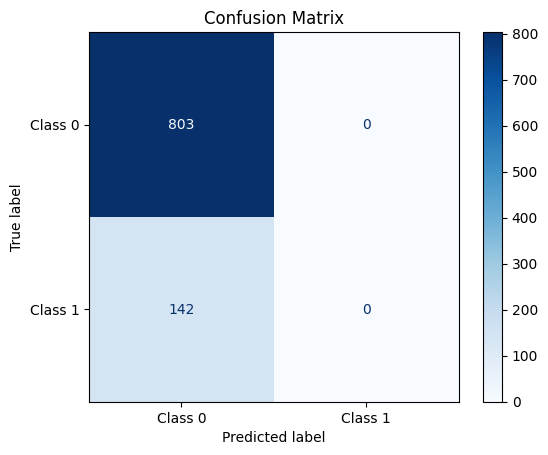

In [12]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
# 计算混淆矩阵
conf_matrix = confusion_matrix(all_labels, all_predictions)

# 绘制混淆矩阵
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=['Class 0', 'Class 1'])
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

In [13]:
# print(f'Epoch [{epoch + 1}/{EPOCH}], Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%')
torch.save(net.state_dict(), 'Simple Resnet_U model.pth')
print("Model saved to Simple Resnet_U model.pth")

Model saved to Simple Resnet_U model.pth


In [14]:
net.load_state_dict(torch.load('Simple Resnet_U model.pth'))
net.eval()  # 切换到评估模式
print("Model loaded from Simple Resnet_U model.pth")

Model loaded from Simple Resnet_U model.pth


/tmp/ipykernel_98/4242669969.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net.load_state_dict(torch.load('Simple Resnet_U model.pth'))


In [15]:
test_accuracies

[68.75,
 75.0,
 77.08333333333333,
 81.25,
 78.75,
 80.20833333333333,
 83.03571428571429,
 85.15625,
 84.02777777777777,
 82.5,
 82.95454545454545,
 83.33333333333333,
 83.65384615384616,
 83.03571428571429,
 82.91666666666667,
 83.984375,
 84.19117647058823,
 84.375,
 84.53947368421052,
 84.0625,
 83.63095238095238,
 83.80681818181819,
 84.51086956521739,
 84.63541666666667,
 85.0,
 85.33653846153847,
 85.64814814814815,
 85.9375,
 85.34482758620689,
 84.79166666666667,
 84.6774193548387,
 84.9609375,
 84.84848484848484,
 85.29411764705883,
 85.0,
 85.06944444444444,
 84.96621621621621,
 85.03289473684211,
 85.25641025641026,
 85.3125,
 85.36585365853658,
 85.41666666666667,
 85.61046511627907,
 85.36931818181819,
 85.27777777777777,
 85.32608695652173,
 85.50531914893617,
 85.28645833333333,
 84.56632653061224,
 84.625,
 84.43627450980392,
 84.61538461538461,
 84.66981132075472,
 84.72222222222223,
 84.88636363636364,
 84.82142857142857,
 84.75877192982456,
 84.91379310344827,
 84.9

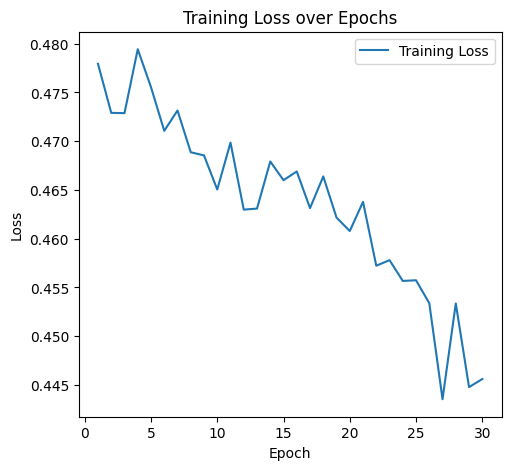

In [16]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(range(1, EPOCH + 1), train_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss over Epochs')
plt.legend()

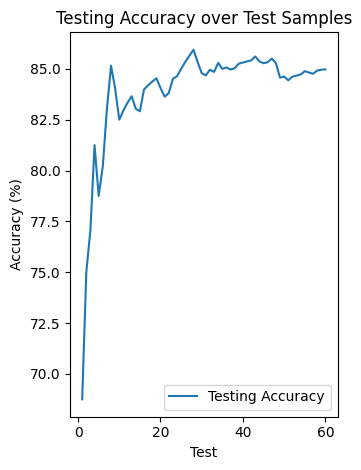

In [17]:
plt.subplot(1, 2, 2)
plt.plot(range(1, 61), test_accuracies, label='Testing Accuracy')
plt.xlabel('Test')
plt.ylabel('Accuracy (%)')
plt.title('Testing Accuracy over Test Samples')
plt.legend()

plt.tight_layout()
plt.show()

In [18]:
# image_dataset = TensorDataset(image_tensor, y)
# image_dataset_loader = DataLoader(image_dataset, batch_size=16, shuffle=True)

features = eva_data.drop(columns=['is_melanoma']).values  # 提取特征
labels = eva_data['is_melanoma'].values  # 提取标签（如果有）

image_tensor = torch.tensor(image_tensor) if not isinstance(image_tensor, torch.Tensor) else image_tensor
y = torch.tensor(y) if not isinstance(y, torch.Tensor) else y

# 创建 DataLoader，用于批量处理整个数据集
batch_size = 32  # 设置批量大小
eva_loader = DataLoader(TensorDataset(image_tensor, y), batch_size=batch_size, shuffle=False)

# 加载模型并切换到评估模式

net.load_state_dict(torch.load('Simple Resnet_U model.pth'))
net.eval()

# 将模型移动到正确的设备（如果尚未移动）
net.to(device)

# 存储预测结果
predicted_results = []

with torch.no_grad():
    for features_batch, _ in eva_loader:
        # 将输入张量移动到正确的设备（如果有GPU的话，移动到GPU）
        features_batch = features_batch.to(device)
        
        outputs = net(features_batch)  # 模型预测
        predicted = (outputs.view(-1) > 0.5).float()  # 二分类：转换为 0 或 1
        predicted_results.extend(predicted.cpu().numpy())  # 将预测结果保存到列表中

# 将预测结果添加到 DataFrame 中
eva_data['Predicted_Feature'] = predicted_results  # 将预测结果作为新特征添加到数据集中

# 打印更新后的 DataFrame
print(eva_data.head())


# 打印数据集以检查结果
print(eva_data.head())

/tmp/ipykernel_98/3150227344.py:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net.load_state_dict(torch.load('Simple Resnet_U model.pth'))


   age_approx  anatom_site_general  clin_size_long_diam_mm  sex  is_melanoma  \
0    0.913505                    0               -0.535270    0            1   
1   -0.889084                    0               -0.535270    0            0   
2   -0.889084                    2               -0.756603    0            0   
3   -0.588653                    0               -0.313937    1            0   
4   -0.288221                    4               -0.756603    0            0   

   Predicted_Feature  
0                0.0  
1                0.0  
2                0.0  
3                0.0  
4                0.0  
   age_approx  anatom_site_general  clin_size_long_diam_mm  sex  is_melanoma  \
0    0.913505                    0               -0.535270    0            1   
1   -0.889084                    0               -0.535270    0            0   
2   -0.889084                    2               -0.756603    0            0   
3   -0.588653                    0               -0.313937   

In [19]:
eva_data

,age_approx,anatom_site_general,clin_size_long_diam_mm,sex,is_melanoma,Predicted_Feature
0,0.913505,0,-0.535270,0,1,0.0
1,-0.889084,0,-0.535270,0,0,0.0
2,-0.889084,2,-0.756603,0,0,0.0
3,-0.588653,0,-0.313937,1,0,0.0
4,-0.288221,4,-0.756603,0,0,0.0
...,...,...,...,...,...,...
4719,0.613074,1,1.253099,0,1,0.0
4720,0.613074,0,0.104382,0,0,0.0
4721,-0.588653,0,1.485498,1,0,0.0
4722,-0.288221,3,0.150861,1,0,0.0


In [20]:
eva_data.to_csv('./Resnet18_data_U.csv', index=False)

In [21]:
%pip install catboost
%pip install xgboost
%pip install seaborn
import seaborn as sns
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [22]:
X = eva_data.drop(columns=['is_melanoma'])
y = eva_data['is_melanoma']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

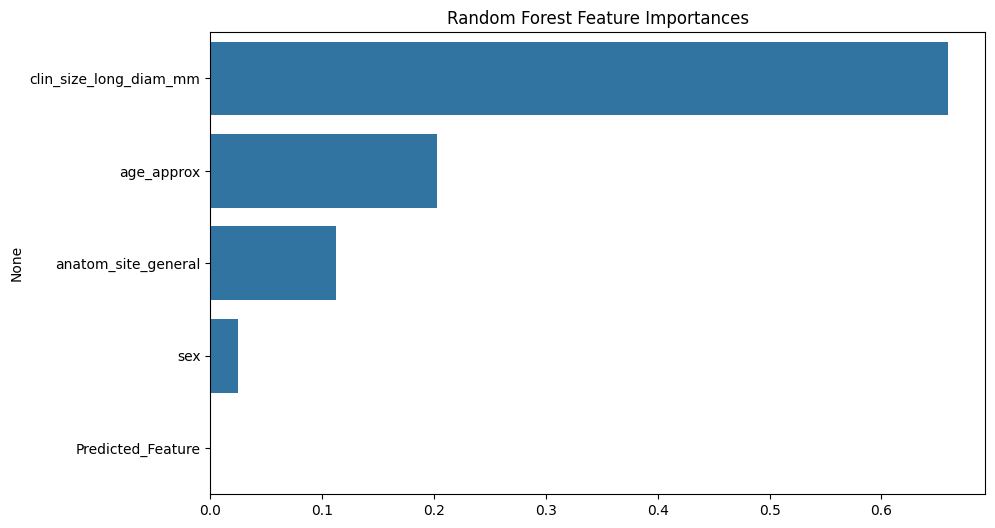

In [23]:
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

# 提取特征重要性
importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]
features = X.columns

# 可视化特征重要性
plt.figure(figsize=(10, 6))
sns.barplot(x=importances[indices], y=features[indices])
plt.title('Random Forest Feature Importances')
plt.show()


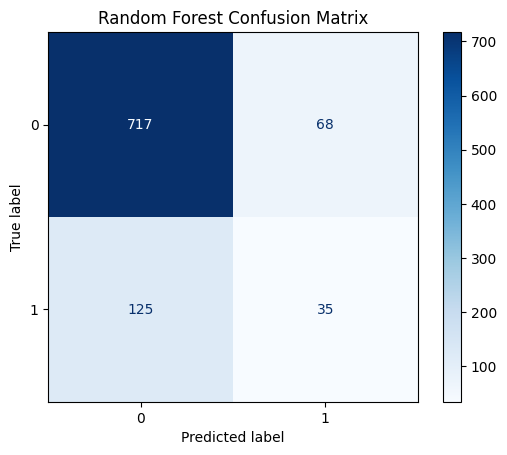

In [24]:
from sklearn.metrics import ConfusionMatrixDisplay

rf_preds = rf.predict(X_test)
cm = confusion_matrix(y_test, rf_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rf.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('Random Forest Confusion Matrix')
plt.show()


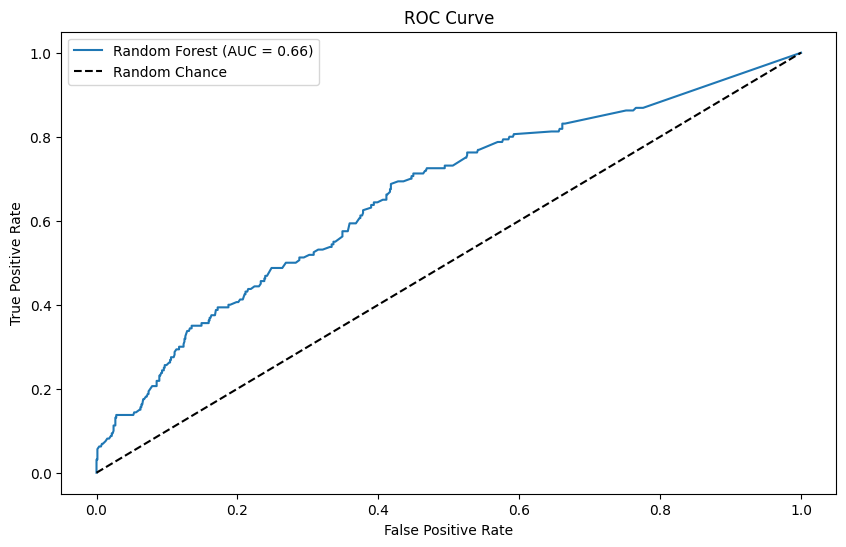

In [25]:
from sklearn.metrics import roc_curve, auc
rf_probs = rf.predict_proba(X_test)[:, 1]  # 获取概率
fpr, tpr, _ = roc_curve(y_test, rf_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, label=f'Random Forest (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Chance')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()


In [26]:
rf_preds = rf.predict(X_test)
print("Random Forest Accuracy:", accuracy_score(y_test, rf_preds))

Random Forest Accuracy: 0.7957671957671958


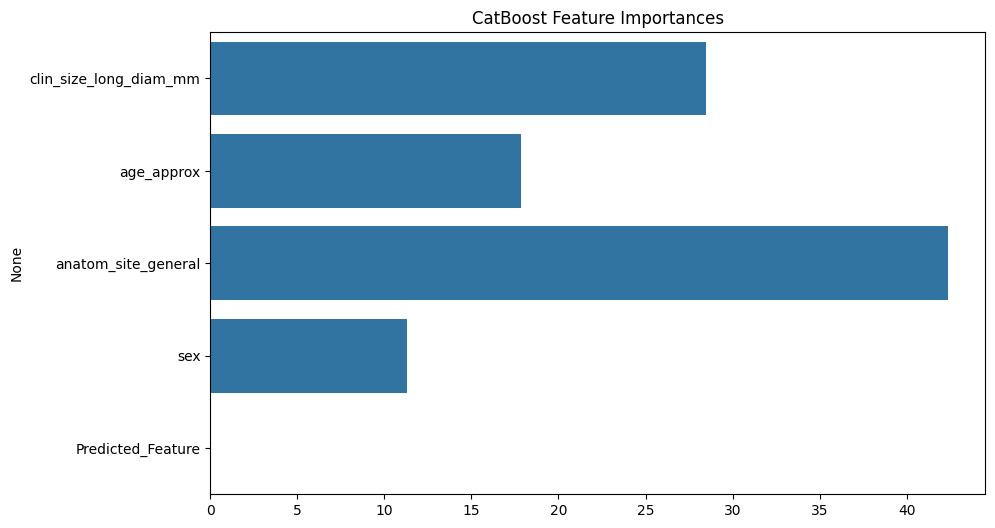

In [27]:
catboost = CatBoostClassifier(verbose=0, random_state=42)
catboost.fit(X_train, y_train)

# 提取特征重要性
cat_importances = catboost.feature_importances_

plt.figure(figsize=(10, 6))
sns.barplot(x=cat_importances, y=features[indices])
plt.title('CatBoost Feature Importances')
plt.show()


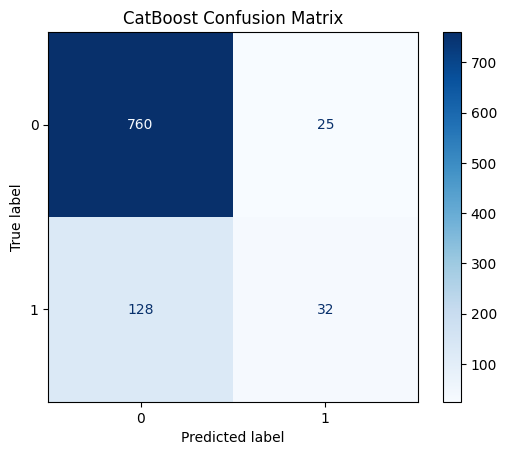

In [28]:
catboost_preds = catboost.predict(X_test)
cm = confusion_matrix(y_test, catboost_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=catboost.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('CatBoost Confusion Matrix')
plt.show()


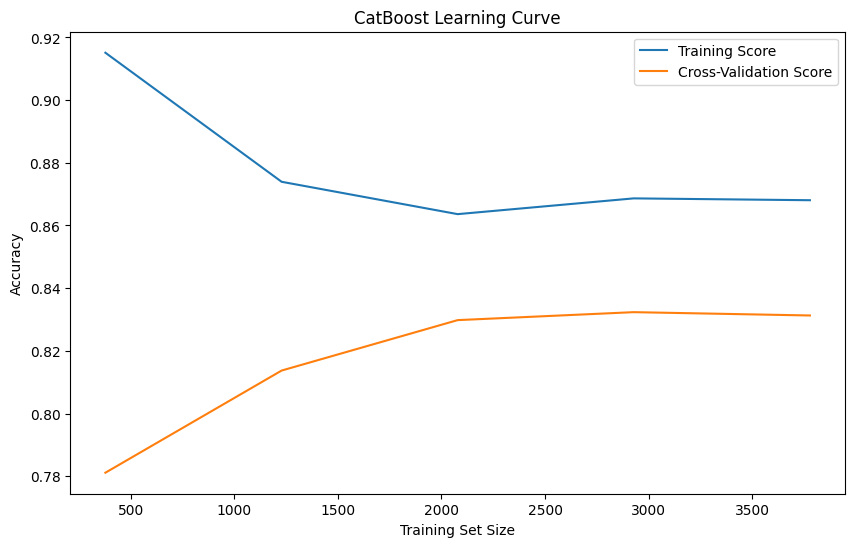

In [29]:
train_sizes, train_scores, test_scores = learning_curve(catboost, X, y, cv=5, scoring='accuracy')

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Training Score')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Cross-Validation Score')
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.title('CatBoost Learning Curve')
plt.legend()
plt.show()


In [30]:
catboost_preds = catboost.predict(X_test)
print("CatBoost Accuracy:", accuracy_score(y_test, catboost_preds))

CatBoost Accuracy: 0.8380952380952381


/opt/conda/lib/python3.11/site-packages/xgboost/core.py:158: UserWarning: [19:45:31] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


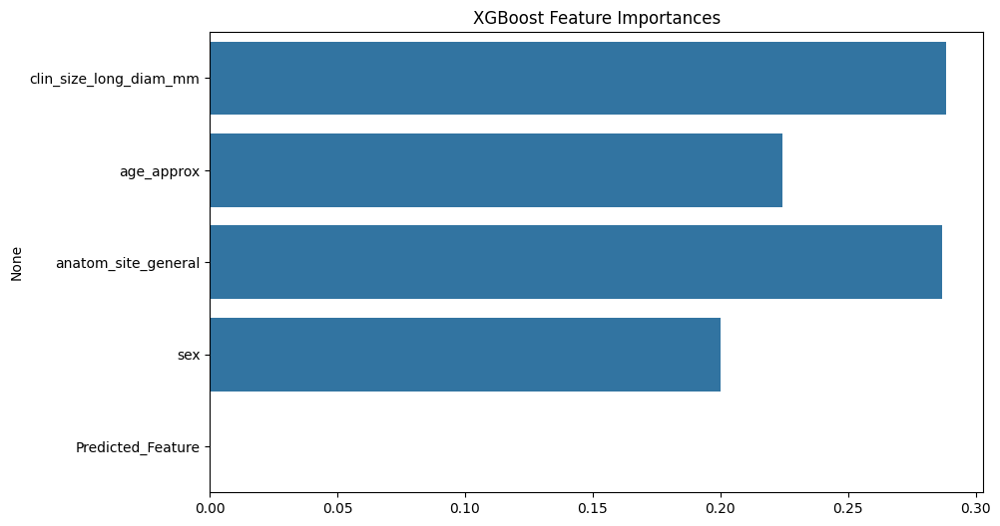

In [31]:
xgboost = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
xgboost.fit(X_train, y_train)

# 获取特征重要性
xgb_importances = xgboost.feature_importances_

plt.figure(figsize=(10, 6))
sns.barplot(x=xgb_importances, y=features[indices])
plt.title('XGBoost Feature Importances')
plt.show()


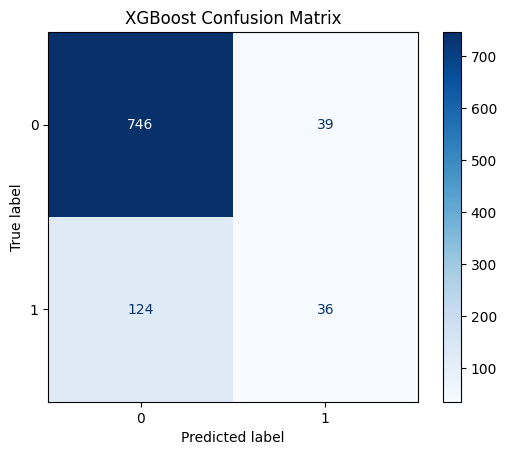

In [32]:
xgboost_preds = xgboost.predict(X_test)
cm = confusion_matrix(y_test, xgboost_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=xgboost.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('XGBoost Confusion Matrix')
plt.show()


In [33]:
xgboost_preds = xgboost.predict(X_test)
print("XGBoost Accuracy:", accuracy_score(y_test, xgboost_preds))

XGBoost Accuracy: 0.8275132275132275


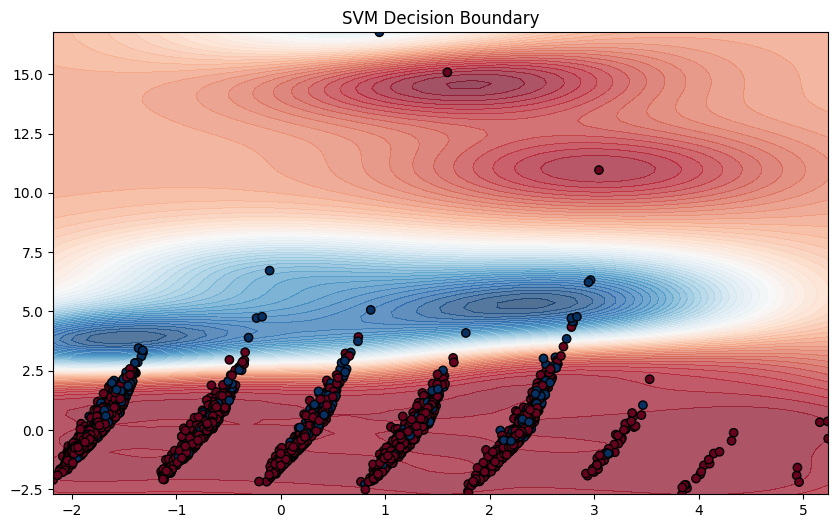

In [34]:
from sklearn.decomposition import PCA

# 使用 PCA 将特征降到 2 维
pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

svm = SVC(probability=True, random_state=42)
svm.fit(X_train_pca, y_train)

# 决策边界
xx, yy = np.meshgrid(np.linspace(X_train_pca[:, 0].min(), X_train_pca[:, 0].max(), 100),
                     np.linspace(X_train_pca[:, 1].min(), X_train_pca[:, 1].max(), 100))
Z = svm.decision_function(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)

plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, levels=50, cmap="RdBu", alpha=0.7)
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=y_train, edgecolors='k', cmap="RdBu")
plt.title('SVM Decision Boundary')
plt.show()


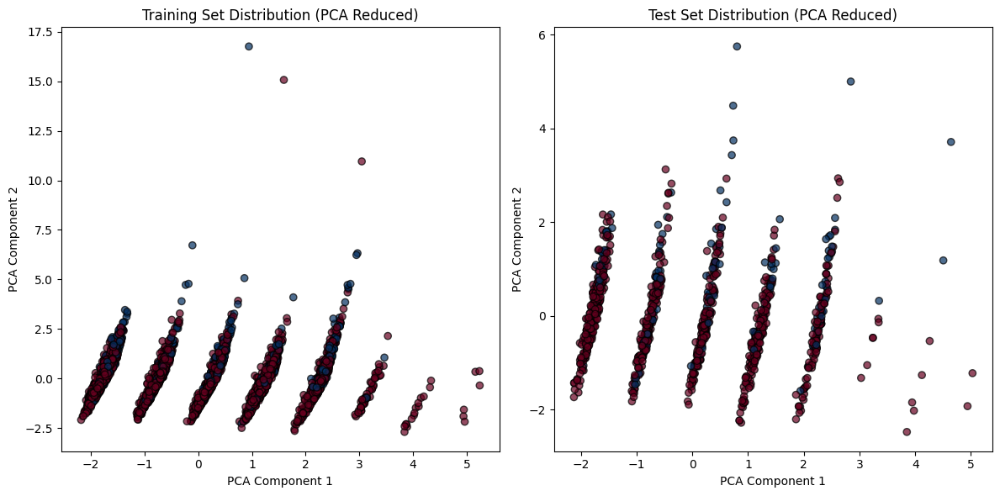

In [35]:
# 绘制训练集与测试集的分布
plt.figure(figsize=(12, 6))

# 训练集分布
plt.subplot(1, 2, 1)
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=y_train, cmap="RdBu", edgecolors='k', alpha=0.7)
plt.title("Training Set Distribution (PCA Reduced)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")

# 测试集分布
plt.subplot(1, 2, 2)
plt.scatter(X_test_pca[:, 0], X_test_pca[:, 1], c=y_test, cmap="RdBu", edgecolors='k', alpha=0.7)
plt.title("Test Set Distribution (PCA Reduced)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")

plt.tight_layout()
plt.show()


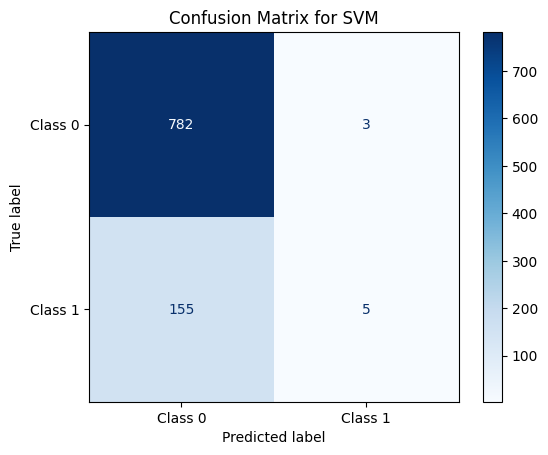

In [36]:
# 获取预测结果
y_pred = svm.predict(X_test_pca)

# 计算混淆矩阵
cm = confusion_matrix(y_test, y_pred)

# 创建混淆矩阵的可视化
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Class 0", "Class 1"])

# 绘制混淆矩阵
disp.plot(cmap=plt.cm.Blues, values_format='d')  # 使用蓝色调并显示为整数
plt.title('Confusion Matrix for SVM')
plt.show()

In [37]:
svm_preds = svm.predict(X_test_pca)
print("SVM Accuracy:", accuracy_score(y_test, svm_preds))

SVM Accuracy: 0.8328042328042328


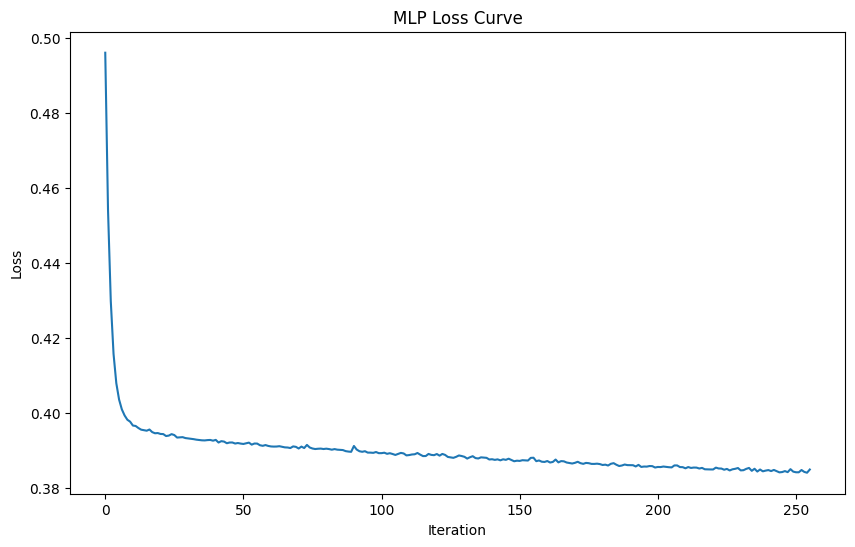

In [38]:
mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=42)
mlp.fit(X_train, y_train)

plt.figure(figsize=(10, 6))
plt.plot(mlp.loss_curve_)
plt.title('MLP Loss Curve')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()


In [39]:
mlp_preds = mlp.predict(X_test)
print("MLP Accuracy:", accuracy_score(y_test, mlp_preds))

MLP Accuracy: 0.8380952380952381


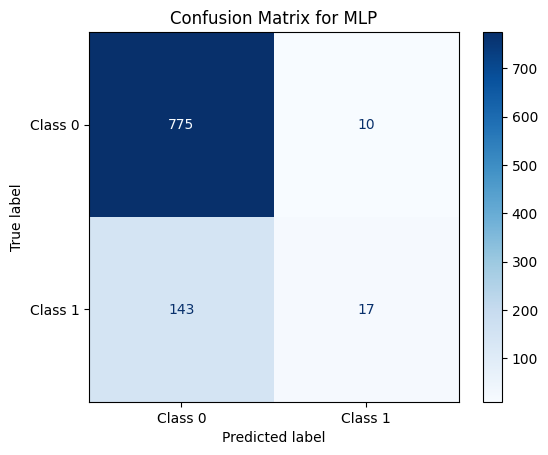

In [40]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# 获取预测结果
y_pred = mlp.predict(X_test)

# 计算混淆矩阵
cm = confusion_matrix(y_test, y_pred)

# 创建混淆矩阵的可视化
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Class 0", "Class 1"])

# 绘制混淆矩阵
disp.plot(cmap=plt.cm.Blues, values_format='d')  # 使用蓝色调并显示为整数
plt.title('Confusion Matrix for MLP')
plt.show()


/opt/conda/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/conda/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/conda/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/conda/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/conda/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptro

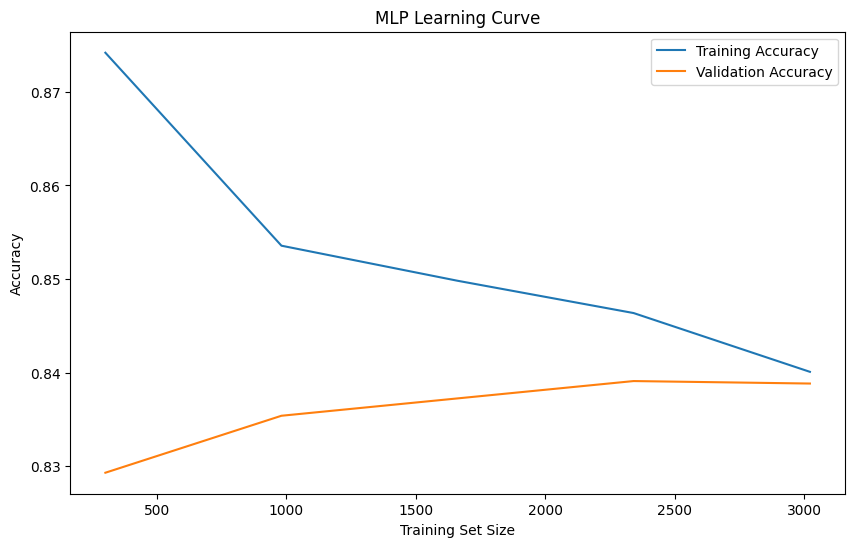

In [41]:
from sklearn.model_selection import learning_curve

# 获取学习曲线数据
train_sizes, train_scores, valid_scores = learning_curve(mlp, X_train, y_train, cv=5, scoring='accuracy', n_jobs=-1)

# 计算平均分数
train_mean = train_scores.mean(axis=1)
valid_mean = valid_scores.mean(axis=1)

# 绘制学习曲线
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, label='Training Accuracy')
plt.plot(train_sizes, valid_mean, label='Validation Accuracy')
plt.title('MLP Learning Curve')
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


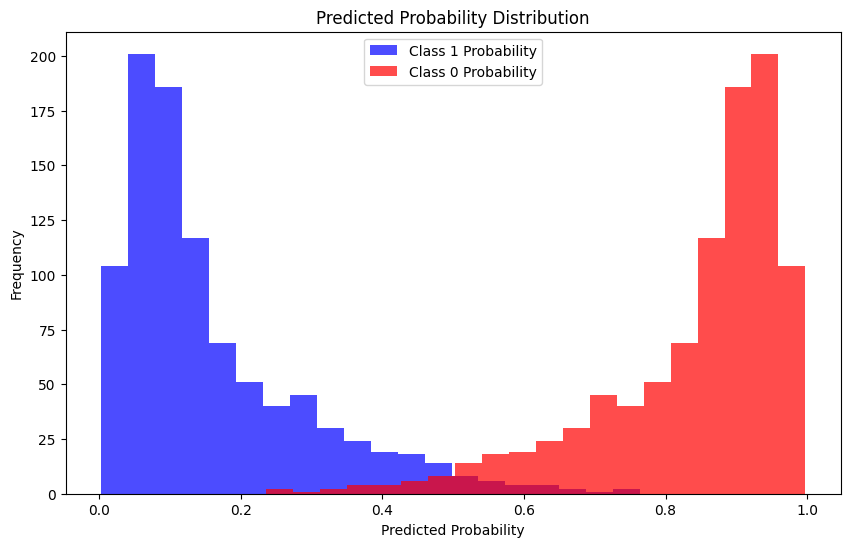

In [42]:
# 获取模型对测试集的预测概率
y_proba = mlp.predict_proba(X_test)

# 绘制预测概率的分布
plt.figure(figsize=(10, 6))
plt.hist(y_proba[:, 1], bins=20, alpha=0.7, color='blue', label='Class 1 Probability')
plt.hist(y_proba[:, 0], bins=20, alpha=0.7, color='red', label='Class 0 Probability')
plt.title('Predicted Probability Distribution')
plt.xlabel('Predicted Probability')
plt.ylabel('Frequency')
plt.legend()
plt.show()
